# Portfolio Performance & Risk Analysis 

## Table of Contents
- [1. Analysis of Portfolio Constituents](#section-1)
    * [1.1 Daily Returns](#subsection-11)
    * [1.2 Normalized Plot of Closing Prices](#subsection-12) 
    * [1.3 Histogram of Returns](#subsection-13) 
    * [1.4 Correlation Matrix](#subsection-14) 
    * [1.5 Normalized Plot of Cumulative Returns](#subsection-15)
    * [1.6 Box & Whisker Plot of Returns](#subsection-16) 
    * [1.7 Seasonal Pattern of Returns](#subsection-17)
    * [1.8 Dollar Triangle](#subsection-18) 
    * [1.9 Risk vs Return Trade-off](#subsection-19) 
    * [1.10 Wins vs Losses](#subsection-110)
    * [1.11 Statistical Attributes of Returns](#subsection-111) 
    * [1.12 What About Drawdowns and Downside Risk?](#subsection-112) 
    * [1.13 Tail Risk](#subsection-113) 
    * [1.14 Price Crash Risk](#subsection-114)   
    * [1.15 Liquidity Risk](#subsection-115)     
$$$$
- [2. Construction of Portfolios](#section-2)
    * [2.1 Price-Weighted Portfolio (Monthly Rebalancing)](#subsection-21)
    * [2.2 Equally-Weighted Portfolio](#subsection-22)
    * [2.3 Market-Value-Weighted Portfolio (Monthly Rebalancing)](#subsection-23)
    * [2.4 Inverse Volatility Portfolio (Monthly Rebalancing)](#subsection-24)
    * [2.5 Random-Weighted Portfolios](#subsection-25)
    * [2.6 Global Minimum (Annualized) Variance Portfolio](#subsection-26)
    * [2.7 Maximum (Annualized) Sharpe Portfolio](#subsection-27)
    * [2.8 Variance Minimization using Scipy](#subsection-28)
    * [2.9 Sharpe Maximization using Scipy](#subsection-29)
    * [2.10 Portfolio Comparison : Performance against Benchmark](#subsection-210)
$$$$
- [3. Putting It All Together](#section-3)
    * [3.1 Plotting the Efficient Frontier and the Capital Asset Line](#subsection-31)
    * [3.2 Impact and Magnitude of Diversification](#subsection-32)

## Objective 

This notebook is an introductory guide to understanding stock returns from a statistical perspective, with a focus on the different types of underlying risk. Traditional portfolio construction methods are implemented to show the time-tested effectiveness of diversification in optimizing risk-adjusted returns. Theoretical models for forecasting returns showcase the importance of capturing each asset's relationship with the market (from a linear standpoint).

## Importing the Necessary Libraries 

In [1]:
import pandas as pd 
import pandas_datareader.data as web
import numpy as np 
import yfinance as yf 
import matplotlib.pyplot as plt 
import seaborn as sns 
from scipy import optimize, stats  
from sklearn import linear_model, metrics 
from statsmodels import tools, regression 
from statsmodels.graphics import gofplots
from statsmodels.stats import stattools
from statsmodels.tsa.stattools import adfuller, kpss
from matplotlib import ticker 
np.random.seed(789)
# pd.set_option("display.max_rows", None)  
# pd.set_option("display.max_columns", None) 
pd.set_option("display.float_format", "{:.4f}".format)
import warnings
warnings.filterwarnings("ignore")

In [2]:
from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats("svg")

## Loading the Data (Compustat)

In [3]:
open_tech = pd.read_excel("C:/Users/khail/OneDrive/Desktop/Github Projects/Open.xlsx", parse_dates = ["Date"], index_col = "Date")

high_tech = pd.read_excel("C:/Users/khail/OneDrive/Desktop/Github Projects/High.xlsx", parse_dates = ["Date"], index_col = "Date")

low_tech = pd.read_excel("C:/Users/khail/OneDrive/Desktop/Github Projects/Low.xlsx", parse_dates = ["Date"], index_col = "Date")

close_tech = pd.read_excel("C:/Users/khail/OneDrive/Desktop/Github Projects/Close.xlsx", parse_dates = ["Date"], index_col = "Date")

adj_close_tech = pd.read_excel("C:/Users/khail/OneDrive/Desktop/Github Projects/Adj Close.xlsx", parse_dates = ["Date"], index_col = "Date")

shares_outstd_tech = pd.read_excel("C:/Users/khail/OneDrive/Desktop/Github Projects/Shares Outstanding.xlsx", parse_dates = ["Date"], index_col = "Date")

In [4]:
rf_rate = 0.03
start_date = "2019-12-31"
end_date = "2024-01-01" 
tickers = close_tech.columns.tolist( )

## Key Assumptions 

- **Long-only, stocks-only portfolio for long-term investing**
> No short positions are allowed, and all positions are held for at least a month. Portfolios are constructed and rebalanced based on traditional allocation methods, and do not incorporate fundamental analysis, technical analysis, or machine learning. 

- **US-based tech-only portfolio**
> Our universe is restricted to the technology sector. As such, calculations for the sector allocation effect (picking the right sectors) and stock selection effect (picking the right stocks in each sector) to explain under or over performance relative to a benchmark are not meaningful. 

- **Execution of portfolio rebalancing orders at the closing price of each month's first day (market order)**
> In reality, a large block order is broken down into smaller limit orders executed at different offer prices throughout the day. Other order types can be used, such as Immediate or Cancel, All or None, Fill or Kill, pegged, or reserve orders.

- **Absence of trading costs & rebates**
> Commissions and rebates are not taken into account. Calculations of effective cost and realized cost require the execution price and the Bid-Ask midpoint at the time of each smaller order. Without these, net returns cannot be computed.

- **Absence of dividends**
> The compounding effect of reinvesting dividends is not taken into account. Without this, total returns cannot be computed. 

- **Use of arithmetic mean return**
> Though less used, geometric mean return is more accurate by taking into account serial correlation and period over period compounding.

## 1. Analysis of Portfolio Constituents 
<a id="section-1"></a>

### 1.1 Daily Returns
<a id="subsection-11"></a>

$$
\text{Daily Return}_{t} = \frac{\text{Close Price}_{t} - \text{Close Price}_{t-1}}{\text{Close Price}_{t-1}}
$$

In [5]:
returns = adj_close_tech.pct_change(periods = 1).iloc[1:] 

In [6]:
returns

,AAPL,AMD,AMZN,AVGO,GOOGL,INTC,META,MSFT,NFLX,NVDA,QCOM,TSLA
Date,,,,,,,,,,,,
2020-01-02,0.0228,0.0706,0.0272,0.0202,0.0219,0.0165,0.0221,0.0185,0.0193,0.0196,0.0052,0.0285
2020-01-03,-0.0097,-0.0102,-0.0121,-0.0254,-0.0052,-0.0122,-0.0053,-0.0125,-0.0119,-0.0160,-0.0188,0.0296
2020-01-06,0.0080,-0.0043,0.0149,-0.0015,0.0267,-0.0028,0.0188,0.0026,0.0305,0.0042,-0.0059,0.0193
2020-01-07,-0.0047,-0.0029,0.0021,-0.0034,-0.0019,-0.0167,0.0022,-0.0091,-0.0151,0.0121,0.0284,0.0388
2020-01-08,0.0161,-0.0087,-0.0078,-0.0125,0.0071,0.0007,0.0101,0.0159,0.0257,0.0019,-0.0029,0.0492
...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,-0.0055,-0.0022,-0.0027,-0.0047,0.0076,0.0195,-0.0020,0.0028,-0.0099,-0.0033,0.0074,-0.0077
2023-12-26,-0.0028,0.0273,-0.0001,0.0088,0.0002,0.0521,0.0041,0.0002,0.0091,0.0092,0.0137,0.0161
2023-12-27,0.0005,0.0185,-0.0005,-0.0051,-0.0081,0.0051,0.0085,-0.0016,0.0012,0.0028,0.0018,0.0188


### 1.2 Normalized Plot of Closing Prices
<a id="subsection-12"></a>

$$
\text{Normalized Close Price}_{t} = \frac{\text{Close Price}_{t}}{\text{Close Price}_{0}} \times 100
$$ 

In [7]:
adj_close_tech = adj_close_tech.iloc[1:]
norm_close_tech = adj_close_tech.div(adj_close_tech.iloc[0]).mul(100)

In [8]:
def plot_normalized_close(norm_close_df, freq = None) :
    """
    Arguments :
    - norm_close_df : DataFrame of normalized closing prices 
    - freq (optional) : str for resampling frequency -> weekly or monthly or quarterly or annual 

    Returns :
    - None 
    
    Function :
    - Draws a line plot of normalized closing prices for each asset
    """
    if freq : 
        resampling = {"weekly" : "W-Fri", "monthly" : "BM", "quarterly" : "BQ", "annual" : "A"} 
        norm_close_df = norm_close_df.resample(resampling[freq]).last( )
    
    plt.figure(figsize = (12, 7))
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    
    assets = norm_close_df.columns
    for i, asset in enumerate(assets) :
        plt.plot(norm_close_df[asset], c = colors[i], label = asset)
    
    plt.xlabel(xlabel = "")
    plt.ylabel(ylabel = "Normalized Close ($)", fontsize = 12)
    plt.legend(loc = "best")
    plt.style.use("default") 
    plt.show( )   

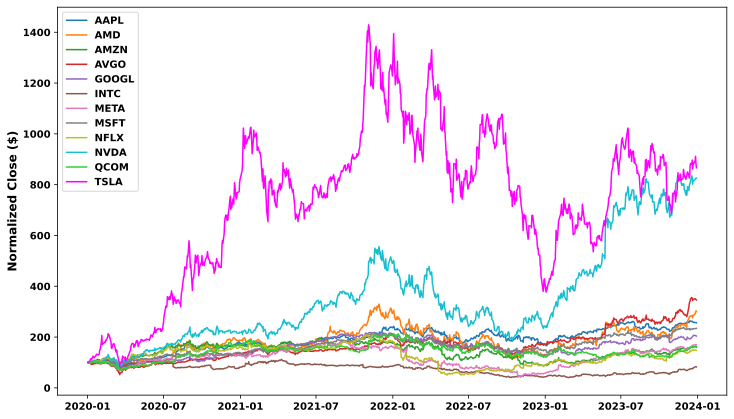

In [9]:
plot_normalized_close(norm_close_tech)

### 1.3 Histogram of Returns
<a id="subsection-13"></a>

In [10]:
def plot_histogram(returns_df) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 

    Returns :
    - None 
    
    Function :
    - Draws a histogram and a kernel density estimation plot of daily returns for each asset 
    - Highlights the minimum return, average return, and maximum return with dotted vertical lines 
    """
    assets = returns_df.columns
    n_assets = len(returns_df.columns)

    if n_assets % 2 != 0 :
        n_rows = int(n_assets / 2) + 1
    else :
        n_rows = int(n_assets / 2)
    
    fig, ax = plt.subplots(n_rows, 2, figsize = (12, n_rows * 5))
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]

    for i in range(n_rows) :
        for j in range(2) :
            if i + i + j <= n_assets - 1 :
                asset = assets[i + i + j]
                min_ret = returns_df[asset].min( ) * 100
                mean_ret = returns_df[asset].mean( ) * 100
                max_ret = returns_df[asset].max( ) * 100
            
                ax[i , j].hist(x = returns_df[asset] * 100, bins = 50, density = True, 
                               color = colors[i + i + j], alpha = 0.7, label = asset)
                sns.kdeplot(returns_df[asset] * 100, ax = ax[i , j], color = "black")
                ax[i , j].axvline(x = min_ret, color = "red", linestyle = "--", label = f"{round(min_ret, 2)}")
                ax[i , j].axvline(x = mean_ret, color = "gold", linestyle = "--", label = f"{round(mean_ret, 2)}")
                ax[i , j].axvline(x = max_ret, color = "green", linestyle = "--", label = f"{round(max_ret, 2)}")
                
                ax[i , j].set_xlabel(xlabel = "Daily Return (%)", fontsize = 12)
                if (i + i + j) % 2 == 0 :
                    ax[i , j].set_ylabel("Density", fontsize = 12)
                else :
                    ax[i , j].set_ylabel("")
                ax[i , j].legend(fontsize = 10)
                
    plt.style.use("default") 
    plt.show( )   

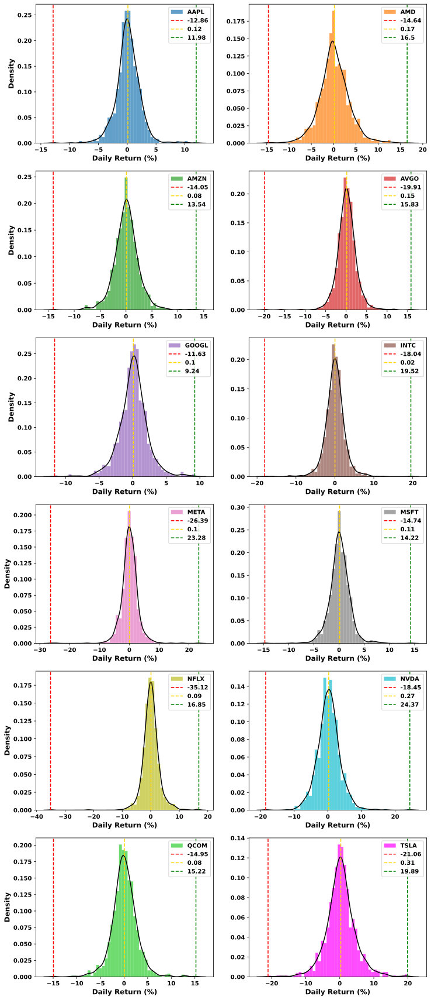

In [11]:
plot_histogram(returns[tickers])

### 1.4 Correlation Matrix
<a id="subsection-14"></a>

$$
\text{r}_{X, Y} = \frac{\sum_{t=1}^{T} (\text{Return}_{X,t} - \bar{\text{Return}_X}) \cdot (\text{Return}_{Y,t} - \bar{\text{Return}_Y})}{\sqrt{\sum_{t=1}^{T} (\text{Return}_{X,t} - \bar{\text{Return}_X})^2 \cdot \sum_{t=1}^{T} (\text{Return}_{Y,t} - \bar{\text{Return}_Y})^2}}
$$ 

In [12]:
def plot_corr_heatmap(returns_df, method = "pearson") :
    """
    Arguments :
    - returns_df : DataFrame of daily returns
    - method : str for the method for computing correlation -> pearson or spearman or kendall

    Returns :
    - None 
    
    Function :
    - Computes the correlation matrix using the specified method 
    - Removes repetitive correlation coefficients between the assets
    - Applies a green colormap to display the strength of correlation 
    """
    corr_mat = returns_df.corr(method = method) 
    n_assets = len(corr_mat.columns)
    
    for i in range(n_assets - 1) :
        corr_mat.iloc[i , i + 1 :] = np.nan 
    
    plt.figure(figsize = (n_assets, n_assets))
    sns.heatmap(corr_mat, annot = True, square = True, vmin = 0.55, vmax = 0.85, cmap = "Greens", cbar = False, fmt = ".4f")
    sns.set_theme(font_scale = 1) 
    
    plt.xlabel(xlabel = "")
    plt.ylabel(ylabel = "")
    plt.style.use("default") 
    plt.show( )   

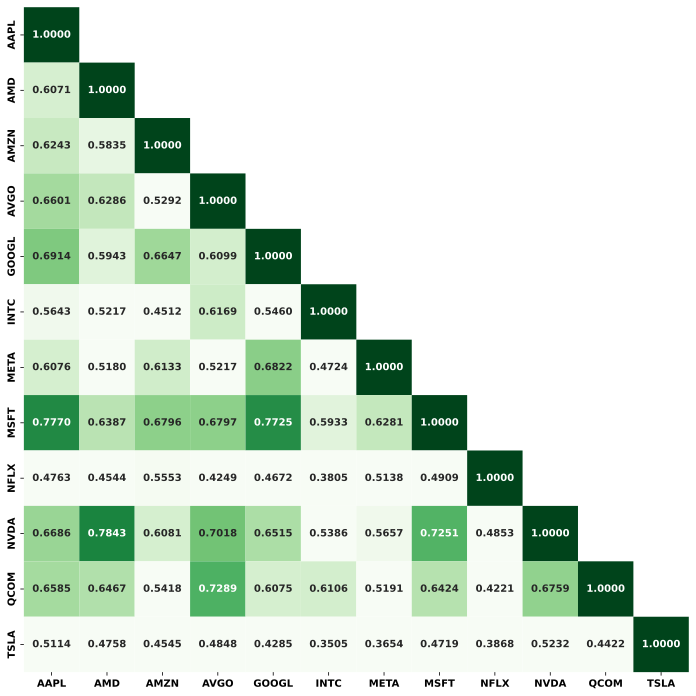

In [13]:
plot_corr_heatmap(returns[tickers])

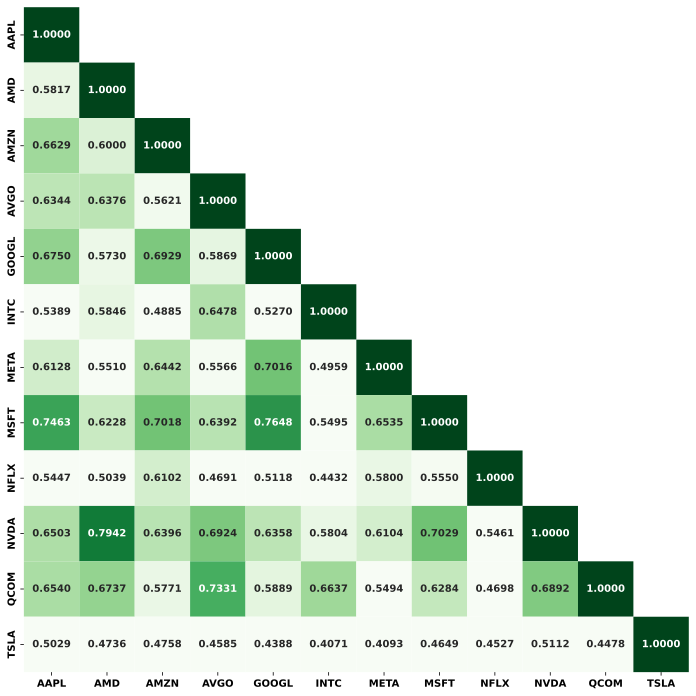

In [14]:
plot_corr_heatmap(returns[tickers], method = "spearman")

### 1.5 Normalized Plot of Cumulative Returns 
<a id="subsection-15"></a>

$$ 
\text{Cumulative Return}_{T} = \left( \prod_{t=1}^{T} 1 + \text{Return}_{t} \right) - 1
$$

In [15]:
cum_returns_stocks = (1 + returns[tickers]).cumprod( ) - 1 

In [16]:
def plot_cum_returns(returns_df) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 

    Returns :
    - None 
        
    Function :
    - Draws a line plot of cumulative daily returns for each asset 
    """
    cum_returns_df = (1 + returns_df).cumprod( ) - 1 
    assets = returns_df.columns
    
    plt.figure(figsize = (12, 7))
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    
    for i, asset in enumerate(assets) :
        plt.plot(cum_returns_df[asset].mul(100), c = colors[i], label = asset)
    
    plt.xlabel(xlabel = "")
    plt.ylabel(ylabel = "Cumulative Returns (%)", fontsize = 12)
    plt.legend(loc = "best")
    plt.style.use("default")
    plt.show( )  

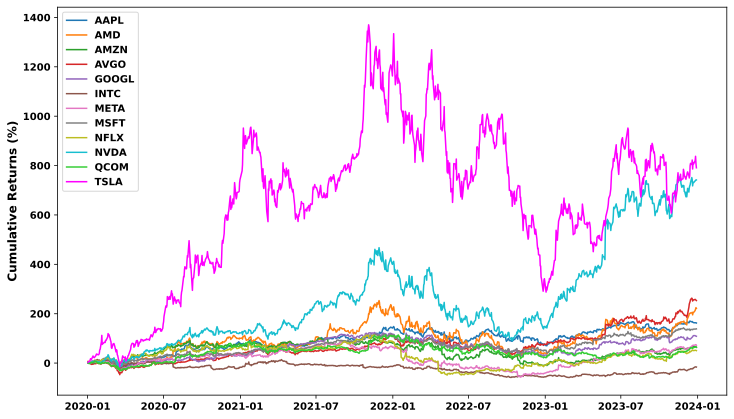

In [17]:
plot_cum_returns(returns[tickers]) 

### 1.6 Box & Whisker Plot of Returns 
<a id="subsection-16"></a>

$$ 
\text{Maximum} = \text{Q3} + 1.5 \times (\text{Q3} - \text{Q1}) 
$$ 

$$
\text{Q3} = \frac{4 \times (\text{N}+1)}{4}\text{-th ordered value}
$$ 

$$
\text{Median} = \frac{(\text{N}+1)}{2}\text{-th ordered value} 
$$

$$
\text{Q1} = \frac{(\text{N}+1)}{4}\text{-th ordered value}
$$ 

$$
\text{Minimum} = \text{Q1} - 1.5 \times (\text{Q3} - \text{Q1})
$$ 

In [18]:
def plot_box_whisker(returns_df, freq = None) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    - freq (optional) : str for resampling frequency -> weekly or monthly or quarterly or annual 

    Returns :
    - None 
        
    Function :
    - Resamples daily returns to the specified resampling frequency (if specified)
    - Draws a box & whisker plot of returns for each asset 
    - Plots outlier values of returns for each asset
    """
    if freq : 
        resampling = {"weekly" : "W-Fri", "monthly" : "BM", "quarterly" : "BQ", "annual" : "A"} 
        returns_df = returns_df.resample(resampling[freq]).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1) 
    
    assets = returns_df.columns
    n_assets = len(assets)  
        
    plt.figure(figsize = (12, n_assets))
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    
    for i, asset in enumerate(assets) :
        box = plt.boxplot(returns_df[asset] * 100, positions = [i], widths = 0.5, vert = False, patch_artist = True)
        plt.yticks(ticks = range(n_assets), labels = assets)
            
        for patch in box["boxes"] :
            patch.set_facecolor(colors[i])
            patch.set_alpha(0.7)
        for median in box["medians"] :
            median.set_color("black")
            
        if freq :
            plt.xlabel(xlabel = f"{freq.title( )} Return (%)", fontsize = 12)
        else :
            plt.xlabel(xlabel = "Daily Return (%)", fontsize = 12)
    
    plt.style.use("default")
    plt.show( )

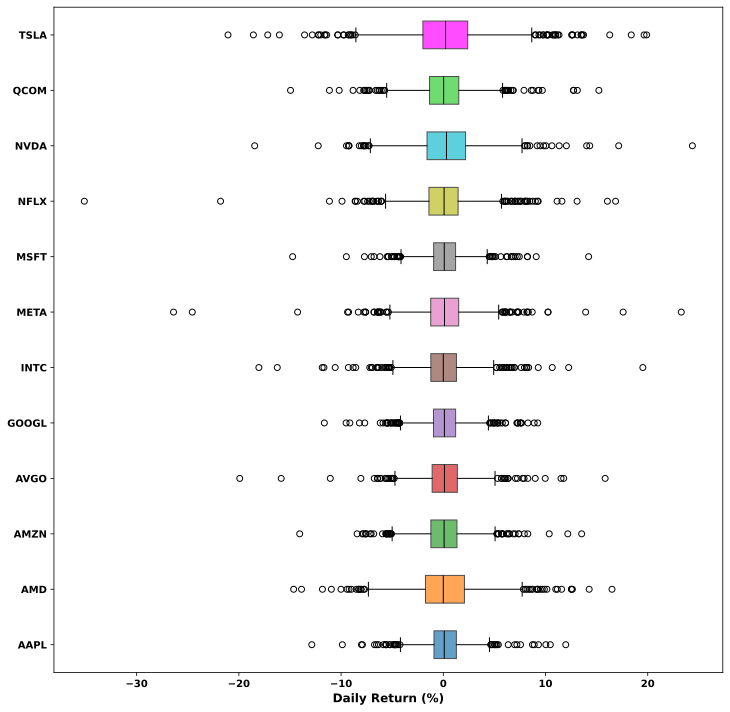

In [19]:
plot_box_whisker(returns[tickers])

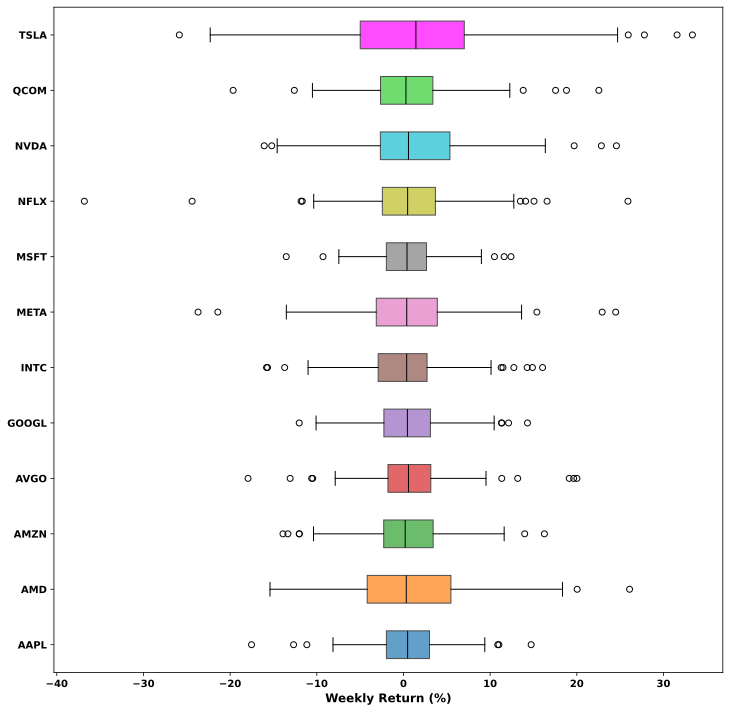

In [20]:
plot_box_whisker(returns[tickers], "weekly")

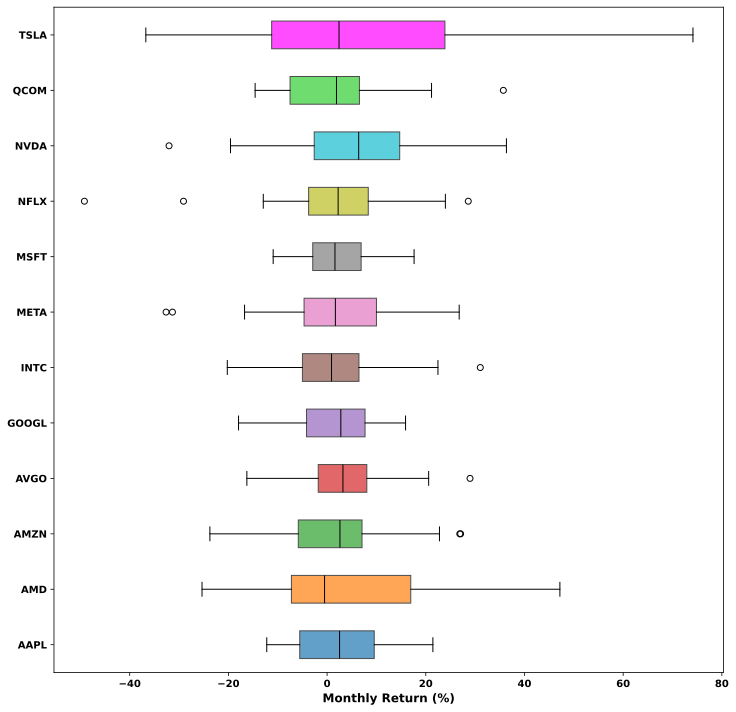

In [21]:
plot_box_whisker(returns[tickers], "monthly")

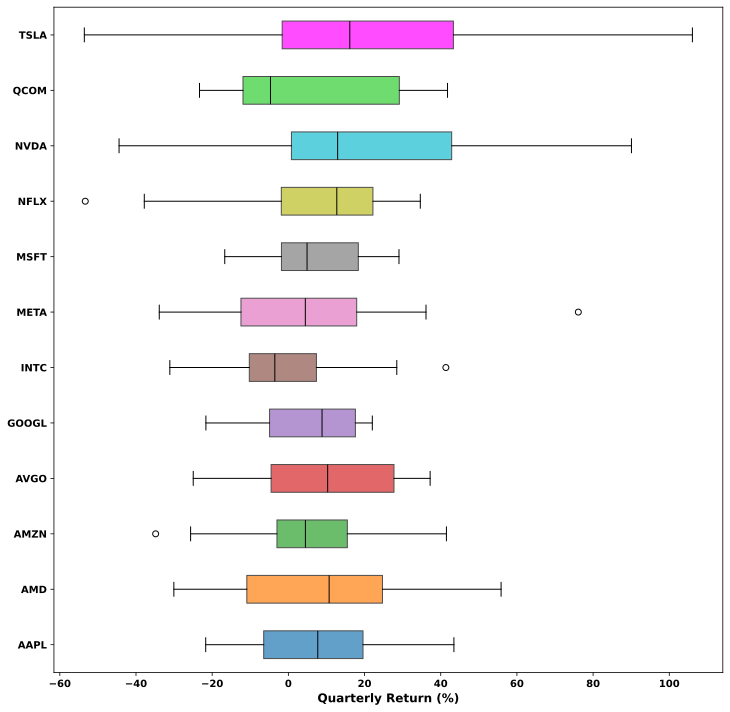

In [22]:
plot_box_whisker(returns[tickers], "quarterly")

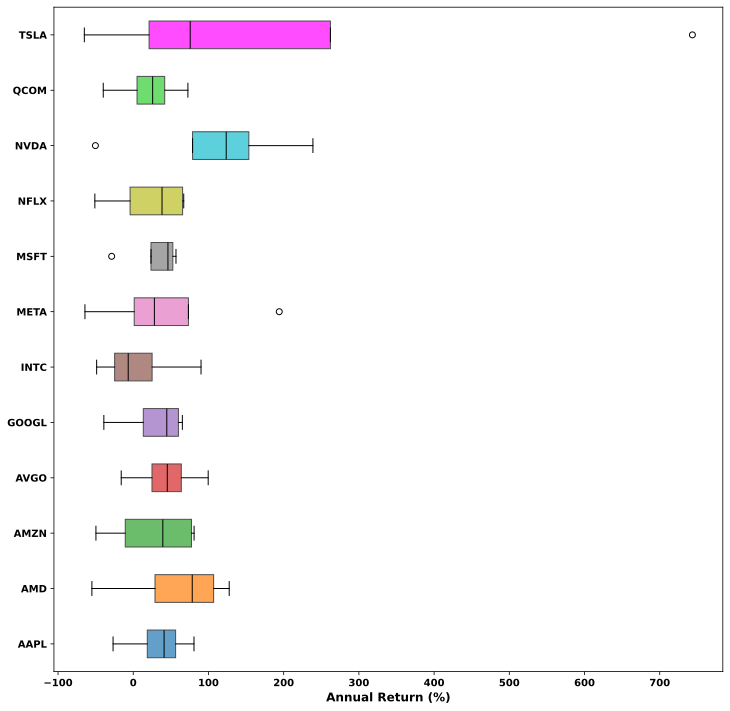

In [23]:
plot_box_whisker(returns[tickers], "annual")

### 1.7 Seasonal Pattern of Returns
<a id="subsection-17"></a>

In [24]:
def plot_seasonal_return(returns_df, freq = None):
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    - freq (optional) : str for resampling frequency -> weekly or monthly 

    Returns :
    - None 
        
    Function :
    - Resamples daily returns to the specified resampling frequency (if specified)
    - Plots a bar chart showing the average return in each month of the year for each asset
    """
    if freq :
        resampling = {"weekly" : "W-Fri", "monthly" : "BM"} 
        returns_df = returns_df.resample(resampling[freq]).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)   
    
    returns_df["Month"] = returns_df.index.month
    monthly_avg_return = returns_df.groupby("Month").mean( )
    returns_df.drop(columns = ["Month"], inplace = True)
    
    month_mapper = {1 : "Jan", 2 : "Feb", 3 : "Mar", 4 : "Apr", 
                    5 : 'May', 6: "Jun", 7 : "Jul", 8 : "Aug", 
                    9 : "Sept", 10 : "Oct", 11 : "Nov", 12 : "Dec"}
    monthly_avg_return.index = monthly_avg_return.index.map(month_mapper)
    
    assets = returns_df.columns
    n_assets = len(assets)
    
    fig, ax = plt.subplots(figsize = (12, n_assets * 7), nrows = n_assets, ncols = 1)
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    
    for i, asset in enumerate(assets) :  
        ax[i].bar(monthly_avg_return.index, monthly_avg_return[asset] * 100, 
                  width = 0.3, color = colors[i], alpha = 0.7, label = asset)
        
        if freq :
            ax[i].set_ylabel(f"Average {freq.title( )} Return (%)", fontsize = 12)
        else :
            ax[i].set_ylabel("Average Daily Return (%)", fontsize = 12)
        ax[i].legend( )
    
    plt.style.use("default")
    plt.show( )

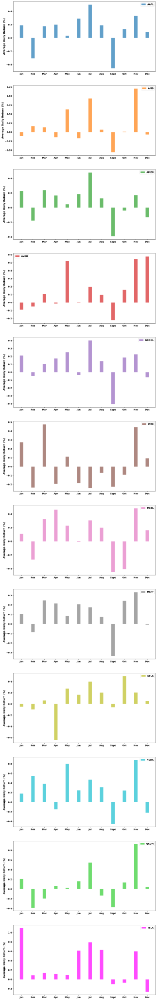

In [25]:
plot_seasonal_return(returns[tickers])

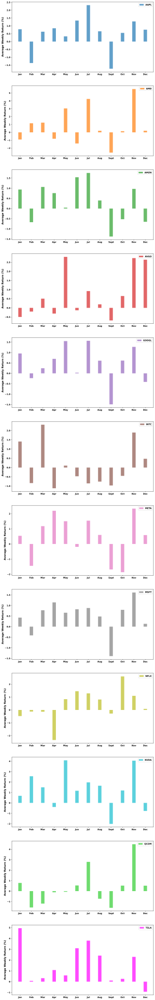

In [26]:
plot_seasonal_return(returns[tickers], freq = "weekly")

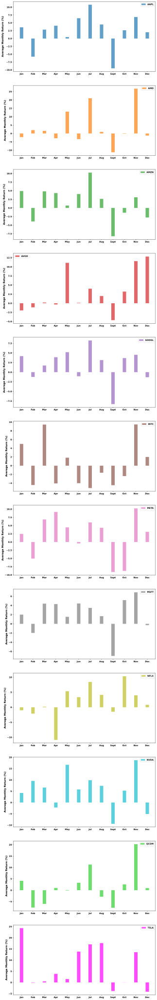

In [27]:
plot_seasonal_return(returns[tickers], freq = "monthly")

### 1.8 Dollar Triangle 
<a id="subsection-18"></a>

In [28]:
def dollar_triangle(returns_df, initial_balance) : 
    """
    Arguments :
    - returns_df : DataFrame of daily returns for a particular asset  
    - initial_balance : int representing the initial investment in the asset 
    
    Returns :
    - dollar_triangle_df 
    
    Function :
    - Resamples daily returns to annual frequency, and converts to annual log returns 
    - Computes the dollar value of the initial balance invested in the asset at the beginning of the year and held for n years 
    """
    ann_returns = returns_df.resample("A", kind = "period").agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1).to_frame( )
    ann_log_returns_df = np.log(ann_returns + 1).dropna( )
    
    max_years = ann_log_returns_df.index.size
    windows = list(range(max_years, 0, - 1)) 
    
    for n_years in windows :  
        ann_log_returns_df[f"{n_years} Y"] = np.exp(n_years * ann_log_returns_df.iloc[: , 0].rolling(n_years).mean( ))

    dollar_triangle_df = ann_log_returns_df.drop(columns = ann_log_returns_df.columns[0])
    dollar_triangle_df = dollar_triangle_df.mul(initial_balance)  
    return dollar_triangle_df 

In [29]:
def plot_dollar_triangle(returns_df, initial_balance = 1_000_000) :  
    """
    Arguments :
    - returns_df : DataFrame of daily returns for a particular asset  
    - initial_balance : int representing the initial investment in the asset (1_000_000 by default)
    
    Returns :
    - None 
    
    Function :
    - Computes the dollar triangle for each asset 
    - Applies a green colormap to compare dollar values over time   
    """
    assets = returns_df.columns
    n_assets = len(assets)

    if n_assets % 2 != 0 :
        n_rows = int(n_assets / 2) + 1
    else :
        n_rows = int(n_assets / 2)
    
    fig, ax = plt.subplots(n_rows, 2, figsize = (12, n_rows * 5))

    for i in range(n_rows) :
        for j in range(2) :
            if i + i + j <= n_assets - 1 :
                asset = assets[i + i + j]
                ticker_dollar_triangle = dollar_triangle(returns_df[asset], initial_balance = initial_balance)
            
                sns.heatmap(data = ticker_dollar_triangle.T, annot = True, square = True, 
                            fmt = ".0f", cmap = "Greens", cbar = False, ax = ax[i , j])
            
                ax[i , j].tick_params(axis = "y", left = False, labelleft = False, labelright = True)
                ax[i , j].set_xlabel(xlabel = "Year End", fontsize = 12)
                ax[i , j].set_ylabel(ylabel = f"Holding Period in {asset}", fontsize = 12, 
                                     rotation = 90, va = "center", labelpad = - 270)
    
    plt.style.use("default") 
    plt.show( )   

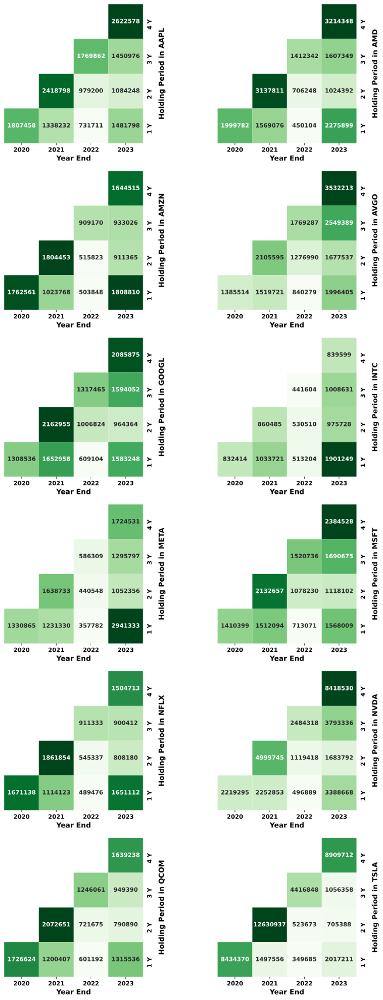

In [30]:
plot_dollar_triangle(returns[tickers])

### 1.9 Risk vs Return Trade-off 
<a id="subsection-19"></a>

**Number of Trading Days** :
- Weekly : 5
- Monthly : 21
- Quarterly : 63
- Annual : 252

$$
\bar{\text{Return}}_{Frequency} = \frac{1}{T} \left( \sum_{t=1}^{T} \text{Return}_{t} \right) \times \text{Number of Trading Days}_{Frequency}  
$$ 

$$
\sigma_{Frequency} = \sqrt{\frac{1}{T}\sum_{t=1}^{T}(\text{Return}_{t} - \bar{\text{Return}})^2} \times \sqrt{\text{Number of Trading Days}_{Frequency}} 
$$ 

$$
\text{Sharpe Ratio}_{Frequency} = \frac{\bar{\text{Return}}_{Frequency}}{\sigma_{Frequency}}
$$ 

In [31]:
def risk_return(returns_df) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - summary_df : DataFrame displaying the average return, standard deviation, and sharpe ratio for each resampling frequency
    
    Function :
    - Computes the average daily return and average daily standard deviation
    - Converts the average daily return and average daily standard deviation to weekly, monthly, quarterly, and annual frequency 
    """      
    summary_df = returns_df.agg(["mean" , "std"]).transpose( )
    summary_df.columns = ["Daily Return" , "Daily Volatility"] 
    summary_df["Daily Sharpe"] = (summary_df["Daily Return"]).div(summary_df["Daily Volatility"]) 
    
    n_trading_days = {"weekly" : 5, "monthly" : 21, "quarterly" : 63, "annual" : 252}
    for freq in n_trading_days.keys( ) :
        
        summary_df[f"{freq.title( )} Return"] = summary_df["Daily Return"] * n_trading_days[freq] 
        summary_df[f"{freq.title( )} Volatility"] =  summary_df["Daily Volatility"] * np.sqrt(n_trading_days[freq])  
        summary_df[f"{freq.title( )} Sharpe"] = (summary_df[f"{freq.title( )} Return"]).div(summary_df[f"{freq.title( )} Volatility"])
        
    summary_df.columns = pd.MultiIndex.from_product([["Daily", "Weekly", "Monthly", "Quarterly", "Annual"],
                                                     ["Return", "Volatility", "Sharpe"]])
    return summary_df 

In [32]:
summary_stocks = risk_return(returns[tickers])

In [33]:
summary_stocks#.style\
              #.highlight_max(color = "lightgreen")\
              #.highlight_min(color = "lightcoral")

Daily                   Weekly                   Monthly             \
      Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
AAPL  0.0012     0.0211 0.0559 0.0059     0.0473 0.1250  0.0248     0.0969   
AMD   0.0017     0.0338 0.0512 0.0086     0.0755 0.1144  0.0363     0.1548   
AMZN  0.0008     0.0237 0.0327 0.0039     0.0531 0.0731  0.0163     0.1088   
AVGO  0.0015     0.0242 0.0641 0.0077     0.0540 0.1434  0.0325     0.1107   
GOOGL 0.0010     0.0211 0.0452 0.0048     0.0472 0.1010  0.0200     0.0968   
INTC  0.0002     0.0260 0.0064 0.0008     0.0581 0.0143  0.0035     0.1191   
META  0.0010     0.0295 0.0334 0.0049     0.0659 0.0747  0.0207     0.1350   
MSFT  0.0011     0.0206 0.0523 0.0054     0.0460 0.1170  0.0226     0.0942   
NFLX  0.0009     0.0307 0.0292 0.0045     0.0686 0.0653  0.0188     0.1405   
NVDA  0.0027     0.0341 0.0790 0.0135     0.0764 0.1766  0.0566     0.1565   
QCOM  0.0008     0.0266 0.0317 0.0042     0.0595 0.0710  0.0177     0.1219   
TSLA  0.0031     0.0429 0.0722 0.0155     0.0959 0.1614  0.0650     0.1965   

             Quarterly                   Annual                    
      Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
AAPL  0.2562    0.0745     0.1679 0.4437 0.2979     0.3357 0.8874  
AMD   0.2345    0.1089     0.2682 0.4062 0.4358     0.5363 0.8125  
AMZN  0.1498    0.0489     0.1885 0.2594 0.1956     0.3769 0.5188  
AVGO  0.2938    0.0976     0.1917 0.5089 0.3903     0.3835 1.0178  
GOOGL 0.2070    0.0601     0.1677 0.3586 0.2405     0.3353 0.7172  
INTC  0.0292    0.0104     0.2063 0.0506 0.0418     0.4125 0.1012  
META  0.1530    0.0620     0.2338 0.2651 0.2479     0.4677 0.5302  
MSFT  0.2398    0.0677     0.1631 0.4153 0.2710     0.3263 0.8306  
NFLX  0.1338    0.0564     0.2433 0.2317 0.2255     0.4867 0.4634  
NVDA  0.3620    0.1699     0.2710 0.6270 0.6798     0.5421 1.2540  
QCOM  0.1454    0.0532     0.2111 0.2519 0.2127     0.4222 0.5037  
TSLA  0.3307    0.1950     0.3404 0.5728 0.7799     0.6808 1.1456

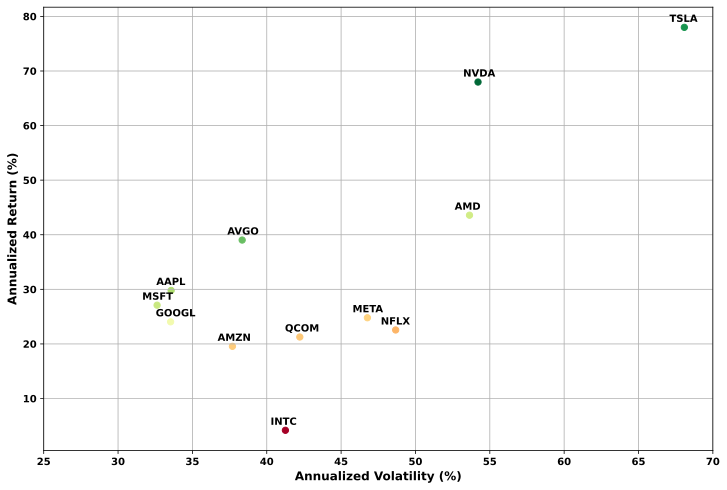

In [34]:
plt.figure(figsize = (12, 8))
plt.scatter(x = summary_stocks[("Annual", "Volatility")].mul(100), y = summary_stocks[("Annual", "Return")].mul(100), 
            s = 40, c = summary_stocks[("Annual", "Sharpe")], cmap = "RdYlGn")

for ticker in summary_stocks.index : 
    plt.annotate(ticker, 
                 xy = (summary_stocks.loc[ticker , ("Annual", "Volatility")] * 100 - 1,  
                       summary_stocks.loc[ticker , ("Annual", "Return")] * 100 + 1), size = 10)

plt.xlabel(xlabel = "Annualized Volatility (%)", fontsize = 12)
plt.ylabel(ylabel = "Annualized Return (%)", fontsize = 12) 
plt.xticks(ticks = range(25, 71, 5))
plt.grid( )
# plt.colorbar(label = "Annual Sharpe")
plt.style.use("default")
plt.show( )

### 1.10 Wins vs Losses
<a id="subsection-110"></a>

$$
\text{Best Return}_{Frequency} = \max (\text{Frequency Return}_{t = 1}, \text{Frequency Return}_{t = 2}, \text{Frequency Return}_{t = 3}, \ldots, \text{Frequency Return}_{t = T}) 
$$ 

$$
\text{Worst Return}_{Frequency} = \min (\text{Frequency Return}_{t = 1}, \text{Frequency Return}_{t = 2}, \text{Frequency Return}_{t = 3}, \ldots, \text{Frequency Return}_{t = T}) 
$$ 

In [35]:
def best_worst_returns(returns_df):
    """
    Arguments:
    - returns_df: DataFrame of daily returns

    Returns:
    - best_worst_df: DataFrame displaying the best and worst returns for each resampling frequency

    Function:
    - Iteratively resamples daily returns
    - For each resampling frequency, computes the maximum return and minimum return for each asset
    """
    best_worst = { }

    resampling = {"D" : "Daily", "W-Fri": "Weekly", "BM": "Monthly", "BQ": "Quarterly", "A": "Annual"}
    for freq in resampling.keys( ):
        
        if freq == "D" :
            periodic_returns_df = returns_df.copy( )
        else :
            periodic_returns_df = returns_df.resample(freq).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
        
        best_worst[f"Best {resampling[freq]} Return"] = np.array(periodic_returns_df.max( ))
        best_worst[f"Worst {resampling[freq]} Return"] = np.array(periodic_returns_df.min( ))

    best_worst_df = pd.DataFrame(data = best_worst, index = returns_df.columns)
    best_worst_df.columns = pd.MultiIndex.from_product([["Daily", "Weekly", "Monthly", "Quarterly", "Annual"],
                                                        ["Best Return", "Worst Return"]])
    return best_worst_df

In [36]:
best_worst_stocks = best_worst_returns(returns[tickers])

In [37]:
best_worst_stocks#.style\
                 #.highlight_max(color = "lightgreen")\
                 #.highlight_min(color = "lightcoral")

Daily                   Weekly                  Monthly  \
      Best Return Worst Return Best Return Worst Return Best Return   
AAPL       0.1198      -0.1286      0.1473      -0.1753      0.2144   
AMD        0.1650      -0.1464      0.2609      -0.1540      0.4718   
AMZN       0.1354      -0.1405      0.1626      -0.1390      0.2706   
AVGO       0.1583      -0.1991      0.2001      -0.1793      0.2896   
GOOGL      0.0924      -0.1163      0.1431      -0.1203      0.1590   
INTC       0.1952      -0.1804      0.1605      -0.1580      0.3105   
META       0.2328      -0.2639      0.2449      -0.2370      0.2677   
MSFT       0.1422      -0.1474      0.1241      -0.1352      0.1763   
NFLX       0.1685      -0.3512      0.2590      -0.3682      0.2861   
NVDA       0.2437      -0.1845      0.2457      -0.1607      0.3634   
QCOM       0.1522      -0.1495      0.2254      -0.1965      0.3572   
TSLA       0.1989      -0.2106      0.3334      -0.2586      0.7415   

                     Quarterly                   Annual               
      Worst Return Best Return Worst Return Best Return Worst Return  
AAPL       -0.1223      0.4346      -0.2170      0.8075      -0.2683  
AMD        -0.2534      0.5584      -0.3006      1.2759      -0.5499  
AMZN       -0.2375      0.4150      -0.3484      0.8088      -0.4962  
AVGO       -0.1626      0.3722      -0.2497      0.9964      -0.1597  
GOOGL      -0.1795      0.2204      -0.2165      0.6530      -0.3909  
INTC       -0.2022      0.4135      -0.3111      0.9012      -0.4868  
META       -0.3263      0.7612      -0.3389      1.9413      -0.6422  
MSFT       -0.1093      0.2904      -0.1670      0.5680      -0.2869  
NFLX       -0.4918      0.3464      -0.5332      0.6711      -0.5105  
NVDA       -0.3203      0.9007      -0.4444      2.3887      -0.5031  
QCOM       -0.1458      0.4178      -0.2333      0.7266      -0.3988  
TSLA       -0.3673      1.0607      -0.5356      7.4344      -0.6503

$$
\text{Batting Average}_{Frequency} = \frac{\text{Number of Periods with Positive Returns}}{\text{T}} 
$$ 

In [38]:
def win_percentage(returns_df) : 
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - win_df : DataFrame displaying the % of rows with positive returns and the gain-pain ratio for each resampling frequency 
    
    Function :
    - Iteratively resamples daily returns 
    - For each resampling frequency, divides the number of timestamps with return > 0 by the total number of timestamps 
    """
    win = { }

    resampling = {"D" : "Day", "W-Fri" : "Week", "BM" : "Month", "BQ" : "Quarter", "A" : "Year"}
    for freq in resampling.keys( ) :
        
        if freq == "D" :
            periodic_returns_df = returns_df.copy( )
        else :
            periodic_returns_df = returns_df.resample(freq).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
        
        percent_win_list = [  ] 
        gain_pain_list = [  ]
        for asset in returns_df.columns :
            asset_periodic_returns = periodic_returns_df[asset].copy( )
            
            positive_returns = asset_periodic_returns.loc[asset_periodic_returns > 0]
            negative_returns = asset_periodic_returns.loc[asset_periodic_returns < 0] 
            
            percent_win_period = (len(positive_returns) / len(asset_periodic_returns)) * 100
            percent_win_list.append(percent_win_period)
            
        win[f"% of Winning {resampling[freq]}s"] = percent_win_list

    win_df = pd.DataFrame(data = win, index = returns_df.columns)
    return win_df   

In [39]:
win_percent_stocks = win_percentage(returns[tickers])

In [40]:
win_percent_stocks

,% of Winning Days,% of Winning Weeks,% of Winning Months,% of Winning Quarters,% of Winning Years
AAPL,52.4851,56.9378,58.3333,62.5000,75.0000
AMD,49.9006,52.1531,50.0000,62.5000,75.0000
AMZN,51.8887,53.1100,56.2500,62.5000,75.0000
AVGO,52.9821,58.8517,70.8333,68.7500,75.0000
GOOGL,53.4791,54.0670,58.3333,68.7500,75.0000
INTC,49.8012,53.5885,54.1667,43.7500,50.0000
META,51.7893,52.6316,62.5000,56.2500,75.0000
MSFT,52.3857,55.0239,58.3333,75.0000,75.0000
NFLX,50.8946,52.6316,54.1667,68.7500,75.0000
NVDA,54.2744,55.0239,62.5000,75.0000,75.0000


$$ 
\text{Gain-Pain Ratio}_{Frequency} = \frac{\sum_{t=1}^{T} \max(0, \text{Return}_{t})}{\text{|}\sum_{t=1}^{T} \min(0, \text{Return}_{t})\text{|}}
$$ 

$$ 
\text{Pay Off Ratio}_{Frequency} = \frac{\frac{1}{T}\sum_{t=1}^{T} \text{Return}_{t} > 0}{\text{|}\frac{1}{T}\sum_{t=1}^{T} \text{Return}_{t} < 0\text{|}}
$$ 

$$ 
\text{Kelly Criterion}_{Frequency} = \frac{\text{Pay Off Ratio}_{Frequency} \times \text{Batting Average}_{Frequency} - (\text{1 - Batting Average}_{Frequency})}{\text{Pay Off Ratio}_{Frequency}}
$$ 

In [41]:
def win_loss_ratios(returns_df) :  
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - win_loss_df : DataFrame displaying the gain-pain ratio, payoff ratio, and kelly criterion for each resampling frequency 
    
    Function :
    - Iteratively resamples daily returns 
    - For each resampling frequency : 
      - Divides the sum of positive returns by the absolute value of the sum of negative returns 
      - Divides the average positive return by the absolute value of the average negative return 
    """
    win_loss = { }

    resampling = {"D" : "Daily", "W-Fri" : "Weekly", "BM" : "Monthly", "BQ" : "Quarterly", "A" : "Annual"}
    for freq in resampling.keys( ) :
        
        if freq == "D" :
            periodic_returns_df = returns_df.copy( )
        else :
            periodic_returns_df = returns_df.resample(freq).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
        
        gain_pain_list = [  ]
        payoff_list = [  ]
        kelly_list = [  ]
        for asset in returns_df.columns :
            asset_periodic_returns = periodic_returns_df[asset].copy( )
            
            positive_returns = asset_periodic_returns.loc[asset_periodic_returns > 0]
            negative_returns = asset_periodic_returns.loc[asset_periodic_returns < 0] 
            
            gain_pain_period = positive_returns.sum( ) / np.abs(negative_returns.sum( ))
            gain_pain_list.append(gain_pain_period)
            
            payoff_period = positive_returns.mean( ) / np.abs(negative_returns.mean( ))
            payoff_list.append(payoff_period)

            percent_win_period = len(positive_returns) / len(asset_periodic_returns) 
            kelly_period = ((payoff_period * percent_win_period - (1 - percent_win_period)) / payoff_period) * 100
            kelly_list.append(kelly_period)
            
        win_loss[f"{resampling[freq]} Gain-Pain Ratio"] = gain_pain_list
        win_loss[f"{resampling[freq]} Pay Off Ratio"] = payoff_list
        win_loss[f"{resampling[freq]} Kelly Criterion (%)"] = kelly_list

    win_loss_df = pd.DataFrame(data = win_loss, index = returns_df.columns)
    win_loss_df.columns = pd.MultiIndex.from_product([["Daily", "Weekly", "Monthly", "Quarterly", "Annual"],
                                                      ["Gain-Pain Ratio", "Pay Off Ratio", "Kelly Criterion (%)"]]) 
    return win_loss_df   

In [42]:
win_loss_stocks = win_loss_ratios(returns[tickers])

In [43]:
win_loss_stocks#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral")

Daily                                            Weekly  \
      Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio   
AAPL           1.1713        1.0537              7.3926          1.4258   
AMD            1.1500        1.1500              6.3362          1.3395   
AMZN           1.0948        1.0109              4.2959          1.2178   
AVGO           1.2036        1.0682              8.9641          1.5325   
GOOGL          1.1347        0.9849              6.2459          1.3070   
INTC           1.0188        1.0148              0.3330          1.0257   
META           1.1061        1.0276              4.8728          1.2227   
MSFT           1.1599        1.0499              7.0329          1.4011   
NFLX           1.0928        1.0543              4.3204          1.2060   
NVDA           1.2397        1.0399             10.3034          1.6295   
QCOM           1.0927        1.0627              4.3006          1.2091   
TSLA           1.2237        1.0495              9.7357          1.5051   

                                                Monthly                \
      Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio   
AAPL         1.0784             17.0052          1.8863        1.3473   
AMD          1.2289             13.2192          1.8037        1.8037   
AMZN         1.0752              9.4985          1.4731        1.1457   
AVGO         1.0715             20.4482          2.3795        0.9798   
GOOGL        1.1104             12.7007          1.7234        1.2310   
INTC         0.8883              1.3433          1.0352        0.8759   
META         1.1005              9.5879          1.5200        0.9120   
MSFT         1.1452             15.7507          2.1260        1.5186   
NFLX         1.0854              8.9911          1.5014        1.2704   
NVDA         1.3320             21.2572          2.5682        1.5409   
QCOM         1.0472              9.2673          1.4511        1.3350   
TSLA         1.1835             18.7873          2.2659        1.7623   

                                Quarterly                                    \
      Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)   
AAPL              27.4083          2.9477        1.7686             41.2968   
AMD               22.2799          2.7608        1.6565             39.8614   
AMZN              18.0642          2.0388        1.2233             31.8447   
AVGO              41.0655          3.4319        1.5599             48.7172   
GOOGL             24.4846          2.5131        1.1423             41.3938   
INTC               1.8420          1.0774        1.3852              3.1418   
META              21.3803          1.9509        1.5174             27.4173   
MSFT              30.8956          3.4311        1.1437             53.1413   
NFLX              18.0883          1.8646        0.8475             31.8788   
NVDA              38.1637          5.0020        1.6673             60.0059   
QCOM              16.1914          1.7755        2.2827             19.1086   
TSLA              31.4252          4.5441        2.0655             53.6204   

               Annual                                    
      Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)  
AAPL           6.0662        2.0221             62.6364  
AMD            5.1733        1.7244             60.5024  
AMZN           3.2150        1.0717             51.6720  
AVGO          11.9060        3.9687             68.7007  
GOOGL          3.9518        1.3173             56.0213  
INTC           1.4288        1.4288             15.0052  
META           3.8983        1.2994             55.7606  
MSFT           5.1947        1.7316             60.5621  
NFLX           2.8135        0.9378             48.3431  
NVDA           9.6615        3.2205             67.2372  
QCOM           3.1157        1.0386             50.9284  
TSLA          13.7612        4.5871             69.5499

In [44]:
def streak(returns_df) : 
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - streak_df : DataFrame displaying the longest streak of days with positive / negative returns for each resampling frequency 
    
    Function :
    - Iteratively resamples daily returns 
    - For each resampling frequency, computes the highest number of consecutive days with returns > 0 / returns < 0
    """
    streak = { }

    resampling = {"D" : "Day", "W-Fri" : "Week", "BM" : "Month", "BQ" : "Quarter", "A" : "Year"}
    for freq in resampling.keys( ) :
        
        if freq == "D" :
            periodic_returns_df = returns_df.copy( )
        else :
            periodic_returns_df = returns_df.resample(freq).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
        
        longest_win_list = [  ]
        longest_lose_list = [  ]
        for asset in returns_df.columns :
            asset_periodic_returns = periodic_returns_df[asset].copy( )
            
            longest_win_streak = 0
            current_win_streak = 0      
            for return_value in asset_periodic_returns.values :
                if return_value > 0 :
                    current_win_streak += 1
                    if current_win_streak > longest_win_streak :
                        longest_win_streak = current_win_streak
                else :
                    current_win_streak = 0
            longest_win_list.append(longest_win_streak)
            
            longest_lose_streak = 0
            current_lose_streak = 0      
            for return_value in asset_periodic_returns.values :
                if return_value < 0 :
                    current_lose_streak += 1
                    if current_lose_streak > longest_lose_streak :
                        longest_lose_streak = current_lose_streak
                else :
                    current_lose_streak = 0
            longest_lose_list.append(longest_lose_streak) 
            
        streak[f"Longest Streak of Winning {resampling[freq]}s"] = longest_win_list
        streak[f"Longest Streak of Losing {resampling[freq]}s"] = longest_lose_list
    
    streak_df = pd.DataFrame(data = streak, index = returns_df.columns)   
    streak_df = pd.concat(axis = 1, objs = [ streak_df.loc[: , streak_df.columns.str.contains("Winning")] , 
                                             streak_df.loc[: , streak_df.columns.str.contains("Losing")] ])
    streak_df.columns = pd.MultiIndex.from_product([["Longest Winning Streak", "Longest Losing Streak"],
                                                    ["Days", "Weeks", "Months", "Quarters", "Years"]]) 
    return streak_df   

In [45]:
win_lose_streak_stocks = streak(returns[tickers])

In [46]:
win_lose_streak_stocks

Longest Winning Streak                              \
                        Days Weeks Months Quarters Years   
AAPL                      11     8      7        3     2   
AMD                        8     7      3        3     2   
AMZN                       8    10      6        4     2   
AVGO                       8     7      6        7     2   
GOOGL                      7     8      8        7     2   
INTC                       9     7      5        5     1   
META                       8     6      9        5     2   
MSFT                       9     9      6        8     2   
NFLX                       8     6      4        4     2   
NVDA                      10     9      6        5     2   
QCOM                       9     6      5        3     2   
TSLA                      13    11      6        4     2   

      Longest Losing Streak                              
                       Days Weeks Months Quarters Years  
AAPL                      8     8      3        2     1  
AMD                       8     5      4        3     1  
AMZN                      7     8      5        2     1  
AVGO                      7     5      3        3     1  
GOOGL                     6     5      3        4     1  
INTC                      7     4      4        6     1  
META                      7     7      4        6     1  
MSFT                      7     5      3        3     1  
NFLX                      8     7      6        3     1  
NVDA                      7     5      3        3     1  
QCOM                      9     6      4        4     1  
TSLA                      7     5      5        2     1

### 1.11 Statistical Attributes of Returns 
<a id="subsection-111"></a>

***Tests of Normality :***

$$ 
W = \frac{{(\sum_{i=1}^{T} a_i x_{(i)})^2}}{{\sum_{i=1}^{T} (x_i - \bar{x})^2}} 
$$ 

$\text{Where :}$
- $ T \text{ is the sample size.} $
- $ x_{(i)} \text{ is the \( i \)-th order statistic (i.e., the \( i \)-th smallest value in the sample).} $
- $ \bar{x} \text{ is the sample mean.} $
- $ a_i \text{ are constants obtained from the covariance matrix of the order statistics of a normal sample.} $

The Shapiro-Wilk test evaluates the null hypothesis that the sample is normally distributed. If the p-value associated with the test statistic $W$ is less than a chosen significance level (e.g., 0.05), the null hypothesis is rejected, suggesting that the sample does not follow a normal distribution.

$$
JB = \frac{T}{6} \left( S^2 + \frac{1}{4}(K-3)^2 \right)
$$

Where:
- $ T \text{ is the sample size.} $
- $ S \text{ is the sample skewness.} $
- $ K \text{ is the sample kurtosis.} $

The Jarque-Bera test evaluates the null hypothesis that the sample is normally distributed. If the p-value associated with the test statistic $JB$ is less than a chosen significance level (e.g., 0.05), the null hypothesis is rejected, suggesting that the sample does not follow a normal distribution.

***Tests of Stationarity :***

$$ 
\text{ADF} = \frac{{\text{Coefficient Estimate} - 1}}{{\text{Standard Error}}} 
$$

Where:
- $ \text{Coefficient Estimate is the estimated coefficient of the lagged differenced series in the regression equation.} $
- $ \text{Standard error is the standard error of the coefficient estimate.} $

The Augmented Dickey-Fuller test evaluates the null hypothesis that the time series is stationary around a deterministic trend. If the p-value associated with the test statistic $ADF$ is less than a chosen significance level (e.g., 0.05), the null hypothesis is rejected. The time series has a unit root, indicating non-stationarity (or a stochastic trend).

$$
\text{KPSS} = \frac{{\sum_{t=1}^{T} (S_t - S_{t-1})^2 / T}}{{(\sum_{t=1}^{T} S_t^2 / T)}}
$$

Where:
- $ S_t \text{ is the cumulative sum of the deviations of the time series from its mean at time \( t \).} $
- $ T \text{ is the number of observations in the time series.} $

The Kwiatkowski-Phillips-Schmidt-Shin test evaluates the null hypothesis that the time series is stationary around a deterministic trend. If the p-value associated with the test statistic $KPSS$ is less than a chosen significance level (e.g., 0.05), the null hypothesis is rejected. The time series has a unit root, indicating non-stationarity (or a stochastic trend).

***Finding the Best-Fit Distribution :***

$$ 
D = \max_{i} | F(x_i) - S(x_i) | 
$$ 

$\text{Where :}$
- $ F(x) \text{ is the empirical cumulative distribution function (CDF) of the sample.} $
- $ S(x) \text{ is the theoretical CDF of the specified distribution.} $ 
- $ x_i \text{ are the observed data points.} $

The Kolmogorov-Smirnov test evaluates the null hypothesis that the sample is drawn from the specified distribution. The closer the p-value associated with the test statistic D is to 1, the more the null hypothesis is rejected (assuming p-value > significance level), suggesting that the sample follows more strongly the specified distribution. 

***Common Distributions for Fitting Stock Returns :***

$$ 
F(x) = \frac{1}{2} + \frac{1}{2} \cdot \text{sign}(x - \mu) \cdot \left[1 - \exp\left(-\left(\frac{|x - \mu|}{\beta}\right)^{\alpha}\right)\right] 
$$

$\text{Where :}$
- $ F(x) \text{ is the cumulative distribution function at \( x \)}. $
- $ \mu \text{ is the location parameter.} $
- $ \beta \text{ is the scale parameter.} $
- $ \alpha \text{ is the shape parameter.} $
- $ \text{sign}(x - \mu) \text{ is the sign function, which is 1 if \( x > \mu \), -1 if \( x < \mu \), and 0 if \( x = \mu \).} $
- $ |x - \mu| \text{ represents the absolute difference between \( x \) and \( \mu \).} $

The CDF defines the probability that a random variable following the **Generalized Normal Distribution** is less than or equal to a given value $x$.

$$
F(x) = \frac{1}{\sqrt{2 \pi}} \int_{-\infty}^{x} \frac{1}{\sigma \sqrt{1 + \left(\frac{y - \mu}{\gamma}\right)^2}} e^{-\frac{1}{2} \left(\frac{u}{\sigma \sqrt{1 + \left(\frac{y - \mu}{\gamma}\right)^2}}\right)^2} \, du 
$$

$\text{Where :}$
- $ F(x) \text{ is the cumulative distribution function at \( x \)}. $
- $ \mu \text{ is the location parameter.} $
- $ \gamma \text{ is the shape parameter (scale parameter in some formulations).} $
- $ \sigma \text{ is the scale parameter (shape parameter in some formulations).} $
- $ \text{e is the base of natural logarithms.} $
- $ \pi \text{ is the mathematical constant pi.} $

The CDF defines the probability that a random variable following the **Johnson SU Distribution** is less than or equal to a given value $x$.

$$ 
F(x) = \int_{-\infty}^{x} \frac{\Gamma\left(\frac{\nu + 1}{2}\right)}{\sqrt{\nu \pi} \Gamma\left(\frac{\nu}{2}\right)} \left(1 + \frac{t^2}{\nu}\right)^{-\frac{\nu + 1}{2}} \, dt 
$$

$\text{Where :}$
- $ F(x) \text{ is the cumulative distribution function at \( x \)} $
- $ \nu \text{ is the degrees of freedom parameter, which affects the shape and tail behavior of the distribution.} $
- $ \Gamma(\cdot) \text{ is the gamma function.} $
- $ t \text{ represents the random variable following the Student's t-distribution.} $

The CDF defines the probability that a random variable following the **Student's t Distribution** is less than or equal to a given value $x$.

In [47]:
def distribution_attributes(returns_df) : 
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - distribution_df : DataFrame displaying ratios for analyzing the distribution of daily returns 
    
    Function :
    - Conducts the Shapiro-Wilik and Jarque-Bera tests of normality and computes the p-values 
    - Conducts the Augmented Dickey-Fuller, Kwiatkowski-Phillips-Schmidt-Shin tests of stationarity and computes the p-values 
    - Returns the distribution (and its p-value) that best fits each asset's daily returns amongst different distributions 
    """   
    sw_list = [  ]
    jb_list = [  ]
    adf_list = [  ]
    kpss_list = [  ]
    best_dist_list = [  ]
    best_p_val_list = [  ]
    for asset in returns_df.columns : 
        
        p_val_sw = stats.shapiro(returns_df[asset])[1] 
        p_val_jb = stats.jarque_bera(returns_df[asset])[1]
        p_val_adf = adfuller(returns_df[asset])[1]
        p_val_kpss = kpss(returns_df[asset])[1]
        
        sw_list.append(p_val_sw)
        jb_list.append(p_val_jb)
        adf_list.append(p_val_adf)
        kpss_list.append(p_val_kpss)
        
        dist_names = ["lognorm", "gennorm", "exponnorm", "powernorm", "skewnorm", "truncnorm", "johnsonsb", "johnsonsu", 
                      "beta", "burr", "cauchy", "expon", "gamma", "genextreme", "invgauss", "laplace", "pareto", "t"]
        dist_results = [ ]
        for dist_name in dist_names:
            
            dist = getattr(stats, dist_name)
            params = dist.fit(returns_df[asset])
            stat, p_val = stats.kstest(returns_df[asset], dist_name, args = params)
            dist_results.append((dist_name, p_val))
        
        best_dist, best_p_val = (max(dist_results, key = lambda item: item[1]))
        best_dist_list.append(best_dist)
        best_p_val_list.append(best_p_val)
        
    tests_df = pd.DataFrame({"Shapiro-Wilk P-Value" : sw_list, "Jarque-Bera P-Value" : jb_list, 
                             "Augmented Dickey-Fuller P-Value" : adf_list, "Kwiatkowski-Phillips-Schmidt-Shin P-Value" : kpss_list, 
                             "Best-Fit Distribution" : best_dist_list, "Best-Fit P-Value" : best_p_val_list}, 
                            index = returns_df.columns)
    return tests_df 

In [48]:
dist_attributes_stocks = distribution_attributes(returns[tickers])

In [49]:
dist_attributes_stocks

,Shapiro-Wilk P-Value,Jarque-Bera P-Value,Augmented Dickey-Fuller P-Value,Kwiatkowski-Phillips-Schmidt-Shin P-Value,Best-Fit Distribution,Best-Fit P-Value
AAPL,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9478
AMD,0.0000,0.0000,0.0000,0.1000,gennorm,0.4572
AMZN,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9959
AVGO,0.0000,0.0000,0.0000,0.1000,t,0.9620
GOOGL,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9044
INTC,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9751
META,0.0000,0.0000,0.0000,0.1000,t,0.5524
MSFT,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.8796
NFLX,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9971
NVDA,0.0000,0.0000,0.0000,0.1000,t,0.9725


In [50]:
def plot_qq(returns_df) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 

    Returns :
    - None 
    
    Function :
    - Draws a quantile-quantile plot of daily returns for each asset
    """
    assets = returns_df.columns
    n_assets = len(returns_df.columns)
    
    if n_assets % 2 != 0 :
        n_rows = int(n_assets / 2) + 1
    else :
        n_rows = int(n_assets / 2)
    
    fig, ax = plt.subplots(n_rows, 2, figsize = (12, n_rows * 5))

    for i in range(n_rows) :
        for j in range(2) :
            if i + i + j <= n_assets - 1 :
                asset = assets[i + i + j]
                gofplots.qqplot(returns_df[asset] * 100, line = "q", ax = ax[i , j])
                ax[i, j].get_lines( )[0].set_markersize(5)
                                
                ax[i , j].set_xlabel("σ Away From μ", fontsize = 12)
                if (i + i + j) % 2 == 0 :
                    ax[i , j].set_ylabel("Daily Returns (%)", fontsize = 12)
                else :
                    ax[i , j].set_ylabel("")
                ax[i , j].legend([asset], fontsize = 10)
    
    plt.style.use("default")
    plt.show( )

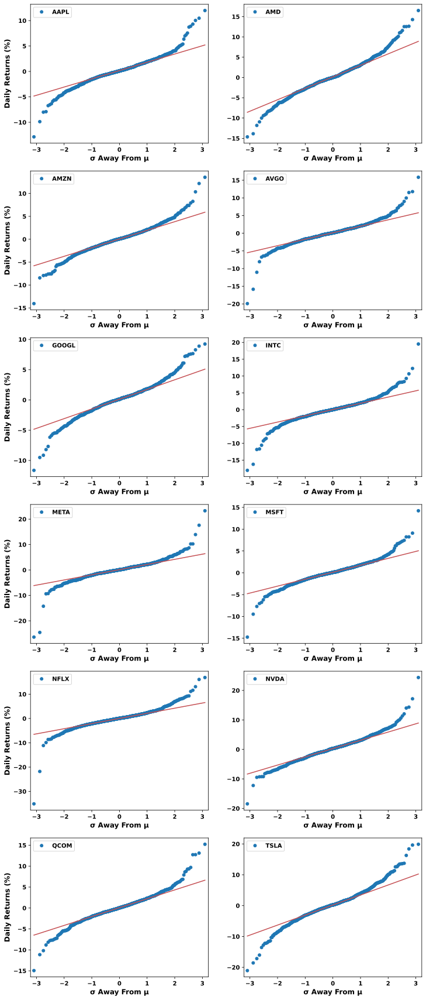

In [51]:
plot_qq(returns[tickers])

### 1.12 What About Drawdowns and Downside Risk? 
<a id="subsection-112"></a>

$$ 
\text{Annualized Downside } \sigma = \sqrt{\frac{1}{T} \sum_{t=1}^{T} \min\left((\text{Return}_{t} - \bar{\text{Return}})^2, 0\right)} \times \sqrt{252} 
$$ 

$$
\text{Average Drawdown} = \frac{1}{T} \sum_{t=1}^{T} \text{Drawdown}_{t}
$$ 

$$
\text{Average Drawdown Duration} = \frac{\text{Number of Drawdown Days}}{\text{Number of Drawdowns}} 
$$ 

$$
\text{Maximum Drawdown} = \max (\text{Drawdown}_{t = 1}, \text{Drawdown}_{t = 2}, \text{Drawdown}_{t = 3}, \ldots, \text{Drawdown}_{t = T}) 
$$ 

$$
\text{Longest Drawdown Duration} = \max(\text{Drawdown Duration}_1, \text{Drawdown Duration}_2, \ldots, \text{Drawdown Duration}_N)
$$ 

$$
\text{Sterling Ratio} = \frac{\text{Annualized Return} - \text{Risk-Free Rate}}{\text{|} \frac{1}{N} \sum_{i=1}^{N} \text{Largest Drawdown}_i\text{|}} 
$$

$$
\text{Ulcer Index} = \sqrt{\frac{1}{T} \sum_{t=1}^{T} (\text{Drawdown}_{t})^2} \times 100
$$

$$
\text{Calmar Ratio} = \frac{\text{Annualized } \bar{\text{Return}}}{\text{|Maximum Drawdown|}}
$$ 

$$
\text{Sortino Ratio} = \frac{\text{Annualized } \bar{\text{Return}} - \text{Risk-Free Rate}}{\text{Annualized Downside } \sigma}
$$ 

$$
\text{Kappa Ratio} = \frac{\text{Annualized } \bar{\text{Return}} - \text{Risk-Free Rate}}{\text{Annualized Downside } \sigma + \text{|Skew|} + \text{|Kurtosis|}}
$$ 

In [52]:
def downside(returns_df) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - downside_df : DataFrame displaying ratios related to downside risk  
    
    Function :
    - Computes the annualized semi-deviation, average drawdown, maximum drawdown, sterling ratio, ulcer index, calmar ratio, sortino ratio, and kappa ratio 
    """
    wealth_index = (1 + returns_df).cumprod( )
    previous_peaks = wealth_index.cummax( )
    drawdowns_df = (wealth_index - previous_peaks) / previous_peaks
    
    avg_drawdown = np.array(drawdowns_df.mean( )) 
    max_drawdown = np.array(drawdowns_df.min( )) 
    
    longest_dd_duration_list = [  ]
    avg_dd_duration_list = [  ]
    sterling_list = [  ]
    for asset in drawdowns_df.columns :
        
        longest_dd_streak = 0
        current_dd_streak = 0 
        n_drawdowns = 0
        for drawdown_value in drawdowns_df[asset].values :
            if drawdown_value < 0 :
                current_dd_streak += 1
                if current_dd_streak > longest_dd_streak :
                    longest_dd_streak = current_dd_streak
            else :
                n_drawdowns += 1 
                current_dd_streak = 0
        longest_dd_duration_list.append(longest_dd_streak)   
        
        n_dd_days = len(drawdowns_df[asset].loc[drawdowns_df[asset] < 0]) 
        avg_dd_duration = n_dd_days / n_drawdowns 
        avg_dd_duration_list.append(avg_dd_duration)
        
        ann_return = returns_df[asset].mean( ) * 252 
        worst_five_dds = drawdowns_df[asset].nsmallest(5).values
        avg_worst_dd = worst_five_dds.mean( )
        sterling = (ann_return - rf_rate) / np.abs(avg_worst_dd) 
        sterling_list.append(sterling)
        
    mean_squared_drawdowns = np.array(drawdowns_df.pow(2).mean( )) 
    ulcer_index = np.sqrt(mean_squared_drawdowns) * 100 
    
    avg_return = np.array(returns_df.mean( ).mul(252)) 
    calmar = avg_return / np.abs(max_drawdown) 
    
    downside_std_list = [  ]
    sortino_list = [  ]
    kappa_list = [  ]
    for asset in returns_df.columns : 
        
        downside_returns = returns_df[asset].loc[returns_df[asset] < 0]
        downside_std = downside_returns.std( ) * np.sqrt(252)
        downside_std_list.append(downside_std)
        
        ann_return = returns_df[asset].mean( ) * 252 
        sortino = (ann_return - rf_rate) / downside_std 
        sortino_list.append(sortino)
        
        skew = returns_df[asset].skew( )
        kurt = returns_df[asset].kurtosis( )
        kappa = (ann_return - rf_rate) / (downside_std + np.abs(skew) + np.abs(kurt)) 
        kappa_list.append(kappa)
        
    downside_df = pd.DataFrame(data = {"Annual Downside Standard Deviation" : downside_std_list, 
                                       "Average Drawdown" : avg_drawdown, "Average Drawdown Duration (Days)" : avg_dd_duration_list, 
                                       "Maximum Drawdown" : max_drawdown, "Longest Drawdown Duration (Days)" : longest_dd_duration_list, 
                                       "Sterling Ratio" : sterling_list, "Ulcer Index" : ulcer_index, 
                                       "Calmar Ratio" : calmar, "Sortino Ratio" : sortino_list, "Kappa Ratio" : kappa_list}, 
                               index = returns_df.columns)
    return downside_df 

In [53]:
downside_stocks = downside(returns[tickers]) 

In [54]:
downside_stocks#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral")

,Annual Downside Standard Deviation,Average Drawdown,Average Drawdown Duration (Days),Maximum Drawdown,Longest Drawdown Duration (Days),Sterling Ratio,Ulcer Index,Calmar Ratio,Sortino Ratio,Kappa Ratio
AAPL,0.2359,-0.0957,12.0649,-0.3143,360,0.8622,12.1738,0.9479,1.1358,0.0517
AMD,0.3432,-0.2496,19.5306,-0.6545,524,0.6279,30.9158,0.6658,1.1822,0.1492
AMZN,0.2560,-0.2023,23.5366,-0.5615,624,0.2987,25.8112,0.3483,0.6468,0.0403
AVGO,0.2800,-0.0914,9.5895,-0.4830,349,0.8503,12.9584,0.8081,1.2867,0.0348
GOOGL,0.2386,-0.1343,10.0549,-0.4432,530,0.4928,18.2466,0.5426,0.8820,0.0592
INTC,0.3074,-0.3291,250.5000,-0.6363,990,0.0185,37.2002,0.0656,0.0382,0.0013
META,0.3662,-0.2518,22.9524,-0.7674,582,0.2868,33.5673,0.3231,0.5952,0.0122
MSFT,0.2302,-0.1044,10.0549,-0.3756,392,0.6744,14.3968,0.7215,1.0469,0.0357
NFLX,0.3862,-0.2926,22.9524,-0.7595,531,0.2590,37.9341,0.2970,0.5063,0.0083
NVDA,0.3382,-0.1793,8.6731,-0.6636,373,0.9947,26.1170,1.0243,1.9212,0.1275


$$
\text{Drawdown}_{t} = \min \left( 0 , \text{Cumulative Return}_{t} - \text{Previous Peak}_{t} \right) 
$$ 

In [55]:
def plot_drawdowns(returns_df) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - None

    Function : 
    - Computes drawdowns for each asset
    - Plots area charts of drawdowns for each asset 
    """
    wealth_index = (1 + returns_df).cumprod( )
    previous_peaks = wealth_index.cummax( )
    drawdowns_df = (wealth_index - previous_peaks) / previous_peaks 
    
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    ax = drawdowns_df.mul(100).plot(kind = "area", alpha = 0.5, figsize = (12 , len(returns_df.columns) * 3), fontsize = 10, 
                                    subplots = True, sharex = False, color = colors, xlabel = "", ylabel = "Drawdown (%)") 
    avg_drawdowns = np.array(drawdowns_df.mean( )) * 100
    
    for i in range(len(ax)) :
        ax[i].axhline(y = avg_drawdowns[i], color = "red", linestyle = "--", label = str(avg_drawdowns[i].round(2)))
        ax[i].legend( )
        
    plt.style.use("default") 
    plt.show( ) 

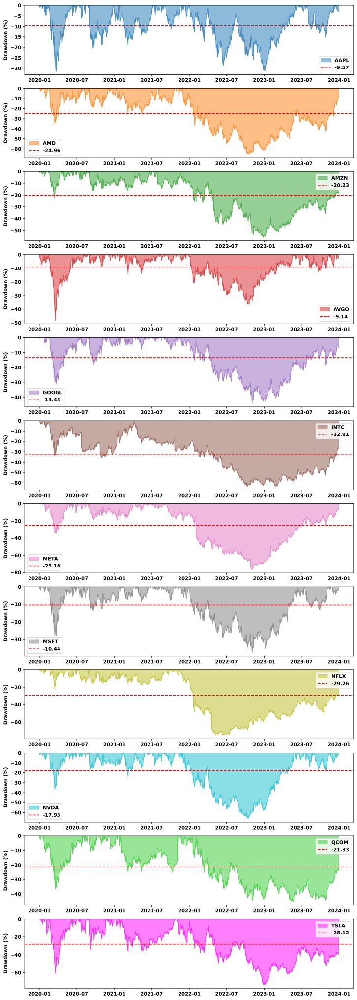

In [56]:
plot_drawdowns(returns[tickers])

### 1.13 Tail Risk
<a id="subsection-113"></a>

$$ 
\text{Skew} = \frac{\frac{1}{T} \sum_{t=1}^{T} (\text{Return}_{t} - \bar{\text{Return}})^3}{\left(\frac{1}{T} \sum_{t=1}^{T} (\text{Return}_{t} - \bar{\text{Return}})^2\right)^{3/2}}
$$ 

$$
\text{Kurtosis} = \frac{\frac{1}{T} \sum_{t=1}^{T} (\text{Return}_{t} - \bar{\text{Return}})^4}{\left(\frac{1}{T} \sum_{t=1}^{T} (\text{Return}_{t} - \bar{\text{Return}})^2\right)^{2}}
$$

$$
\text{Average Lower Tail Return} = \frac{1}{T} \sum_{t=1}^{T} \text{(Return < % Threshold)}_{t}
$$

$$
\text{Average Upper Tail Return} = \frac{1}{T} \sum_{t=1}^{T} \text{(Return > (1 - %) Threshold)}_{t}
$$

$$
\text{Tail Ratio} = \frac{\text{Average Upper Tail Return}}{\text{|Average Lower Tail Return|}}
$$

$$
\text{Common Sense Ratio} = \text{Gain-Pain Ratio} \times \text{Tail Ratio}
$$

$$
\text{Outlier Win Ratio} = \frac{\frac{1}{T} \sum_{t=1}^{T} (\text{Return} > \text{99th percentile})_{t}}{\frac{1}{T} \sum_{t=1}^{T} (\text{Return > 0})_{t}}
$$

$$
\text{Outlier Loss Ratio} = \frac{\frac{1}{T} \sum_{t=1}^{T} (\text{Return} < \text{1st percentile})_{t}}{\frac{1}{T} \sum_{t=1}^{T} (\text{Return < 0})_{t}}
$$

In [57]:
def tail_attributes(returns_df, threshold = 0.05) : 
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    - threshold : float representing the quantile for lower and upper tail returns -> 0.01 or 0.05 or 0.1 
    
    Returns :
    - tail_df : DataFrame displaying ratios for analyzing the tail characteristics of daily returns 
    
    Function :
    - Computes the skew, kurtosis, average lower tail return, average upper tail return, tail ratio, common sense ratio, outlier win ratio, and outlier loss ratio 
    """
    tail_df = returns_df.agg(["skew" , "kurt"]).transpose( )
    tail_df.columns = ["Skew" , "Kurtosis"]  
    
    avg_lt_return_list = [  ]
    avg_ut_return_list = [  ]
    tail_list = [  ]
    common_sense_list = [  ]
    outlier_win_list = [  ]
    outlier_loss_list = [  ]
    for asset in returns_df.columns :
        
        lower_tail_threshold = returns_df[asset].quantile(threshold)  
        lower_tail_returns = returns_df[asset].loc[returns_df[asset] < lower_tail_threshold]
        avg_lt_return = lower_tail_returns.mean( )
        
        upper_tail_threshold = returns_df[asset].quantile(1 - threshold)
        upper_tail_returns = returns_df[asset].loc[returns_df[asset] > upper_tail_threshold]
        avg_ut_return = upper_tail_returns.mean( )
        
        tail = avg_ut_return / np.abs(avg_lt_return)
        
        positive_returns = returns_df[asset].loc[returns_df[asset] > 0]
        negative_returns = returns_df[asset].loc[returns_df[asset] < 0] 
        gain_pain = positive_returns.sum( ) / np.abs(negative_returns.sum( ))
        common_sense = gain_pain * tail 
        
        avg_upper_outlier_return = returns_df[asset].quantile(0.99).mean( )
        avg_positive_return = returns_df[asset].loc[returns_df[asset] > 0].mean( )
        outlier_win = avg_upper_outlier_return / avg_positive_return
        
        avg_lower_outlier_return = returns_df[asset].quantile(0.01).mean( )
        avg_negative_return = returns_df[asset].loc[returns_df[asset] < 0].mean( )
        outlier_loss = avg_lower_outlier_return / avg_negative_return
        
        avg_lt_return_list.append(avg_lt_return)
        avg_ut_return_list.append(avg_ut_return)
        tail_list.append(tail)
        common_sense_list.append(common_sense)
        outlier_win_list.append(outlier_win)
        outlier_loss_list.append(outlier_loss)
    
    tail_df[f"Average Lower Tail Return (< {int(threshold * 100)}%)"] = avg_lt_return_list 
    tail_df[f"Average Upper Tail Return (> {int((1 - threshold) * 100)}%)"] = avg_ut_return_list 
    tail_df["Tail Ratio"] = tail_list
    tail_df["Common Sense Ratio"] = common_sense_list
    tail_df["Outlier Win Ratio (> 99%)"] = outlier_win_list
    tail_df["Outlier Loss Ratio (< 1%)"] = outlier_loss_list 

    return tail_df 

In [58]:
tail_stocks = tail_attributes(returns[tickers], threshold = 0.05)

In [59]:
tail_stocks#.style\
           #.highlight_max(color = "lightgreen")\
           #.highlight_min(color = "lightcoral")

,Skew,Kurtosis,Average Lower Tail Return (< 5%),Average Upper Tail Return (> 95%),Tail Ratio,Common Sense Ratio,Outlier Win Ratio (> 99%),Outlier Loss Ratio (< 1%)
AAPL,0.0769,4.8718,-0.0469,0.0488,1.0415,1.2199,3.4926,3.8015
AMD,0.2163,2.1605,-0.0715,0.0805,1.1259,1.2948,3.6419,3.5715
AMZN,0.0959,3.7537,-0.0527,0.0550,1.0431,1.1420,3.7276,3.4725
AVGO,-0.3107,9.7730,-0.0518,0.0567,1.0950,1.3180,3.6795,3.4615
GOOGL,-0.0966,3.2226,-0.0477,0.0497,1.0405,1.1806,4.0386,3.5569
INTC,-0.1492,8.7736,-0.0601,0.0596,0.9923,1.0110,3.8716,3.9011
META,-0.5770,16.8893,-0.0644,0.0669,1.0380,1.1482,3.7227,3.5063
MSFT,0.0246,6.4885,-0.0452,0.0478,1.0567,1.2257,4.1982,3.4894
NFLX,-1.3312,21.7792,-0.0668,0.0722,1.0811,1.1813,3.9789,3.6807
NVDA,0.4226,4.3344,-0.0696,0.0811,1.1643,1.4434,3.5582,3.1312


$$
\text{Historic Value at Risk}_{\alpha, Frequency} = \text{Quantile}_{\alpha}(\text{Historical Returns}) \times \text{Number of Trading Days}_{Frequency}  
$$ 

$$
\text{Parametric Value at Risk}_{\alpha, Frequency} = (\mu + z_{\alpha} \times \sigma) \times \text{Number of Trading Days}_{Frequency}  
$$ 

$$
\text{Cornish-Fisher Value at Risk}_{\alpha, Frequency} = \left( \mu + \sigma \times \left( z_{\alpha} + \frac{1}{6} (z_{\alpha}^2 - 1) \times \text{skewness} + \frac{1}{24}(z_{\alpha}^3 - 3z_{\alpha}) \times \text{kurtosis} - \frac{1}{36}(2z_{\alpha}^3 - 5z_{\alpha}) \times \text{skewness}^2 \right) \right) \times \text{Number of Trading Days}_{Frequency} 
$$

$$
\text{Conditional Value at Risk}_{\alpha, Frequency} = \left( \frac{1}{1-\alpha} \int_{-\infty}^{\text{VaR}_{\alpha}} x \cdot f(x) \,dx \right)  \times \text{Number of Trading Days}_{Frequency} 
$$ 

In [60]:
def Value_at_Risk(returns_df, significance = 0.05) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    - significance : float representing the significance level -> 0.01 or 0.05 or 0.1  
    
    Returns :
    - VaR_df : DataFrame displaying ratios related to Value at Risk 
    
    Function :
    - Computes the historic VaR, parametric VaR, cornish-fisher VaR, and Conditional VaR at the specified confidence level 
    """
    
    hist_VaR_list = list(np.percentile(returns_df, significance * 100, axis = 0)) 
    
    param_VaR_list = [  ]
    cf_VaR_list = [  ]
    for asset in returns_df.columns :
        
        avg_return = returns_df[asset].mean( )
        vol = returns_df[asset].std( )
        param_VaR = stats.norm.ppf(significance, avg_return, vol)
        param_VaR_list.append(param_VaR)
        
        skew = returns_df[asset].skew( )
        kurtosis = returns_df[asset].kurt( )
        z_score = stats.norm.ppf(significance)
        z_score_cf = z_score + (z_score**2 - 1) * skew / 6 + (z_score**3 - 3 * z_score) * kurtosis / 24 - (2 * z_score**3 - 5 * z_score) * (skew**2) / 36
        cf_VaR = avg_return + z_score_cf * vol
        cf_VaR_list.append(cf_VaR)
        
    cond_VaR_list = [  ]
    for i in range(len(returns_df.columns)) :
        asset = returns_df.columns[i]
        hist_VaR = hist_VaR_list[i]
        cond_VaR = returns_df[asset].loc[returns_df[asset] <= hist_VaR].mean( )
        cond_VaR_list.append(cond_VaR)
    
    VaR_df = pd.DataFrame({"Daily Historic VaR" : hist_VaR_list, 
                           "Daily Parametric VaR" : param_VaR_list, 
                           "Daily Cornish-Fisher VaR" : cf_VaR_list, 
                           "Daily Conditional VaR" : cond_VaR_list}, 
                           index = returns_df.columns) 
    
    n_trading_days = {"weekly" : 5, "monthly" : 21, "quarterly" : 63, "annual" : 252}
    for freq in n_trading_days.keys( ) :
        
        VaR_df[f"{freq.title( )} Historic VaR"] = VaR_df["Daily Historic VaR"] * np.sqrt(n_trading_days[freq]) 
        VaR_df[f"{freq.title( )} Parametric VaR"] =  VaR_df["Daily Parametric VaR"] * np.sqrt(n_trading_days[freq])  
        VaR_df[f"{freq.title( )} Cornish-Fisher VaR"] = VaR_df["Daily Cornish-Fisher VaR"] * np.sqrt(n_trading_days[freq])  
        VaR_df[f"{freq.title( )} Conditional VaR"] = VaR_df["Daily Conditional VaR"] * np.sqrt(n_trading_days[freq])  
    
    conf_level = int((1 - significance) * 100)
    VaR_df.columns = pd.MultiIndex.from_product([["Daily", "Weekly", "Monthly", "Quarterly", "Annual"],
                                                 [f"Historic VaR ({conf_level}%)", f"Parametric VaR ({conf_level}%)", 
                                                  f"Cornish-Fisher VaR ({conf_level}%)", f"Conditional VaR ({conf_level}%)"]])
    
    return VaR_df 

In [61]:
VaR_stocks = Value_at_Risk(returns[tickers])

In [62]:
VaR_stocks#.style\
          #.highlight_max(color = "lightgreen")\
          #.highlight_min(color = "lightcoral")

Daily                                                \
      Historic VaR (95%) Parametric VaR (95%) Cornish-Fisher VaR (95%)   
AAPL             -0.0324              -0.0336                  -0.0311   
AMD              -0.0519              -0.0538                  -0.0503   
AMZN             -0.0355              -0.0383                  -0.0358   
AVGO             -0.0337              -0.0382                  -0.0355   
GOOGL            -0.0324              -0.0338                  -0.0330   
INTC             -0.0365              -0.0426                  -0.0391   
META             -0.0410              -0.0475                  -0.0421   
MSFT             -0.0295              -0.0327                  -0.0299   
NFLX             -0.0390              -0.0495                  -0.0466   
NVDA             -0.0512              -0.0535                  -0.0463   
QCOM             -0.0394              -0.0429                  -0.0389   
TSLA             -0.0640              -0.0674                  -0.0641   

                                        Weekly                       \
      Conditional VaR (95%) Historic VaR (95%) Parametric VaR (95%)   
AAPL                -0.0469            -0.0724              -0.0751   
AMD                 -0.0715            -0.1160              -0.1204   
AMZN                -0.0527            -0.0793              -0.0856   
AVGO                -0.0518            -0.0754              -0.0854   
GOOGL               -0.0477            -0.0725              -0.0756   
INTC                -0.0601            -0.0815              -0.0952   
META                -0.0644            -0.0918              -0.1062   
MSFT                -0.0452            -0.0659              -0.0732   
NFLX                -0.0668            -0.0873              -0.1108   
NVDA                -0.0696            -0.1144              -0.1196   
QCOM                -0.0590            -0.0881              -0.0959   
TSLA                -0.0932            -0.1432              -0.1508   

                                                                Monthly  \
      Cornish-Fisher VaR (95%) Conditional VaR (95%) Historic VaR (95%)   
AAPL                   -0.0694               -0.1048            -0.1485   
AMD                    -0.1124               -0.1598            -0.2377   
AMZN                   -0.0801               -0.1178            -0.1625   
AVGO                   -0.0794               -0.1158            -0.1546   
GOOGL                  -0.0738               -0.1068            -0.1486   
INTC                   -0.0874               -0.1343            -0.1671   
META                   -0.0941               -0.1441            -0.1881   
MSFT                   -0.0668               -0.1011            -0.1351   
NFLX                   -0.1043               -0.1493            -0.1789   
NVDA                   -0.1035               -0.1557            -0.2345   
QCOM                   -0.0871               -0.1320            -0.1807   
TSLA                   -0.1433               -0.2085            -0.2935   

                                                                           \
      Parametric VaR (95%) Cornish-Fisher VaR (95%) Conditional VaR (95%)   
AAPL               -0.1540                  -0.1423               -0.2147   
AMD                -0.2467                  -0.2303               -0.3275   
AMZN               -0.1754                  -0.1642               -0.2415   
AVGO               -0.1750                  -0.1627               -0.2374   
GOOGL              -0.1549                  -0.1512               -0.2188   
INTC               -0.1951                  -0.1790               -0.2752   
META               -0.2176                  -0.1928               -0.2953   
MSFT               -0.1500                  -0.1370               -0.2073   
NFLX               -0.2270                  -0.2137               -0.3060   
NVDA               -0.2450                  -0.2120               -0.3191   
QCOM        

In [63]:
def plot_Value_at_Risk(VaR_df, freq = "annual") :
    """
    Arguments :
    - VaR_df : DataFrame displaying ratios related to Value at Risk
    - freq : str for the resampling frequency -> "daily" or "weekly" or "monthly" or "quarterly" or "annual"

    Returns :
    - None 
    
    Function :
    - Plots bar charts of historic, parametric, cornish-fisher, and conditional Value at Risk for each asset at the specified resampling frequency 
    """
    n_assets = len(VaR_df.index)
    ax = VaR_df[freq.title( )].mul(100).plot(kind = "bar", figsize = (n_assets, 20), fontsize = 10, rot = 0, 
                                             subplots = True, sharex = False, width = 0.5, alpha = 0.7, 
                                             xlabel = "", ylabel = f"% {freq.title( )}", title = ["", "", "", ""]) 
    
    for i, col in enumerate(VaR_df[freq.title( )].columns) :
        ax[i].tick_params(axis = "x", bottom = False, top = True, labelbottom = False, labeltop = True)
        ax[i].axhline(VaR_df[(freq.title( ), col)].mean( ) * 100, linestyle = "--", c = "red")
        
    plt.style.use("default")
    plt.show( ) 

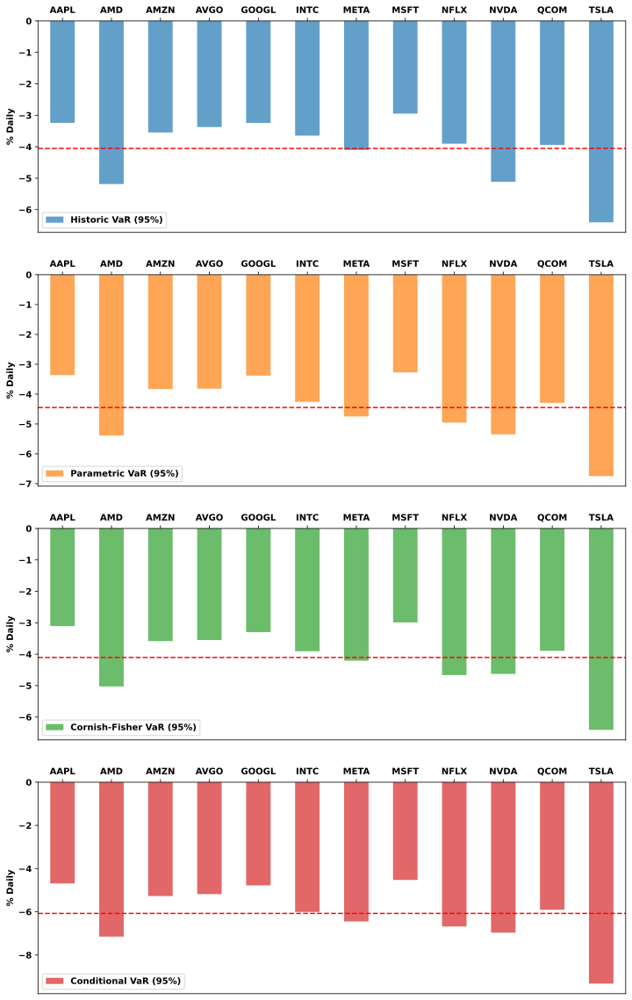

In [64]:
plot_Value_at_Risk(VaR_stocks, "daily") 

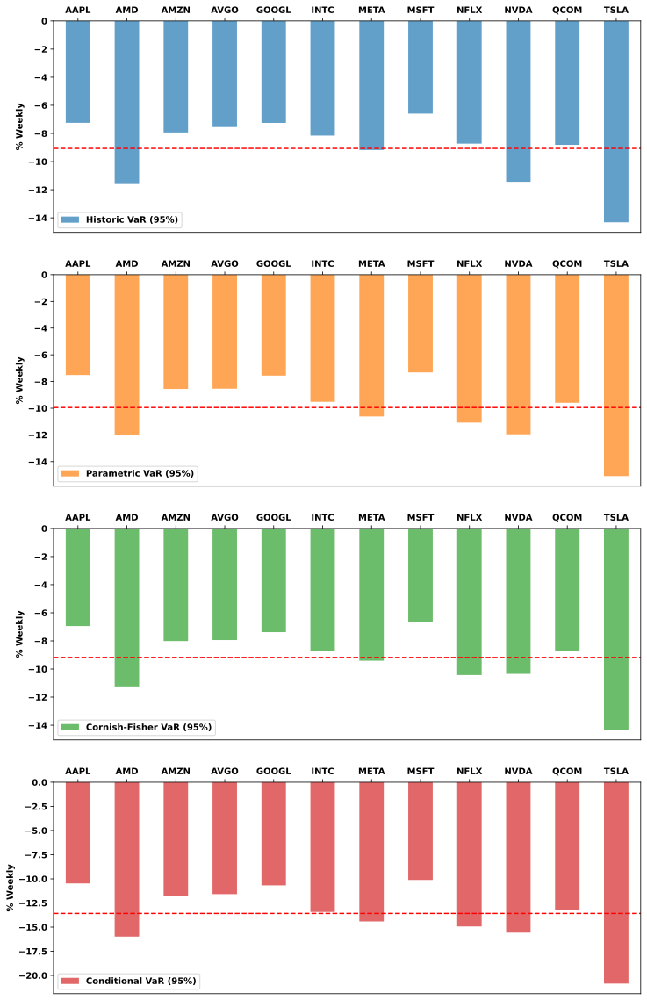

In [65]:
plot_Value_at_Risk(VaR_stocks, "weekly") 

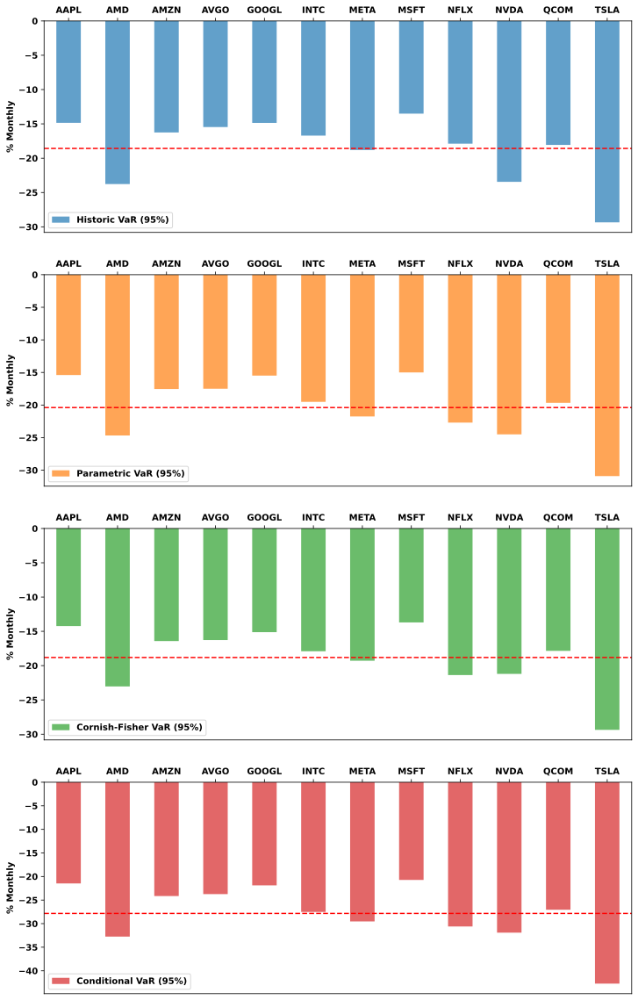

In [66]:
plot_Value_at_Risk(VaR_stocks, "monthly") 

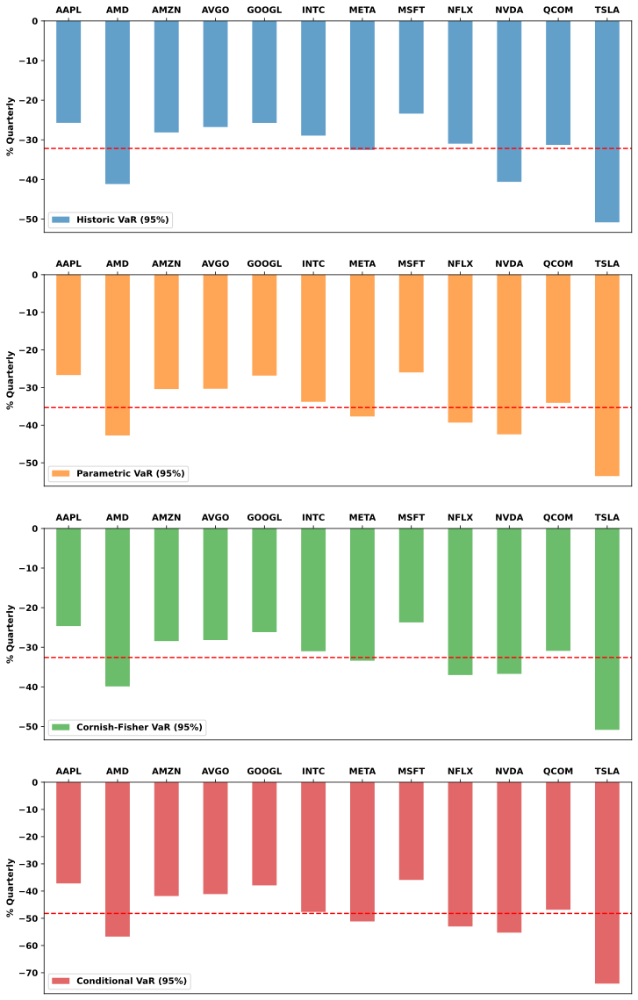

In [67]:
plot_Value_at_Risk(VaR_stocks, "quarterly") 

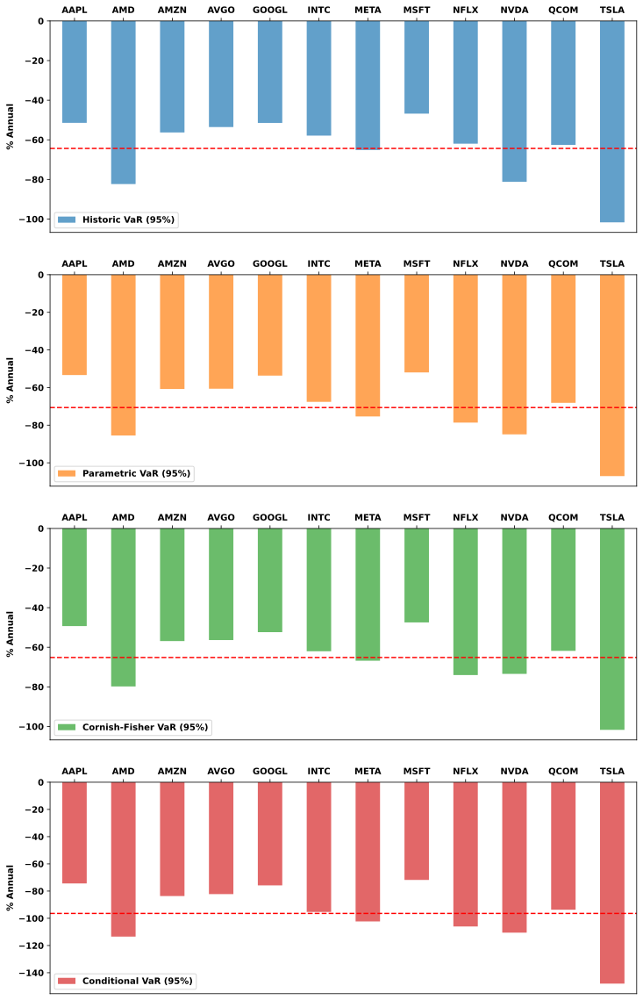

In [68]:
plot_Value_at_Risk(VaR_stocks) 

In [69]:
def plot_MC_sims(returns_df, n_days, n_simulations = 10_000) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    - n_days : int for the number of forward days to forecast
    - n_simulations : int for the number of random walks to simulate (10_000 by default)
    
    Returns :
    - None 
    
    Function :
    - Computes Monte Carlo simulations for the n_days forward return of each asset 
    - Sorts the simulated forward returns in ascending order 
    - Draws a line plot of the simulated forward returns for each asset 
    """
    assets = returns_df.columns
    n_assets = len(returns_df.columns)
    
    fig, ax = plt.subplots(n_assets, 1, figsize = (12, n_assets * 5))
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    
    for i, asset in enumerate(assets) :

        mean_return = returns_df[asset].mean( )
        std_dev = returns_df[asset].std( )
        simulated_returns = np.random.normal(mean_return, std_dev, n_simulations) * np.sqrt(n_days)
        sorted_simulated_returns = np.maximum(np.sort(simulated_returns), - 1)
        
        ax[i].plot(sorted_simulated_returns * 100, color = colors[i], label = asset)
        ax[i].set_xlabel("Simulation", fontsize = 12)
        ax[i].set_ylabel(f"{n_days}-Day Return (%)", fontsize = 12)
        ax[i].legend( )
    
    plt.style.use("default") 
    plt.show( )

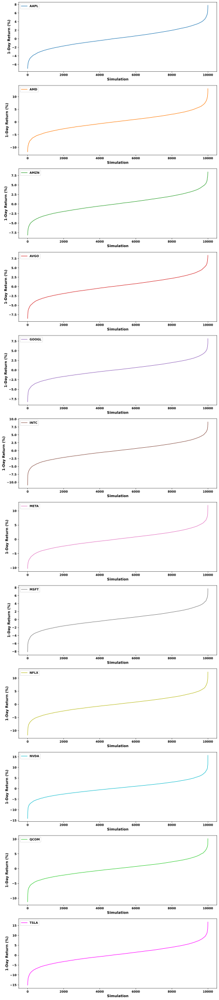

In [70]:
plot_MC_sims(returns[tickers], n_days = 1)

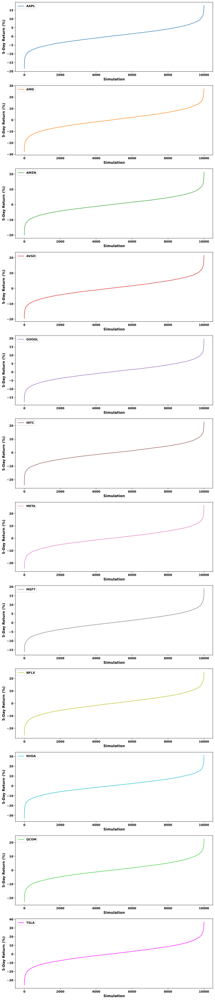

In [71]:
plot_MC_sims(returns[tickers], n_days = 5)

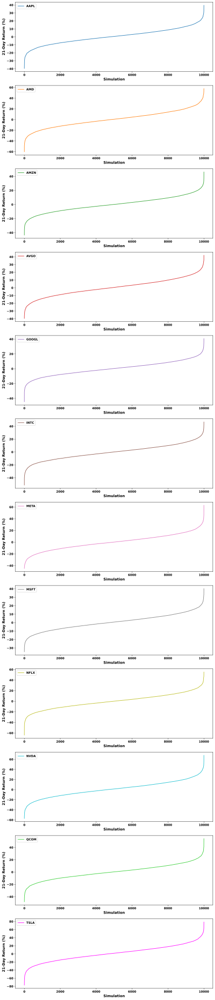

In [72]:
plot_MC_sims(returns[tickers], n_days = 21)

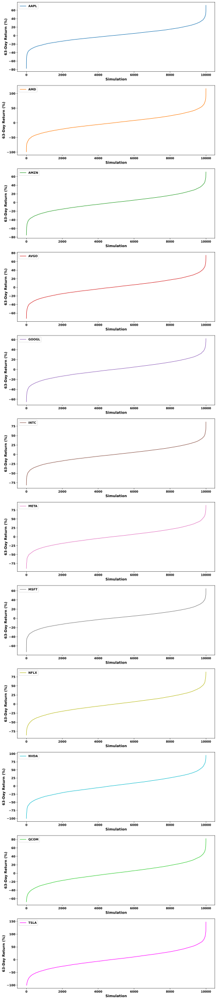

In [73]:
plot_MC_sims(returns[tickers], n_days = 63)

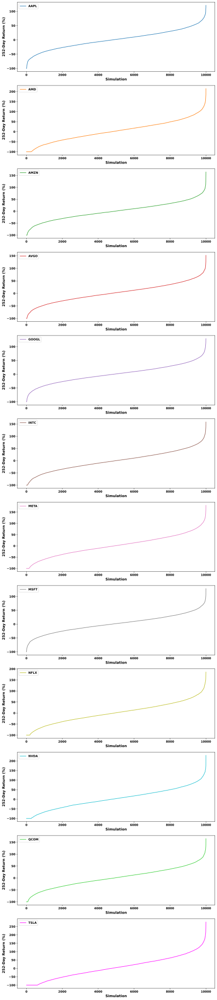

In [74]:
plot_MC_sims(returns[tickers], n_days = 252)

In [75]:
def plot_MC_worst_scenarios(returns_df, n_days, n_simulations = 10_000) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    - n_days : int for the number of forward days to forecast
    - n_simulations : int for the number of random walks to simulate (10_000 by default) 
    
    Returns :
    - None 
    
    Function :
    - Computes Monte Carlo simulations for the n_days forward price of each asset 
    - Plots the 5 simulations with the lowest ending value for each asset 
    """
    assets = returns_df.columns
    n_assets = len(returns_df.columns)
    
    if n_assets % 2 != 0 :
        n_rows = int(n_assets / 2) + 1
    else :
        n_rows = int(n_assets / 2)
    
    fig, ax = plt.subplots(n_rows, 2, figsize = (12, n_rows * 5))
    
    for i in range(n_rows) :
        for j in range(2) :
            if i + i + j <= n_assets - 1 :
                asset = assets[i + i + j]
                avg_return = returns_df[asset].mean( )
                vol = returns_df[asset].std( )
                
                if asset in tickers :
                    value_start = close_tech.iloc[-1, close_tech.columns.get_loc(asset)]
                else :
                    value_start = 10_000
                
                simulated_values = { }
                for s in range(n_simulations) :
                    rand_returns = np.random.normal(avg_return, vol, n_days) + 1
                    forecasted_values = value_start * (rand_returns).cumprod( )
                    simulated_values[s] = forecasted_values
                mc_df = pd.DataFrame(simulated_values)
                
                bottom_10_paths = mc_df.iloc[-1].nsmallest(5).index.tolist( )
                
                ax[i , j].plot(list(range(n_days)), mc_df[bottom_10_paths])
                ax[i , j].set_xlabel("Number of Forward Days", fontsize = 12)
                if (i + i + j) % 2 == 0 :
                    ax[i , j].set_ylabel("Asset Value ($)", fontsize = 12)
                else :
                    ax[i , j].set_ylabel("")
                ax[i , j].legend([asset], fontsize = 10)
                
    plt.style.use("default")
    plt.show( )

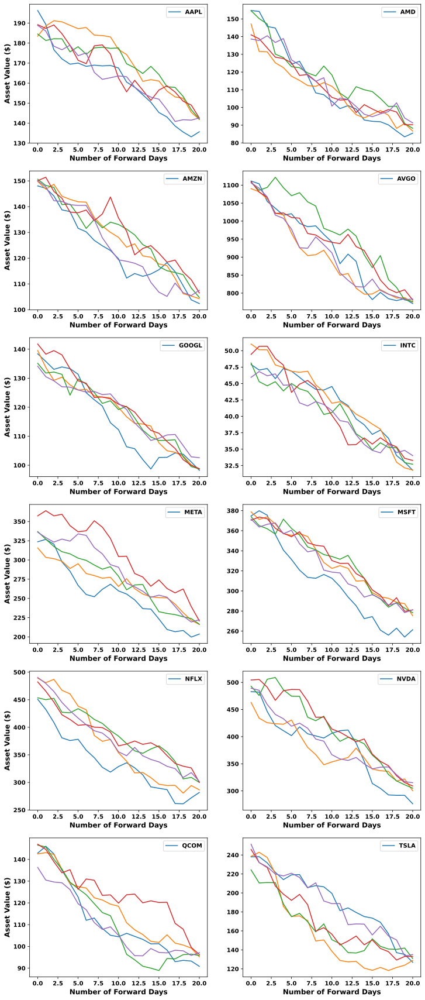

In [76]:
plot_MC_worst_scenarios(returns[tickers], n_days = 21)

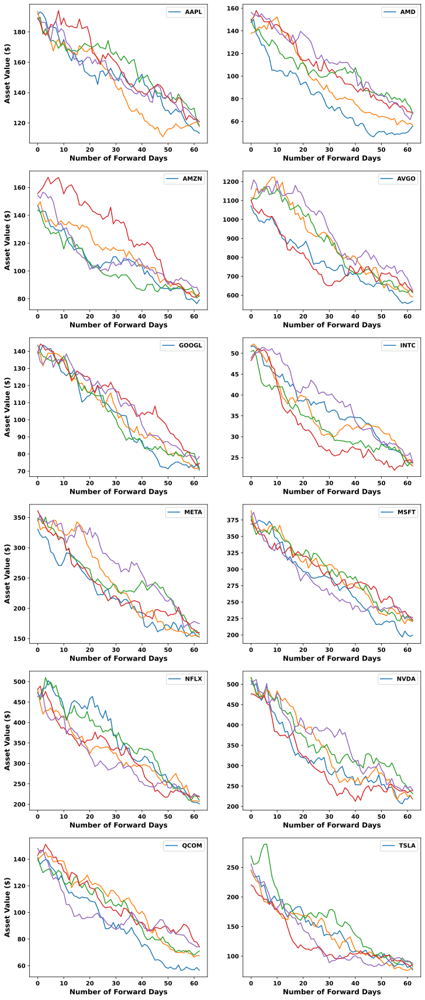

In [77]:
plot_MC_worst_scenarios(returns[tickers], n_days = 63)

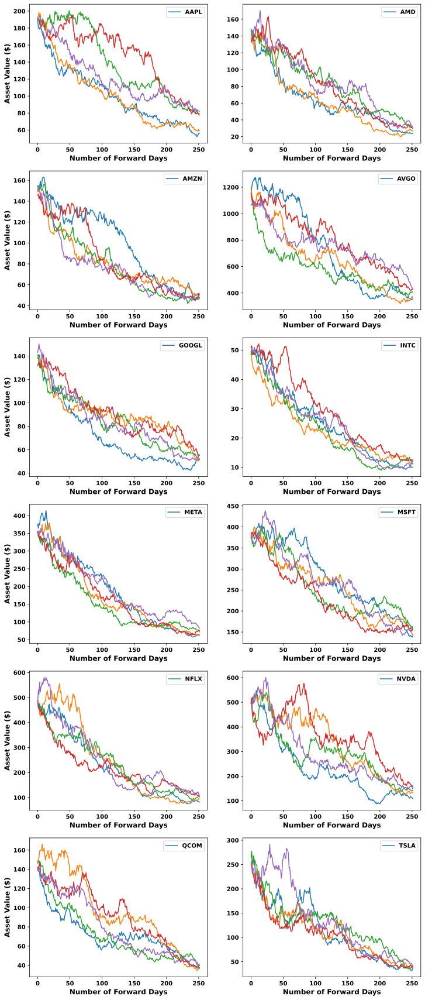

In [78]:
plot_MC_worst_scenarios(returns[tickers], n_days = 252)

$$
f(x; \xi, \mu, \sigma)_{GEV} = \frac{1}{\sigma} \left[1 + \xi \left(\frac{x - \mu}{\sigma}\right)\right]^{-1/\xi - 1} \exp \left\{-\left[1 + \xi \left(\frac{x - \mu}{\sigma}\right)\right]^{-1/\xi}\right\}
$$ 

$\text{Where :}$
- $ x \text{ is the random variable (daily returns).} $
- $ \xi \text{ is the shape.} $
- $ \mu \text{ is the location (central tendency).} $ 
- $ \sigma \text{ is the scale parameter (spread).} $ 

In [79]:
def plot_extreme_value_theory(returns_df) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - None 
    
    Function :
    - Fits a Generalized Extreme Value distribution to the daily returns of each asset 
    - Plots the GEV probability density curve for each asset 
    """
    assets = returns_df.columns
    n_assets = len(returns_df.columns)
    
    if n_assets % 2 != 0 :
        n_rows = int(n_assets / 2) + 1
    else :
        n_rows = int(n_assets / 2)
    
    fig, ax = plt.subplots(n_rows, 2, figsize = (12, n_rows * 5))
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    
    for i in range(n_rows) :
        for j in range(2) :
            if i + i + j <= n_assets - 1 :
                asset = assets[i + i + j]
                
                shape, loc, scale = stats.genextreme.fit(returns_df[asset])
                x = np.linspace(stats.genextreme.ppf(0.001, shape, loc = loc, scale = scale),
                                stats.genextreme.ppf(0.999, shape, loc = loc, scale = scale), 100)
                gev_pdf = stats.genextreme.pdf(x, shape, loc = loc, scale = scale)
                
                ax[i , j].plot(x, gev_pdf, color = colors[i + i + j])
                
                ax[i , j].set_xlabel("Daily Returns", fontsize = 12)
                if (i + i + j) % 2 == 0 :
                    ax[i , j].set_ylabel("Probability Density", fontsize = 12)
                else :
                    ax[i , j].set_ylabel("")
                legend_label = f"{asset}\nξ = {shape:.2f}\nμ = {loc:.2f}\nσ = {scale:.2f}"
                ax[i , j].legend([legend_label], fontsize = 10)
                
    plt.style.use("default")
    plt.show( )

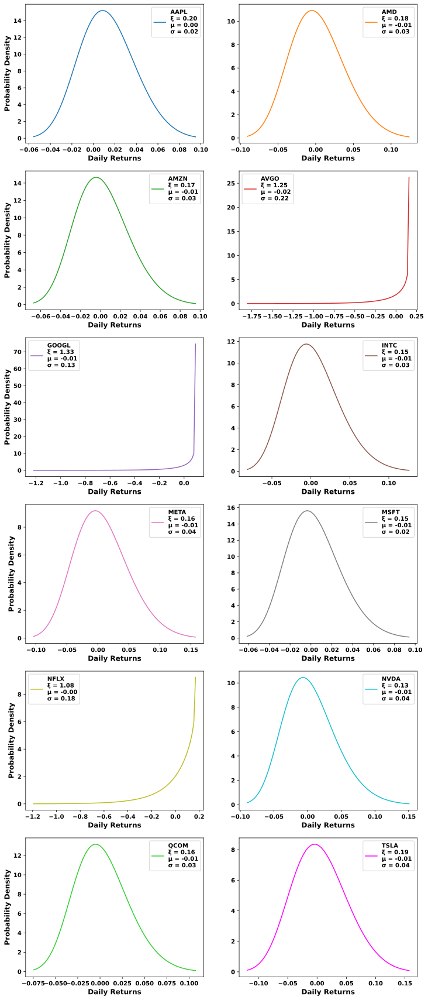

In [80]:
plot_extreme_value_theory(returns[tickers])

### 1.14 Price Crash Risk 
<a id="subsection-114"></a>

$$
\text{Annual Down-to-Up } \sigma = \log \left(\frac{(n_u - 1) \times \sum_{t=1}^{T} min(0, \text{Weekly Return}_t)^2}{(n_d - 1) \times \sum_{t=1}^{T} max(0, \text{Weekly Return}_t)^2}\right)
$$

$$
\text{Annual Negative Coefficient of Skewness} = -\frac{n \times (n - 1)^{3/2} \times \sum_{t=1}^{T} \text{Weekly Return}_t^3}{(n - 1) \times (n - 2) \times \left(\sum_{t=1}^{T} \text{Weekly Return}_t^2\right)^{3/2}}
$$

In [81]:
def price_crash_risk(returns_df) :
    """
    Arguments :
    - returns_df : DataFrame of daily returns 
    
    Returns :
    - crash_risk_df : DataFrame displaying ratios related to the risk of price crash
    
    Function :
    - For each year, computes the down-to-up volatility and negative coefficient of skewness 
    """
    weekly_returns = returns_df.resample("W-Fri").agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1) 
    
    annual_duvol_list = [  ]
    annual_ncskew_list = [  ]
    
    for asset in weekly_returns.columns :
        asset_returns = weekly_returns[asset].copy( )
        
        for year in weekly_returns.index.year.unique( ) :
            returns_in_year = asset_returns.loc[str(year)].copy( )
            mean_return = returns_in_year.mean( )
            
            up_returns = returns_in_year.loc[returns_in_year > mean_return]
            down_returns = returns_in_year.loc[returns_in_year < mean_return]
            n_up_weeks = len(up_returns)
            n_down_weeks = len(down_returns)
            sum_squared_up_returns = up_returns.pow(2).sum( )
            sum_squared_down_returns = down_returns.pow(2).sum( )
            
            annual_duvol = np.log(((n_down_weeks - 1) * sum_squared_down_returns) / ((n_up_weeks - 1) * sum_squared_up_returns))
            annual_duvol_list.append(annual_duvol)
            
            n_weeks = len(returns_in_year)
            sum_squared_returns = returns_in_year.pow(2).sum( )
            sum_cubed_returns = returns_in_year.pow(3).sum( )
            
            annual_ncskew = - ((n_weeks) * (n_weeks - 1)**(3/2) * sum_cubed_returns) / ((n_weeks - 1) * (n_weeks - 2) * (sum_squared_returns)**(3/2))
            annual_ncskew_list.append(annual_ncskew)
    
    multi_index = pd.MultiIndex.from_product([weekly_returns.columns, weekly_returns.index.year.unique( )], names = ["Ticker", "Year"])
    crash_risk_df = pd.DataFrame({"Down-to-Up Volatility" : annual_duvol_list, "Negative Coefficient of Skewness" : annual_ncskew_list}, 
                                 index = multi_index)
    crash_risk_df = crash_risk_df.unstack(level = "Year")
    return crash_risk_df 

In [82]:
crash_stocks = price_crash_risk(returns[tickers])

In [83]:
crash_stocks#.style\
            #.highlight_max(color = "lightgreen")

Down-to-Up Volatility                         \
Year                    2020    2021   2022    2023   
Ticker                                                
AAPL                 -0.5048 -0.8320 0.3126 -0.6338   
AMD                  -0.8729 -0.7591 0.4526 -1.1152   
AMZN                 -0.7731 -0.0801 0.5362 -1.0363   
AVGO                 -0.2245 -1.1056 0.1974 -1.4562   
GOOGL                -0.2778 -1.2191 0.5480 -0.7052   
INTC                 -0.0909 -0.3502 0.8002 -0.8832   
META                 -0.6025 -0.3544 0.4027 -1.6292   
MSFT                 -0.2557 -1.0028 0.3470 -1.2203   
NFLX                 -0.6441 -0.3712 0.1963 -0.5463   
NVDA                 -0.8296 -0.8827 0.4637 -1.5443   
QCOM                 -0.4566 -0.9159 0.3293 -0.4929   
TSLA                 -1.1551 -0.7173 0.6082 -0.9380   

       Negative Coefficient of Skewness                          
Year                               2020    2021    2022    2023  
Ticker                                                           
AAPL                             0.0242 -1.3030  0.1176 -0.4945  
AMD                             -1.1589 -1.0244  0.2084 -1.6345  
AMZN                            -1.0457 -0.0713  0.3265 -1.4104  
AVGO                            -0.1749 -1.8414  0.2398 -2.4895  
GOOGL                           -0.0521 -1.9637 -0.0291 -0.7789  
INTC                             0.5070 -0.3387  0.4209 -0.8736  
META                            -0.4663 -0.8032  0.4089 -2.0011  
MSFT                            -0.0799 -0.9105 -0.3815 -1.6462  
NFLX                            -0.9357 -0.5784  1.0429 -0.5172  
NVDA                            -1.2324 -0.9935 -0.0330 -1.8270  
QCOM                            -0.5626 -2.5101  0.2583 -0.4397  
TSLA                            -0.9049 -1.0167  0.3499 -1.3140

### 1.15 Liquidity Risk 
<a id="subsection-115"></a>

## 2. Construction of Portfolios 
<a id="section-2"></a>

In [84]:
def monthly_weights_rebalancing(weights_df) :
    """
    Arguments :
    - weights_df : DataFrame of weights of each asset at each timestamp 
    
    Returns :
    - daily_weights : DataFrame of daily weights of each asset  
        
    Function :
    - Sets the daily weights of each asset in each month equal to the weights of that month's first day 
    """
    daily_weights = weights_df.copy( ) 
    daily_weights["Year"] = daily_weights.index.year 
    daily_weights["Month"] = daily_weights.index.month 
    daily_weights = daily_weights.reset_index( )
    
    month_start_weights = daily_weights.groupby(["Year", "Month"]).first( ).reset_index(drop = True)
    daily_weights.set_index("Date", inplace = True)
    daily_weights.drop(columns = ["Year", "Month"], inplace = True)
    month_start_weights.set_index("Date", inplace = True)
    
    daily_weights.loc[~ (daily_weights.index.isin(month_start_weights.index)) ] = np.nan 
    daily_weights.ffill(inplace = True)  
    
    return daily_weights 

In [85]:
def plot_weights_returns(weights_df, returns_df, benchmarks = ["^GSPC", "^NDXT", "IXN"]) :
    """
    Arguments :
    - weights_df : DataFrame of weights of each asset at each timestamp 
    - returns_df : DataFrame of daily returns 
    - benchmarks : list of str representing the benchmarks' tickers 
    
    Returns :
    - None 
        
    Function :
    - Plots cumulative returns of the portfolio and benchmark indices 
    - Plots the annualized 3-month and 6-month rolling volatility of the portfolio 
    - Plots the weights of each asset over time -> price-weighted / market-value-weighted 
    - Plots the fixed weights of each asset -> equally-weighted / minimum variance / maximum sharpe 
    """
    fig , ax = plt.subplots(figsize = (12 , 24), sharex = False, sharey = False, nrows = 3, ncols = 1)
    
    for benchmark in benchmarks :
        compare = yf.download(tickers = benchmark, start = start_date, end = end_date)
        close_compare = compare["Adj Close"].copy( ) 
        returns_compare = close_compare.pct_change(periods = 1).iloc[1:] 
        returns_df[benchmark] = returns_compare
    
    cum_returns = (1 + returns_df).cumprod( ) - 1 
    cum_returns.mul(100).plot(fontsize = 10, ax = ax[0])
    ax[0].set_xlabel(xlabel = "")
    ax[0].set_ylabel(ylabel = "Cumulative Returns (%)", fontsize = 12) 
    returns_df.drop(columns = benchmarks, inplace = True)
    
    monthly_returns = returns_df.resample("BM").agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
    monthly_returns["3 Months"] = monthly_returns.iloc[: , 0].rolling(3).std( ) * np.sqrt(12)
    monthly_returns["6 Months"] = monthly_returns.iloc[: , 0].rolling(6).std( ) * np.sqrt(12)
    
    ax[1].plot(monthly_returns["3 Months"] * 100, label = "3 Months", c = "red")
    ax[1].plot(monthly_returns["6 Months"] * 100, label = "6 Months", c = "fuchsia")
    ax[1].set_xlabel(xlabel = "")
    ax[1].set_ylabel(ylabel = "Annualized Rolling Volatility (%)", fontsize = 12)
    ax[1].legend( )
    
    asset = returns_df.columns[0]
    if asset == "EWP" or "MVP" in asset or "MSP" in asset :
        weights_series = weights_df.iloc[0]
        weights_series.name = "Weights"
        
        contains_zero = weights_series.round(8).isin([0]).any( )
        if contains_zero : 
            weights_series = weights_series.loc[weights_series.round(8) != 0]
        
        colors = sns.color_palette("Set3")
        ax[2].pie(weights_series, labels = weights_series.index, colors = colors, autopct = "%.2f%%", radius = 1.2)
        
    else :
        colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
        for i, asset in enumerate(weights_df.columns) :
            ax[2].plot(weights_df[asset].mul(100), color = colors[i], label = asset)

        ax[2].set_xlabel(xlabel = "")
        ax[2].set_ylabel(ylabel = "Monthly Weights (%)", fontsize = 12)
        ax[2].legend( )
    
    plt.style.use("default")
    plt.show( )  

### 2.1 Price-Weighted Portfolio (Monthly Rebalancing) 
<a id="subsection-21"></a>

$$
\text{Weight}_t = \frac{\text{Price}_t}{\sum_{i=1}^{N} \text{Price}_{i,t}}
$$ 

$$
\text{PWP Return}_t = \sum_{i=1}^{N} \text{Return}_{i,t} \times \text{Weight}_{i,t}
$$ 

In [86]:
weights_PWP = monthly_weights_rebalancing( adj_close_tech.div(adj_close_tech.sum(axis = 1), axis = 0) )
returns["PWP"] = returns[tickers].mul(weights_PWP).sum(axis = 1)  

In [87]:
summary_PWP = risk_return(returns["PWP"].to_frame( )) 

best_worst_PWP = best_worst_returns(returns["PWP"].to_frame( ))

win_percent_PWP = win_percentage(returns["PWP"].to_frame( ))

win_loss_PWP = win_loss_ratios(returns["PWP"].to_frame( )) 

win_lose_streak_PWP = streak(returns["PWP"].to_frame( ))

dist_attributes_PWP = distribution_attributes(returns["PWP"].to_frame( ))

downside_PWP = downside(returns["PWP"].to_frame( )) 

tail_PWP = tail_attributes(returns["PWP"].to_frame( ), threshold = 0.05)

VaR_PWP = Value_at_Risk(returns["PWP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


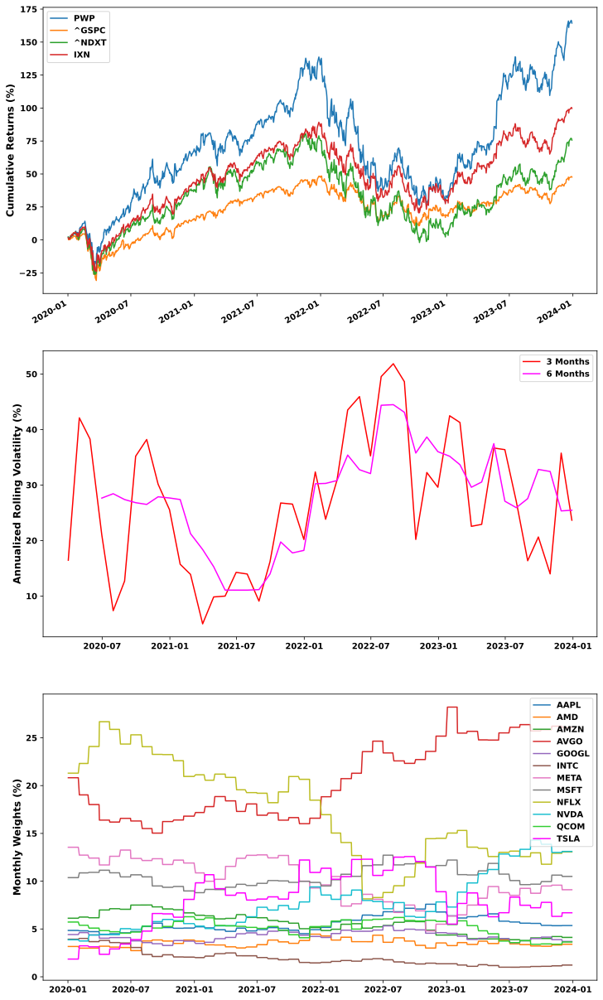

In [88]:
plot_weights_returns(weights_PWP, returns["PWP"].to_frame( )) 

### 2.2 Equally-Weighted Portfolio 
<a id="subsection-22"></a>

$$
\text{W}_t = \frac{1}{N}
$$ 

$$
\text{EWP Return}_t = \frac{1}{N} \times \sum_{i=1}^{N} \text{Return}_{i,t}
$$ 

In [89]:
weights_EWP = pd.DataFrame(np.full_like(returns[tickers].values, 1 / len(tickers)), columns = tickers, index = returns.index)
returns["EWP"] = returns[tickers].mul(weights_EWP).sum(axis = 1)  

In [90]:
summary_EWP = risk_return(returns["EWP"].to_frame( ))

best_worst_EWP = best_worst_returns(returns["EWP"].to_frame( ))

win_percent_EWP = win_percentage(returns["EWP"].to_frame( )) 

win_loss_EWP = win_loss_ratios(returns["EWP"].to_frame( )) 

win_lose_streak_EWP = streak(returns["EWP"].to_frame( ))

dist_attributes_EWP = distribution_attributes(returns["EWP"].to_frame( ))

downside_EWP = downside(returns["EWP"].to_frame( )) 

tail_EWP = tail_attributes(returns["EWP"].to_frame( ), threshold = 0.05)

VaR_EWP = Value_at_Risk(returns["EWP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


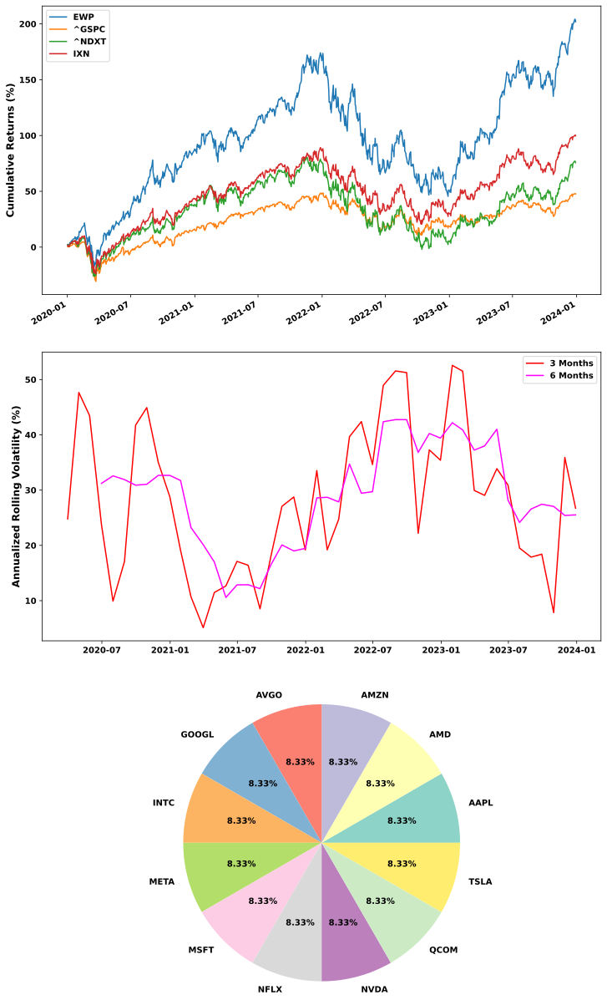

In [91]:
plot_weights_returns(weights_EWP, returns["EWP"].to_frame( ))

### 2.3 Market-Value-Weighted Portfolio (Monthly Rebalancing) 
<a id="subsection-23"></a>

$$
\text{Weight}_t = \frac{\text{Price}_t \times \text{Shares Oustanding}_t}{\sum_{i=1}^{N} \text{Price}_{i,t} \times \text{Shares Outstanding}_{i,t}}
$$ 

$$
\text{MVWP Return}_t = \sum_{i=1}^{N} \text{Return}_{i,t} \times \text{Weight}_{i,t}
$$ 

In [92]:
mkt_cap = shares_outstd_tech.iloc[1:].mul(close_tech.iloc[1:]) 
mkt_cap["MVWP"] = mkt_cap.sum(axis = 1)

weights_MVWP = monthly_weights_rebalancing( mkt_cap[tickers].div(mkt_cap["MVWP"], axis = 0) ) 
returns["MVWP"] = returns[tickers].mul(weights_MVWP).sum(axis = 1) 

In [93]:
summary_MVWP = risk_return(returns["MVWP"].to_frame( ))

best_worst_MVWP = best_worst_returns(returns["MVWP"].to_frame( ))

win_percent_MVWP = win_percentage(returns["MVWP"].to_frame( )) 

win_loss_MVWP = win_loss_ratios(returns["MVWP"].to_frame( )) 

win_lose_streak_MVWP = streak(returns["MVWP"].to_frame( ))

dist_attributes_MVWP = distribution_attributes(returns["MVWP"].to_frame( ))

downside_MVWP = downside(returns["MVWP"].to_frame( )) 

tail_MVWP = tail_attributes(returns["MVWP"].to_frame( ), threshold = 0.05)

VaR_MVWP = Value_at_Risk(returns["MVWP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


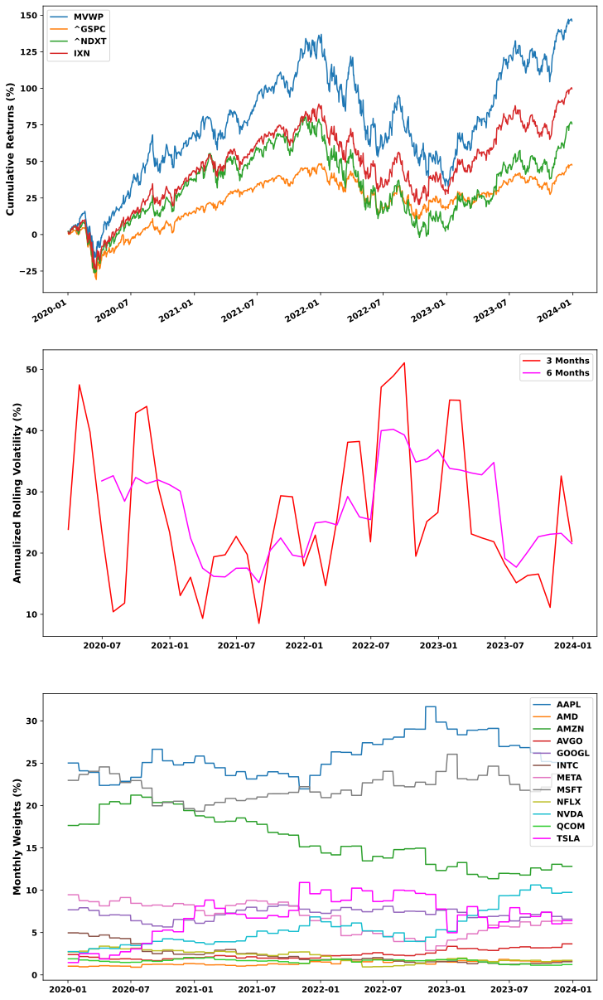

In [94]:
plot_weights_returns(weights_MVWP, returns["MVWP"].to_frame( )) 

### 2.4 Inverse Volatility Portfolio (Monthly Rebalancing) 
<a id="subsection-24"></a>

$$
\text{Weight}_t = \frac{\frac{1}{\sigma_t}}{\sum_{i=1}^{N} \frac{1}{\sigma_{i, t}}}
$$ 

$$
\text{IVP Return}_t = \sum_{i=1}^{N} \text{Return}_{i,t} \times \text{Weight}_{i,t}
$$ 

In [95]:
rolling_vol = returns[tickers].rolling(window = 21).std( )
inverse_vol = 1 / rolling_vol

weights_IVP = monthly_weights_rebalancing( inverse_vol.div(inverse_vol.sum(axis = 1), axis = 0) )
returns["IVP"] = returns[tickers].mul(weights_IVP).sum(axis = 1)  

In [96]:
summary_IVP = risk_return(returns["IVP"].to_frame( ))

best_worst_IVP = best_worst_returns(returns["IVP"].to_frame( ))

win_percent_IVP = win_percentage(returns["IVP"].to_frame( )) 

win_loss_IVP = win_loss_ratios(returns["IVP"].to_frame( )) 

win_lose_streak_IVP = streak(returns["IVP"].to_frame( ))

dist_attributes_IVP = distribution_attributes(returns["IVP"].to_frame( ))

downside_IVP = downside(returns["IVP"].to_frame( )) 

tail_IVP = tail_attributes(returns["IVP"].to_frame( ), threshold = 0.05)

VaR_IVP = Value_at_Risk(returns["IVP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


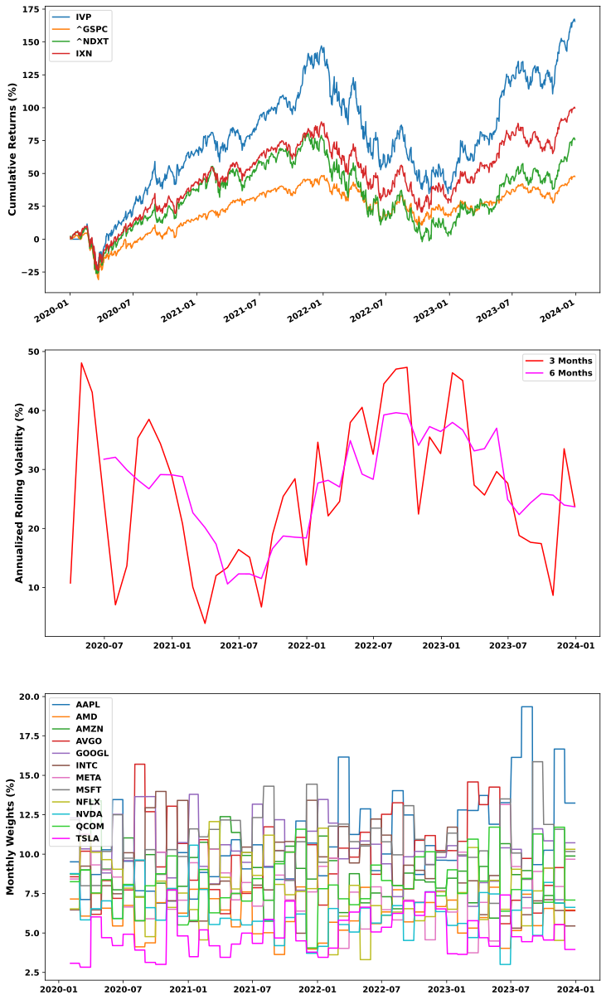

In [97]:
plot_weights_returns(weights_IVP, returns["IVP"].to_frame( )) 

### 2.5 Random-Weighted Portfolios
<a id="subsection-25"></a>

In [98]:
num_portfs = 10_000  
rand_portfs_weights = np.random.random(num_portfs * len(tickers)).reshape(num_portfs, len(tickers))

sum_weights = rand_portfs_weights.sum(axis = 1, keepdims = True)
rand_portfs_weights = rand_portfs_weights / sum_weights

In [99]:
rand_portfs_returns = returns[tickers].dot(rand_portfs_weights.transpose( ))
rand_portfs_summary = risk_return(rand_portfs_returns)

In [100]:
rand_portfs_summary

Daily                   Weekly                   Monthly             \
     Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
0    0.0013     0.0212 0.0626 0.0066     0.0474 0.1400  0.0279     0.0972   
1    0.0013     0.0208 0.0621 0.0065     0.0466 0.1389  0.0272     0.0955   
2    0.0015     0.0226 0.0683 0.0077     0.0505 0.1527  0.0324     0.1036   
3    0.0015     0.0216 0.0696 0.0075     0.0483 0.1557  0.0316     0.0990   
4    0.0013     0.0214 0.0619 0.0066     0.0478 0.1385  0.0278     0.0979   
...     ...        ...    ...    ...        ...    ...     ...        ...   
9995 0.0013     0.0214 0.0614 0.0066     0.0479 0.1373  0.0276     0.0981   
9996 0.0013     0.0216 0.0599 0.0065     0.0484 0.1339  0.0272     0.0992   
9997 0.0014     0.0215 0.0647 0.0070     0.0481 0.1447  0.0292     0.0986   
9998 0.0014     0.0217 0.0636 0.0069     0.0484 0.1422  0.0289     0.0993   
9999 0.0015     0.0225 0.0673 0.0076     0.0504 0.1504  0.0318     0.1033   

            Quarterly                   Annual                    
     Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
0    0.2869    0.0837     0.1684 0.4970 0.3347     0.3367 0.9939  
1    0.2847    0.0815     0.1654 0.4931 0.3262     0.3307 0.9862  
2    0.3130    0.0972     0.1794 0.5421 0.3889     0.3587 1.0842  
3    0.3190    0.0948     0.1715 0.5525 0.3791     0.3431 1.1051  
4    0.2838    0.0834     0.1696 0.4916 0.3335     0.3392 0.9832  
...     ...       ...        ...    ...    ...        ...    ...  
9995 0.2815    0.0829     0.1700 0.4875 0.3315     0.3400 0.9750  
9996 0.2745    0.0817     0.1718 0.4754 0.3267     0.3437 0.9508  
9997 0.2966    0.0877     0.1707 0.5136 0.3508     0.3415 1.0273  
9998 0.2914    0.0868     0.1719 0.5048 0.3471     0.3439 1.0095  
9999 0.3083    0.0955     0.1788 0.5340 0.3820     0.3577 1.0680  

[10000 rows x 15 columns]

### 2.6 Global Minimum (Annualized) Variance Portfolio 
<a id="subsection-26"></a>

In [101]:
weights_MVP = rand_portfs_weights[rand_portfs_summary[("Annual",  "Volatility")].pow(2).idxmin( )]
weights_MVP = pd.DataFrame(np.tile(weights_MVP, (len(returns[tickers]), 1)), columns = tickers, index = returns.index)
returns["MVP"] = rand_portfs_returns[rand_portfs_summary[("Annual",  "Volatility")].pow(2).idxmin( )]

In [102]:
summary_MVP = risk_return(returns["MVP"].to_frame( ))

best_worst_MVP = best_worst_returns(returns["MVP"].to_frame( ))

win_percent_MVP = win_percentage(returns["MVP"].to_frame( ))  

win_loss_MVP = win_loss_ratios(returns["MVP"].to_frame( )) 

win_lose_streak_MVP = streak(returns["MVP"].to_frame( ))

dist_attributes_MVP = distribution_attributes(returns["MVP"].to_frame( ))

downside_MVP = downside(returns["MVP"].to_frame( ))  

tail_MVP = tail_attributes(returns["MVP"].to_frame( ), threshold = 0.05)

VaR_MVP = Value_at_Risk(returns["MVP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


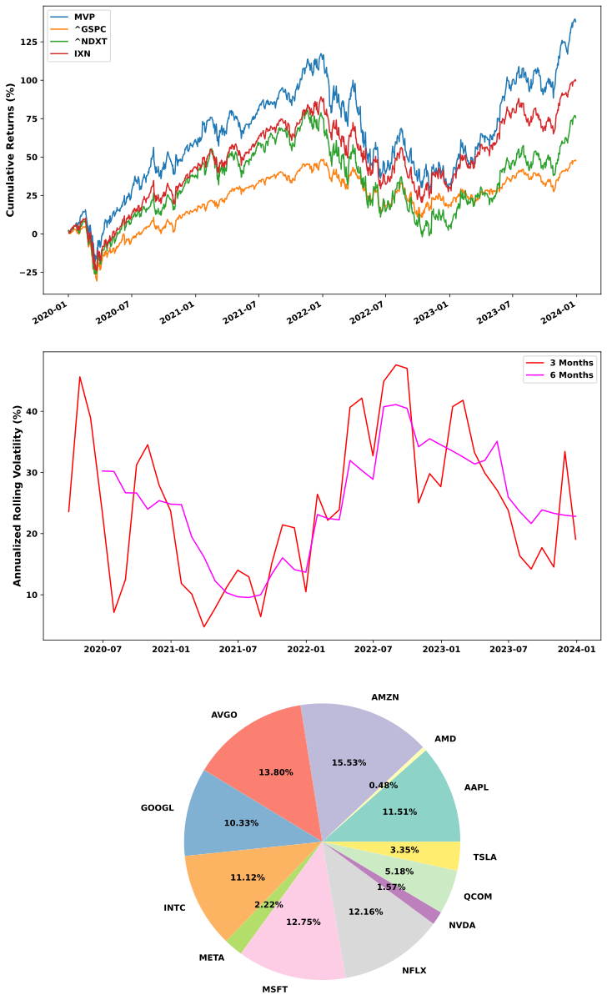

In [103]:
plot_weights_returns(weights_MVP, returns["MVP"].to_frame( ))

### 2.7 Maximum (Annualized) Sharpe Portfolio 
<a id="subsection-27"></a>

In [104]:
weights_MSP = rand_portfs_weights[rand_portfs_summary[("Annual", "Sharpe")].idxmax( )]
weights_MSP = pd.DataFrame(np.tile(weights_MSP, (len(returns[tickers]), 1)), columns = tickers, index = returns.index)
returns["MSP"] = rand_portfs_returns[rand_portfs_summary[("Annual", "Sharpe")].idxmax( )]  

In [105]:
summary_MSP = risk_return(returns["MSP"].to_frame( )) 

best_worst_MSP = best_worst_returns(returns["MSP"].to_frame( )) 

win_percent_MSP = win_percentage(returns["MSP"].to_frame( ))  

win_loss_MSP = win_loss_ratios(returns["MSP"].to_frame( )) 

win_lose_streak_MSP = streak(returns["MSP"].to_frame( ))

dist_attributes_MSP = distribution_attributes(returns["MSP"].to_frame( ))

downside_MSP = downside(returns["MSP"].to_frame( ))  

tail_MSP = tail_attributes(returns["MSP"].to_frame( ), threshold = 0.05)

VaR_MSP = Value_at_Risk(returns["MSP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


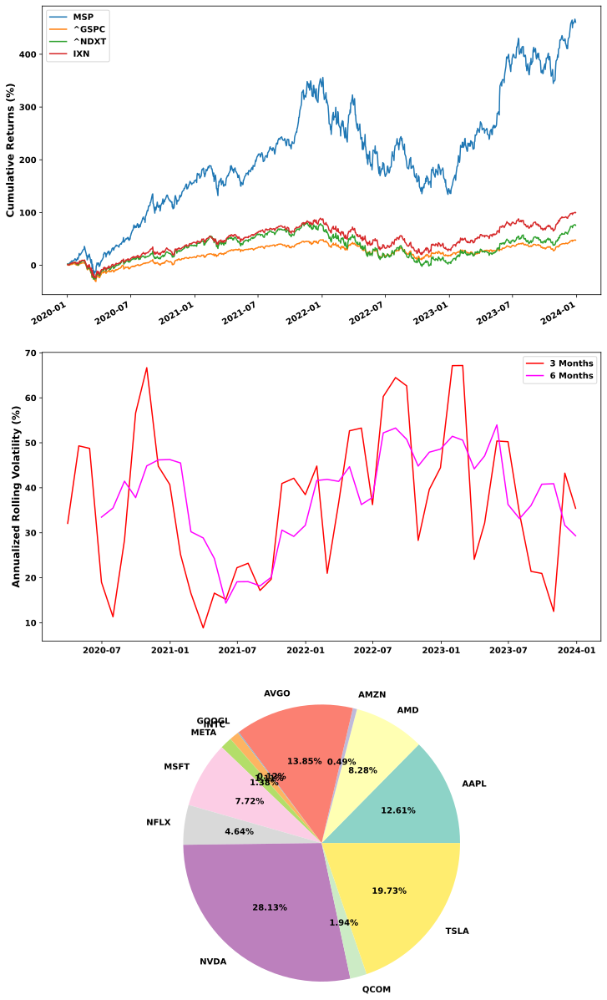

In [106]:
plot_weights_returns(weights_MSP, returns["MSP"].to_frame( ))

### 2.8 Variance Minimization using Scipy
<a id="subsection-28"></a>

In [107]:
ann_returns = returns[tickers].mean( ) * 252 
cov_mat = returns[tickers].cov( )  * 252 

In [108]:
def compute_variance(weights) :
    portf_var = np.dot(weights.T, np.dot(cov_mat, weights)) 
    return portf_var 

In [109]:
def optimize_metric(cov_mat, func) :
    constraints = ({'type': 'eq', 'fun': lambda weights: np.sum(weights) - 1})
    bounds = tuple((0, 1) for asset in range(len(cov_mat)))
    initial_weights = np.ones(len(cov_mat)) / len(cov_mat)
    
    result = optimize.minimize(func, initial_weights, method = "SLSQP", bounds = bounds, constraints = constraints)
    optimized_weights = result.x
    return optimized_weights 

In [110]:
sp_weights_MVP = optimize_metric(cov_mat, compute_variance) 
sp_weights_MVP = pd.DataFrame(np.tile(sp_weights_MVP, (len(returns[tickers]), 1)), columns = tickers, index = returns.index)

sp_returns_MVP = returns[tickers].mul(sp_weights_MVP).sum(axis = 1)
sp_returns_MVP = pd.DataFrame(data = sp_returns_MVP, columns = ["scipy_MVP"])

In [111]:
summary_sp_MVP = risk_return(sp_returns_MVP["scipy_MVP"].to_frame( )) 
MVP_comparison = pd.concat(axis = 0, objs = [summary_MVP, summary_sp_MVP])

In [112]:
MVP_comparison

Daily                   Weekly                   Monthly  \
          Return Volatility Sharpe Return Volatility Sharpe  Return   
MVP       0.0011     0.0195 0.0540 0.0053     0.0436 0.1208  0.0221   
scipy_MVP 0.0010     0.0187 0.0518 0.0048     0.0418 0.1157  0.0203   

                            Quarterly                   Annual             \
          Volatility Sharpe    Return Volatility Sharpe Return Volatility   
MVP           0.0893 0.2476    0.0664     0.1547 0.4288 0.2654     0.3095   
scipy_MVP     0.0856 0.2372    0.0609     0.1483 0.4108 0.2437     0.2966   

                  
          Sharpe  
MVP       0.8577  
scipy_MVP 0.8217

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


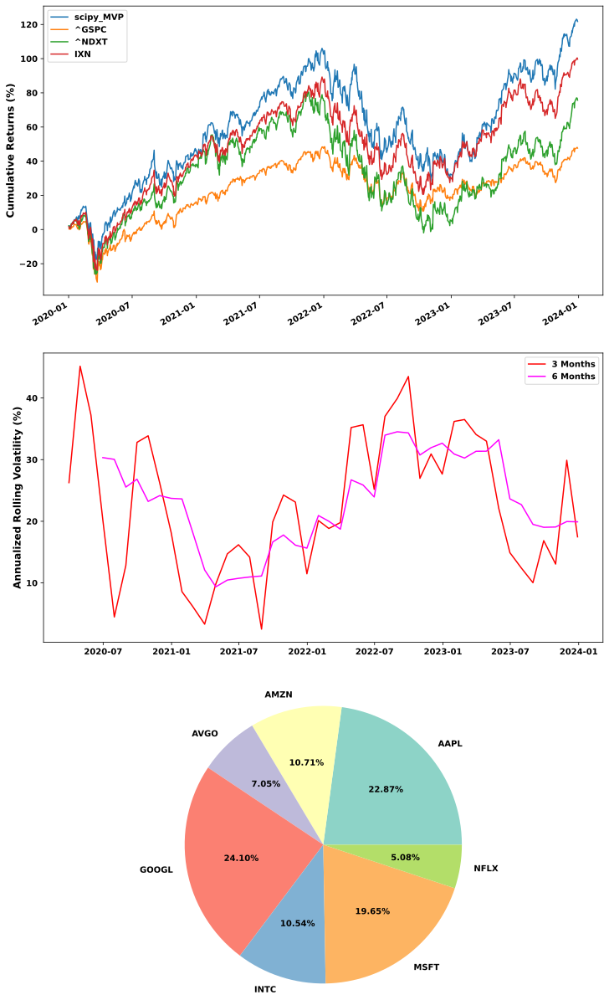

In [113]:
plot_weights_returns(sp_weights_MVP, sp_returns_MVP["scipy_MVP"].to_frame( ))

### 2.9 Sharpe Maximization using Scipy
<a id="subsection-29"></a>

In [114]:
def compute_sharpe(weights):
    portf_return = np.sum(weights * ann_returns)
    portf_std = np.sqrt(np.dot(weights.T, np.dot(cov_mat, weights)))
    sharpe = (portf_return - rf_rate) / portf_std
    return - sharpe 

In [115]:
sp_weights_MSP = optimize_metric(cov_mat, compute_sharpe) 
sp_weights_MSP = pd.DataFrame(np.tile(sp_weights_MSP, (len(returns[tickers]), 1)), columns = tickers, index = returns.index)

sp_returns_MSP = returns[tickers].mul(sp_weights_MSP).sum(axis = 1)
sp_returns_MSP = pd.DataFrame(data = sp_returns_MSP, columns = ["scipy_MSP"])

In [116]:
summary_sp_MSP = risk_return(sp_returns_MSP["scipy_MSP"].to_frame( )) 
MSP_comparison = pd.concat(axis = 0, objs = [summary_MSP, summary_sp_MSP])

In [117]:
MSP_comparison

Daily                   Weekly                   Monthly  \
          Return Volatility Sharpe Return Volatility Sharpe  Return   
MSP       0.0020     0.0253 0.0804 0.0102     0.0567 0.1798  0.0428   
scipy_MSP 0.0028     0.0321 0.0870 0.0140     0.0718 0.1945  0.0586   

                            Quarterly                   Annual             \
          Volatility Sharpe    Return Volatility Sharpe Return Volatility   
MSP           0.1161 0.3685    0.1284     0.2011 0.6382 0.5134     0.4023   
scipy_MSP     0.1471 0.3986    0.1759     0.2548 0.6904 0.7037     0.5096   

                  
          Sharpe  
MSP       1.2764  
scipy_MSP 1.3809

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


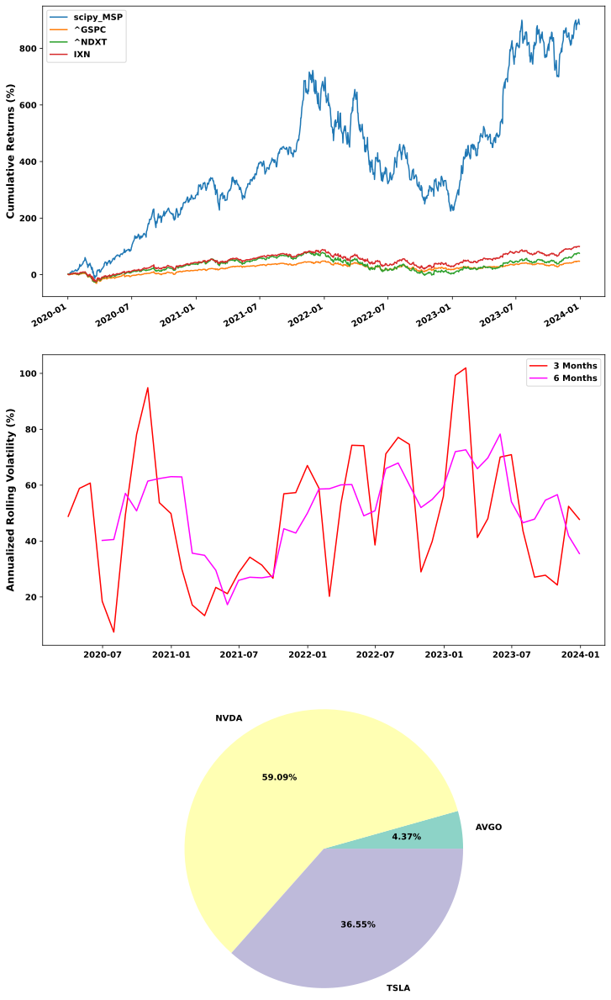

In [118]:
plot_weights_returns(sp_weights_MSP, sp_returns_MSP["scipy_MSP"].to_frame( ))

### 2.10 Portfolio Comparison : Performance against Benchmark 
<a id="subsection-210"></a>

In [119]:
portfs = ["PWP", "EWP", "MVWP", "IVP", "MVP", "MSP"]

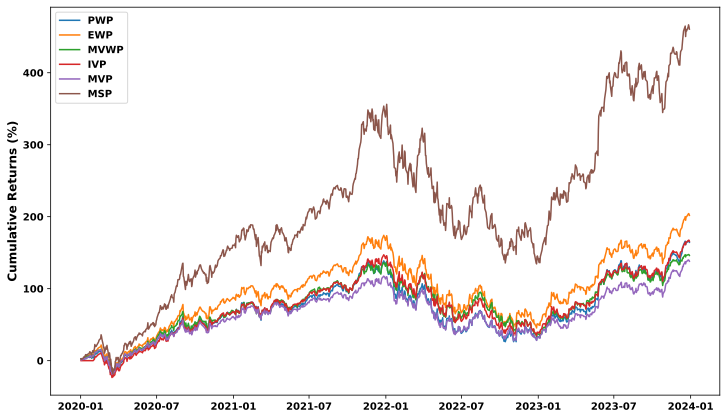

In [120]:
plot_cum_returns(returns[portfs])

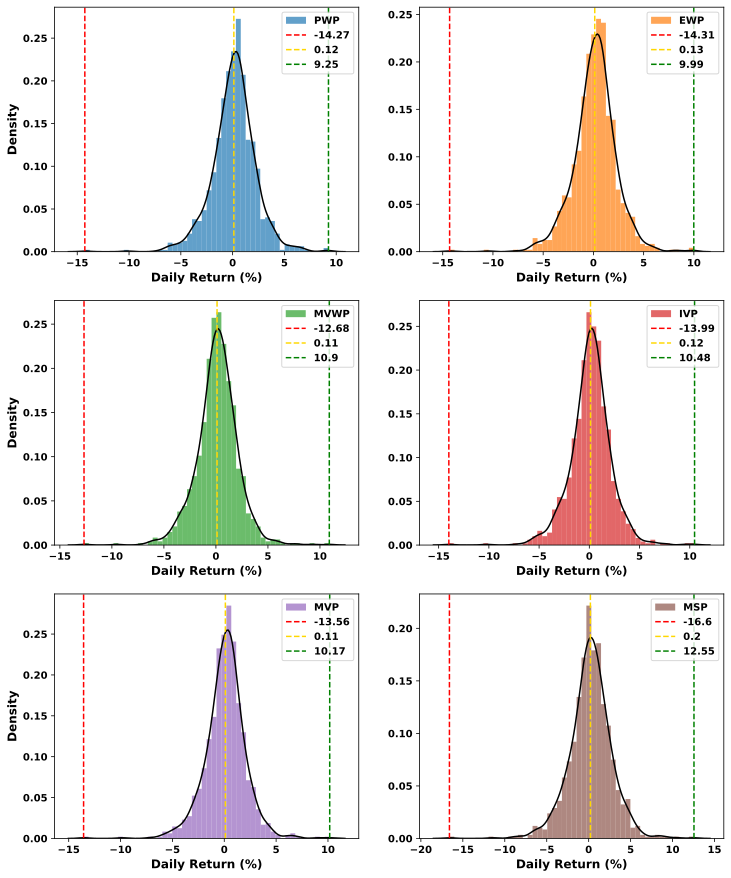

In [121]:
plot_histogram(returns[portfs])

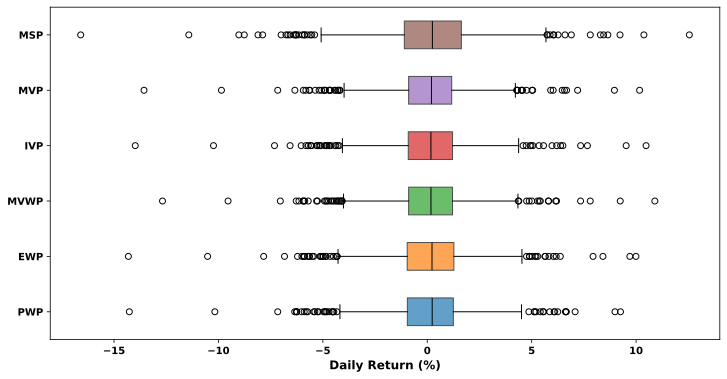

In [122]:
plot_box_whisker(returns[portfs])  

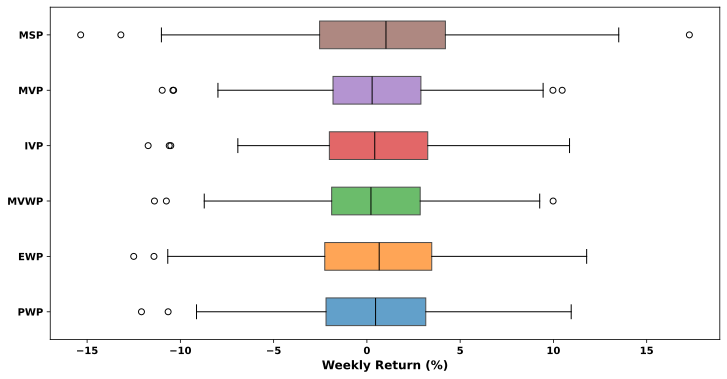

In [123]:
plot_box_whisker(returns[portfs], "weekly")  

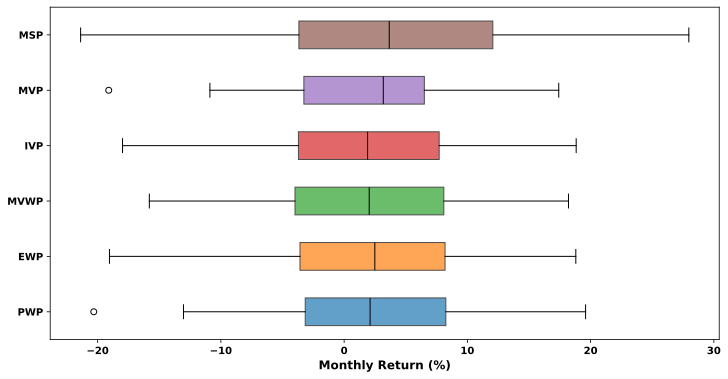

In [124]:
plot_box_whisker(returns[portfs], "monthly")  

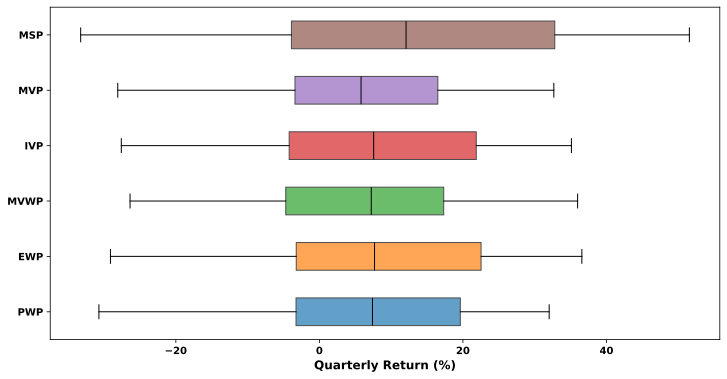

In [125]:
plot_box_whisker(returns[portfs], "quarterly")  

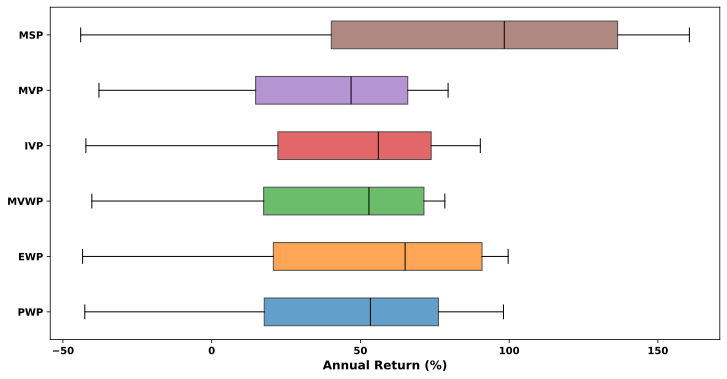

In [126]:
plot_box_whisker(returns[portfs], "annual")  

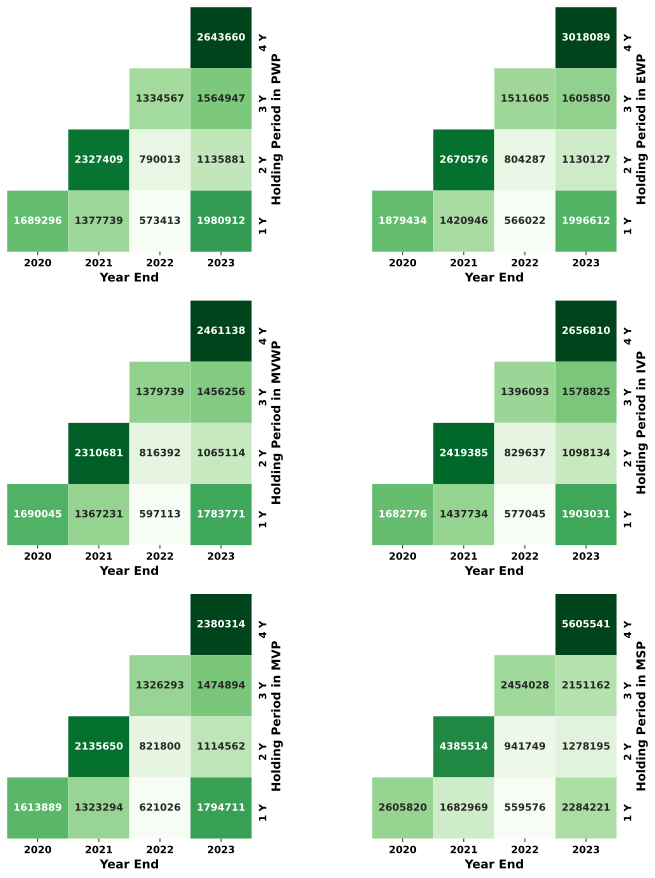

In [127]:
plot_dollar_triangle(returns[portfs])

In [128]:
summary_portfs = pd.concat(objs = [summary_PWP, summary_EWP, summary_MVWP, summary_IVP, summary_MVP, summary_MSP], axis = 0)

best_worst_portfs = pd.concat(objs = [best_worst_PWP, best_worst_EWP, best_worst_MVWP, best_worst_IVP, best_worst_MVP, best_worst_MSP], axis = 0)

win_percent_portfs = pd.concat(objs = [win_percent_PWP, win_percent_EWP, win_percent_MVWP, win_percent_IVP, win_percent_MVP, win_percent_MSP], axis = 0)

win_loss_portfs = pd.concat(objs = [win_loss_PWP, win_loss_EWP, win_loss_MVWP, win_loss_IVP, win_loss_MVP, win_loss_MSP], axis = 0)

win_lose_streak_portfs = pd.concat(objs = [win_lose_streak_PWP, win_lose_streak_EWP, win_lose_streak_MVWP, win_lose_streak_IVP, win_lose_streak_MVP, win_lose_streak_MSP], axis = 0)

dist_attributes_portfs = pd.concat(objs = [dist_attributes_PWP, dist_attributes_EWP, dist_attributes_MVWP, dist_attributes_IVP, dist_attributes_MVP, dist_attributes_MSP], axis = 0)

downside_portfs = pd.concat(objs = [downside_PWP, downside_EWP, downside_MVWP, downside_IVP, downside_MVP, downside_MSP], axis = 0) 

tail_portfs = pd.concat(objs = [tail_PWP, tail_EWP, tail_MVWP, tail_IVP, tail_MVP, tail_MSP], axis = 0) 

VaR_portfs = pd.concat(objs = [VaR_PWP, VaR_EWP, VaR_MVWP, VaR_IVP, VaR_MVP, VaR_MSP], axis = 0) 

In [129]:
summary_portfs#.style\
              #.highlight_max(color = "lightgreen")\
              #.highlight_min(color = "lightcoral")

Daily                   Weekly                   Monthly             \
     Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
PWP  0.0012     0.0211 0.0564 0.0060     0.0472 0.1261  0.0250     0.0967   
EWP  0.0013     0.0214 0.0621 0.0066     0.0479 0.1388  0.0279     0.0981   
MVWP 0.0011     0.0200 0.0549 0.0055     0.0446 0.1227  0.0230     0.0915   
IVP  0.0012     0.0204 0.0579 0.0059     0.0456 0.1295  0.0248     0.0934   
MVP  0.0011     0.0195 0.0540 0.0053     0.0436 0.1208  0.0221     0.0893   
MSP  0.0020     0.0253 0.0804 0.0102     0.0567 0.1798  0.0428     0.1161   

            Quarterly                   Annual                    
     Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
PWP  0.2585    0.0750     0.1675 0.4478 0.3000     0.3350 0.8955  
EWP  0.2844    0.0837     0.1700 0.4926 0.3349     0.3399 0.9852  
MVWP 0.2514    0.0690     0.1585 0.4355 0.2760     0.3169 0.8710  
IVP  0.2653    0.0744     0.1618 0.4596 0.2975     0.3236 0.9192  
MVP  0.2476    0.0664     0.1547 0.4288 0.2654     0.3095 0.8577  
MSP  0.3685    0.1284     0.2011 0.6382 0.5134     0.4023 1.2764

In [130]:
best_worst_portfs#.style\
                 #.highlight_max(color = "lightgreen")\
                 #.highlight_min(color = "lightcoral")

Daily                   Weekly                  Monthly  \
     Best Return Worst Return Best Return Worst Return Best Return   
PWP       0.0925      -0.1427      0.1095      -0.1209      0.1959   
EWP       0.0999      -0.1431      0.1178      -0.1250      0.1880   
MVWP      0.1090      -0.1268      0.0998      -0.1139      0.1820   
IVP       0.1048      -0.1399      0.1086      -0.1173      0.1883   
MVP       0.1017      -0.1356      0.1047      -0.1097      0.1741   
MSP       0.1255      -0.1660      0.1729      -0.1534      0.2797   

                    Quarterly                   Annual               
     Worst Return Best Return Worst Return Best Return Worst Return  
PWP       -0.2031      0.3201      -0.3072      0.9809      -0.4266  
EWP       -0.1904      0.3657      -0.2911      0.9966      -0.4340  
MVWP      -0.1581      0.3598      -0.2638      0.7838      -0.4029  
IVP       -0.1798      0.3511      -0.2760      0.9030      -0.4230  
MVP       -0.1910      0.3266      -0.2809      0.7947      -0.3790  
MSP       -0.2138      0.5155      -0.3326      1.6058      -0.4404

In [131]:
win_percent_portfs

,% of Winning Days,% of Winning Weeks,% of Winning Months,% of Winning Quarters,% of Winning Years
PWP,55.1690,56.4593,60.4167,62.5000,75.0000
EWP,54.9702,55.5024,62.5000,62.5000,75.0000
MVWP,54.3738,53.5885,60.4167,62.5000,75.0000
IVP,53.8767,53.5885,62.5000,62.5000,75.0000
MVP,54.5726,54.5455,62.5000,62.5000,75.0000
MSP,55.4672,54.5455,58.3333,62.5000,75.0000


In [132]:
win_loss_portfs#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral")

Daily                                            Weekly  \
     Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio   
PWP           1.1671        0.9484              7.8991          1.4063   
EWP           1.1854        0.9710              8.5971          1.4511   
MVWP          1.1629        0.9758              7.6171          1.4012   
IVP           1.1748        0.9602              5.8411          1.4288   
MVP           1.1613        0.9667              7.5789          1.4006   
MSP           1.2458        1.0002             10.9436          1.6007   

                                               Monthly                \
     Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio   
PWP         1.0845             16.3110          2.0408        1.3371   
EWP         1.1634             17.2541          2.1376        1.2826   
MVWP        1.2135             15.3439          1.9357        1.2682   
IVP         1.1736             14.0432          2.0596        1.1671   
MVP         1.1672             15.6010          1.9686        1.1812   
MSP         1.3340             20.4705          2.5364        1.8117   

                               Quarterly                                    \
     Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)   
PWP              30.8119          3.1309        1.8785             42.5374   
EWP              33.2615          3.4504        2.0702             44.3859   
MVWP             29.2048          3.0029        1.8018             41.6871   
IVP              30.3694          2.9860        1.7916             41.5688   
MVP              30.7523          3.1162        1.8697             42.4437   
MSP              35.3352          5.0419        3.0252             50.1039   

              Annual                                    
     Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)  
PWP           4.8008        1.6003             59.3775  
EWP           5.2929        1.7643             60.8300  
MVWP          4.5696        1.5232             58.5873  
IVP           4.7843        1.5948             59.3237  
MVP           4.5700        1.5233             58.5885  
MSP           8.1127        2.7042             65.7552

In [133]:
win_lose_streak_portfs 

Longest Winning Streak                             Longest Losing Streak  \
                       Days Weeks Months Quarters Years                  Days   
PWP                       9     8      5        7     2                     7   
EWP                      11     8      5        7     2                     8   
MVWP                     10     7      7        7     2                     6   
IVP                      11     8      5        7     2                     7   
MVP                       9     8      6        7     2                     6   
MSP                      10     7      5        4     2                     7   

                                  
     Weeks Months Quarters Years  
PWP      5      3        4     1  
EWP      5      3        4     1  
MVWP     7      3        4     1  
IVP      5      2        4     1  
MVP      8      3        4     1  
MSP      5      3        4     1

In [134]:
dist_attributes_portfs

,Shapiro-Wilk P-Value,Jarque-Bera P-Value,Augmented Dickey-Fuller P-Value,Kwiatkowski-Phillips-Schmidt-Shin P-Value,Best-Fit Distribution,Best-Fit P-Value
PWP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9875
EWP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.8755
MVWP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9998
IVP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9273
MVP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9951
MSP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9986


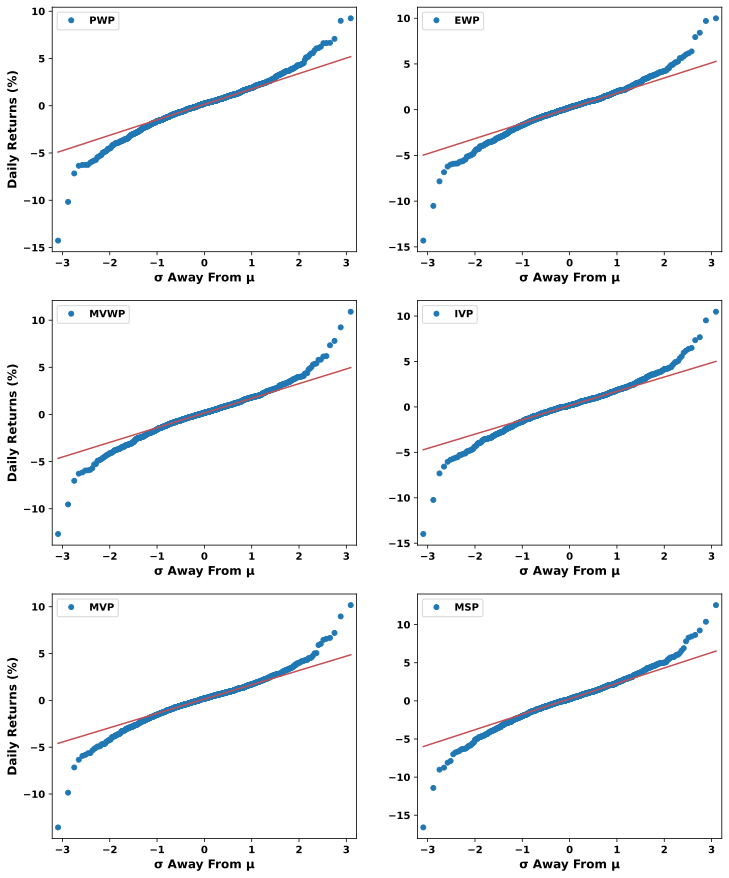

In [135]:
plot_qq(returns[portfs])

In [136]:
downside_portfs#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral") 

,Annual Downside Standard Deviation,Average Drawdown,Average Drawdown Duration (Days),Maximum Drawdown,Longest Drawdown Duration (Days),Sterling Ratio,Ulcer Index,Calmar Ratio,Sortino Ratio,Kappa Ratio
PWP,0.2457,-0.1407,7.7478,-0.4708,389,0.5753,20.5333,0.6372,1.0992,0.0630
EWP,0.2501,-0.1355,7.0480,-0.4693,473,0.6582,19.6644,0.7136,1.2191,0.0684
MVWP,0.2301,-0.1211,8.4906,-0.4387,470,0.5703,17.2539,0.6292,1.0694,0.0570
IVP,0.2400,-0.1334,6.3971,-0.4552,474,0.5938,19.2865,0.6535,1.1142,0.0540
MVP,0.2297,-0.1237,7.9027,-0.4129,473,0.5777,17.7409,0.6427,1.0248,0.0454
MSP,0.2910,-0.1347,6.1348,-0.4859,358,1.0003,19.5755,1.0566,1.6610,0.1172


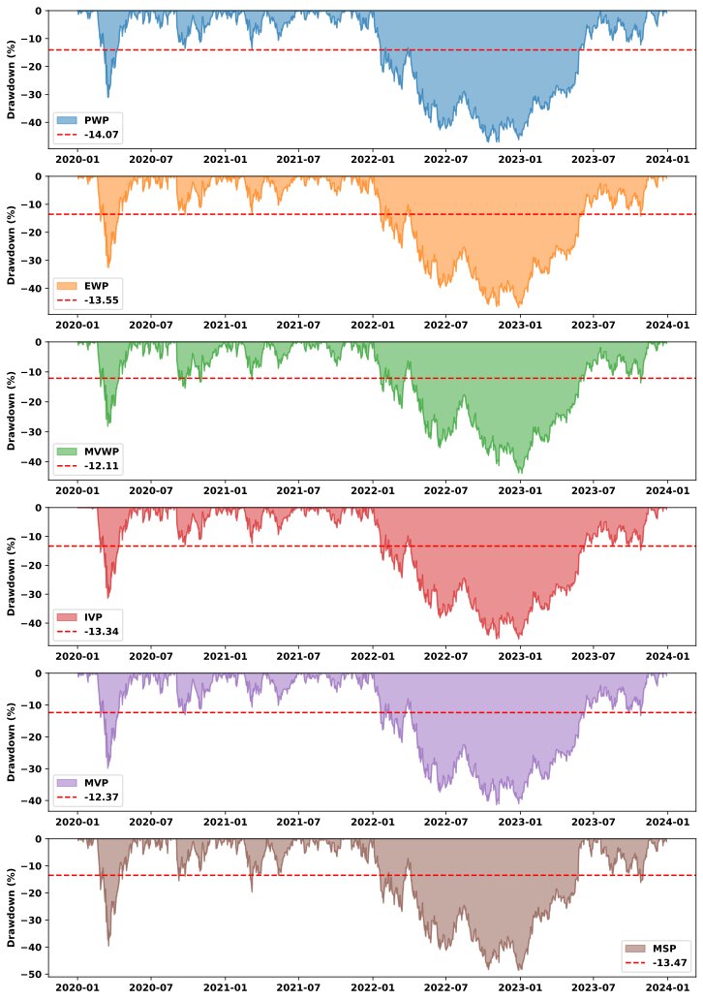

In [137]:
plot_drawdowns(returns[portfs]) 

In [138]:
tail_portfs#.style\
           #.highlight_max(color = "lightgreen")\
           #.highlight_min(color = "lightcoral")

,Skew,Kurtosis,Average Lower Tail Return (< 5%),Average Upper Tail Return (> 95%),Tail Ratio,Common Sense Ratio,Outlier Win Ratio (> 99%),Outlier Loss Ratio (< 1%)
PWP,-0.3894,3.6531,-0.0484,0.0467,0.9659,1.1273,3.6978,3.5953
EWP,-0.3721,3.8374,-0.0488,0.0470,0.9649,1.1438,3.4214,3.5516
MVWP,-0.2365,3.8464,-0.0453,0.0441,0.9745,1.1333,3.6616,3.5570
IVP,-0.3387,4.3753,-0.0465,0.0453,0.9741,1.1443,3.4300,3.4379
MVP,-0.3718,4.5853,-0.0448,0.0430,0.9590,1.1136,3.4138,3.5174
MSP,-0.3264,3.5084,-0.0568,0.0562,0.9885,1.2314,3.2516,3.4279


In [139]:
VaR_portfs#.style\
          #.highlight_max(color = "lightgreen")\
          #.highlight_min(color = "lightcoral")

Daily                                                \
     Historic VaR (95%) Parametric VaR (95%) Cornish-Fisher VaR (95%)   
PWP             -0.0350              -0.0335                  -0.0342   
EWP             -0.0345              -0.0339                  -0.0344   
MVWP            -0.0323              -0.0317                  -0.0315   
IVP             -0.0328              -0.0324                  -0.0325   
MVP             -0.0301              -0.0310                  -0.0312   
MSP             -0.0394              -0.0396                  -0.0402   

                                       Weekly                       \
     Conditional VaR (95%) Historic VaR (95%) Parametric VaR (95%)   
PWP                -0.0484            -0.0783              -0.0750   
EWP                -0.0488            -0.0772              -0.0758   
MVWP               -0.0453            -0.0723              -0.0710   
IVP                -0.0465            -0.0733              -0.0723   
MVP                -0.0448            -0.0674              -0.0693   
MSP                -0.0568            -0.0880              -0.0886   

                                                               Monthly  \
     Cornish-Fisher VaR (95%) Conditional VaR (95%) Historic VaR (95%)   
PWP                   -0.0766               -0.1082            -0.1604   
EWP                   -0.0770               -0.1090            -0.1583   
MVWP                  -0.0705               -0.1012            -0.1482   
IVP                   -0.0726               -0.1040            -0.1501   
MVP                   -0.0698               -0.1003            -0.1381   
MSP                   -0.0898               -0.1271            -0.1804   

                                                                          \
     Parametric VaR (95%) Cornish-Fisher VaR (95%) Conditional VaR (95%)   
PWP               -0.1536                  -0.1569               -0.2217   
EWP               -0.1553                  -0.1578               -0.2234   
MVWP              -0.1455                  -0.1444               -0.2075   
IVP               -0.1483                  -0.1488               -0.2131   
MVP               -0.1421                  -0.1431               -0.2055   
MSP               -0.1817                  -0.1840               -0.2605   

              Quarterly                                                \
     Historic VaR (95%) Parametric VaR (95%) Cornish-Fisher VaR (95%)   
PWP             -0.2779              -0.2661                  -0.2718   
EWP             -0.2741              -0.2690                  -0.2734   
MVWP            -0.2568              -0.2520                  -0.2502   
IVP             -0.2600              -0.2568                  -0.2577   
MVP             -0.2392              -0.2461                  -0.2478   
MSP             -0.3124              -0.3147                  -0.3187   

                                       Annual                       \
     Conditional VaR (95%) Historic VaR (95%) Parametric VaR (95%)   
PWP                -0.3840            -0.5557              -0.5322   
EWP                -0.3870            -0.5482              -0.5380   
MVWP               -0.3593            -0.5135              -0.5039   
IVP                -0.3692            -0.5200              -0.5136   
MVP                -0.3559            -0.4784              -0.4923   
MSP                -0.4511            -0.6248              -0.6293   

                                                     
     Cornish-Fisher VaR (95%) Conditional VaR (95%)  
PWP                   -0.5436               -0.7680  
EWP                   -0.5468               -0.7740  
MVWP                  -0.5003               -0.7186  
IVP                   -0.5154               -0.7383  
MVP                   -0.4956               -0.7119  
MSP                   -0.6374               -0.9023

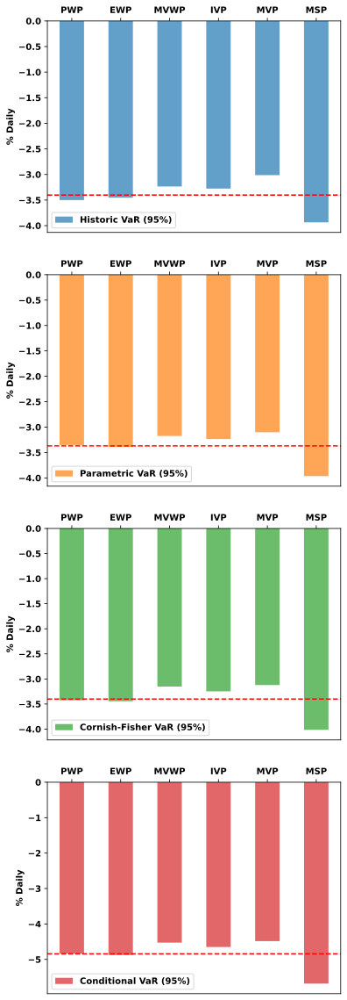

In [140]:
plot_Value_at_Risk(VaR_portfs, "daily") 

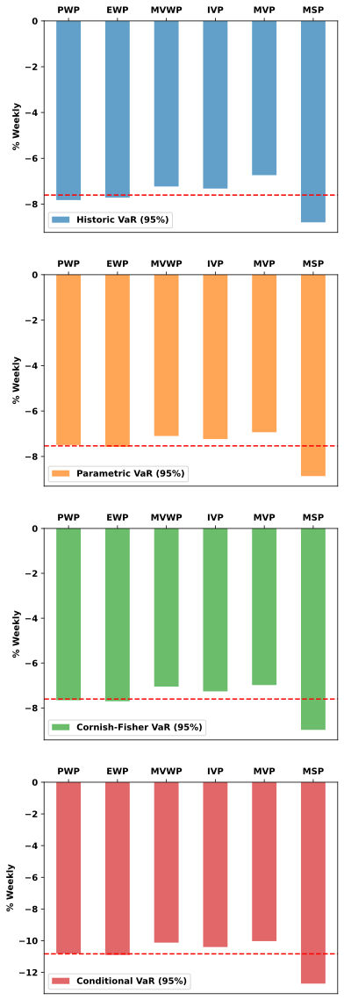

In [141]:
plot_Value_at_Risk(VaR_portfs, "weekly") 

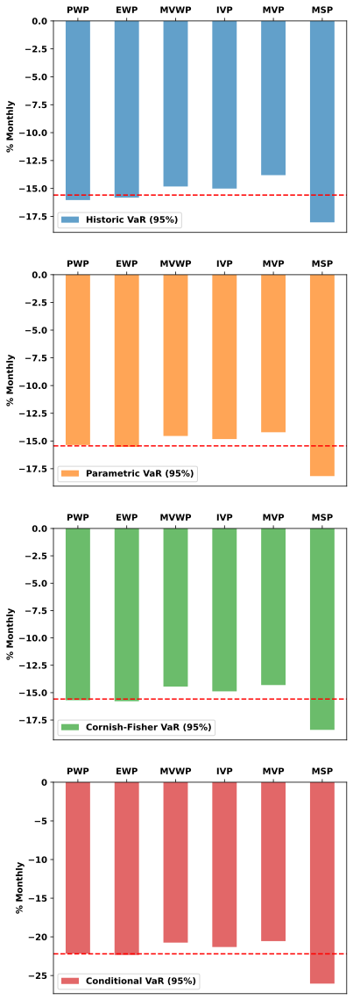

In [142]:
plot_Value_at_Risk(VaR_portfs, "monthly") 

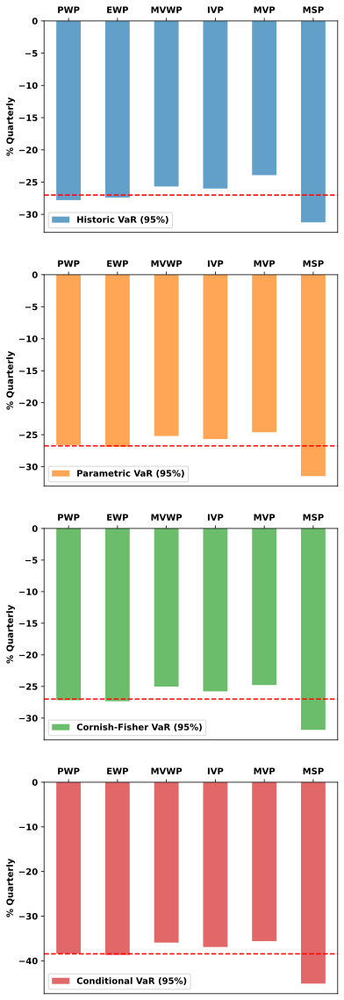

In [143]:
plot_Value_at_Risk(VaR_portfs, "quarterly") 

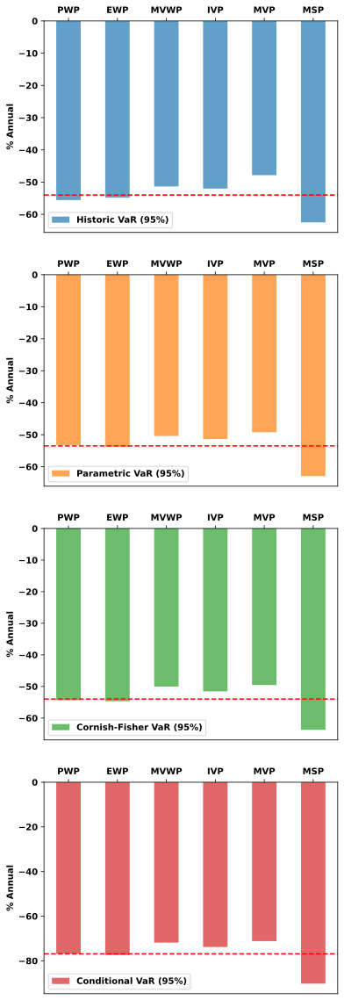

In [144]:
plot_Value_at_Risk(VaR_portfs) 

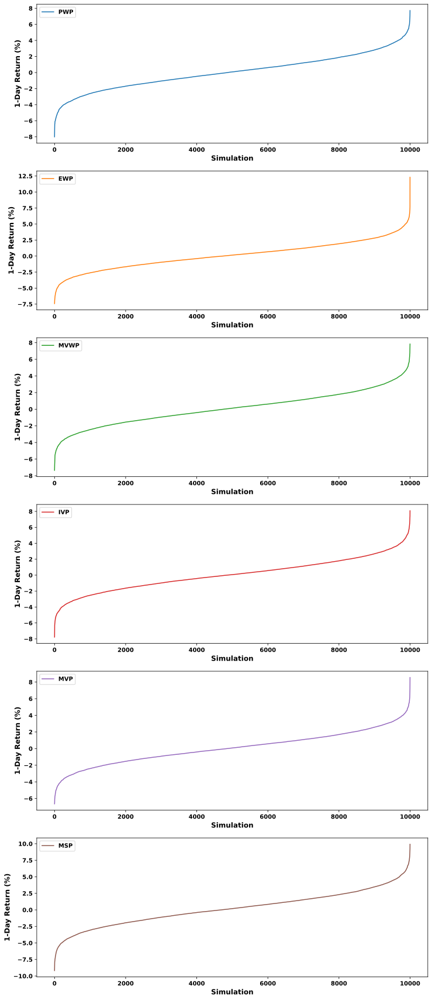

In [145]:
plot_MC_sims(returns[portfs], n_days = 1)

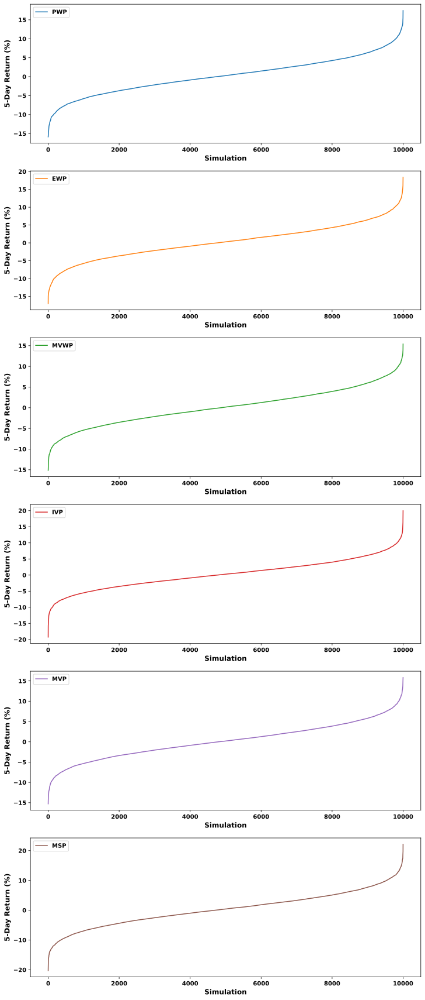

In [146]:
plot_MC_sims(returns[portfs], n_days = 5)

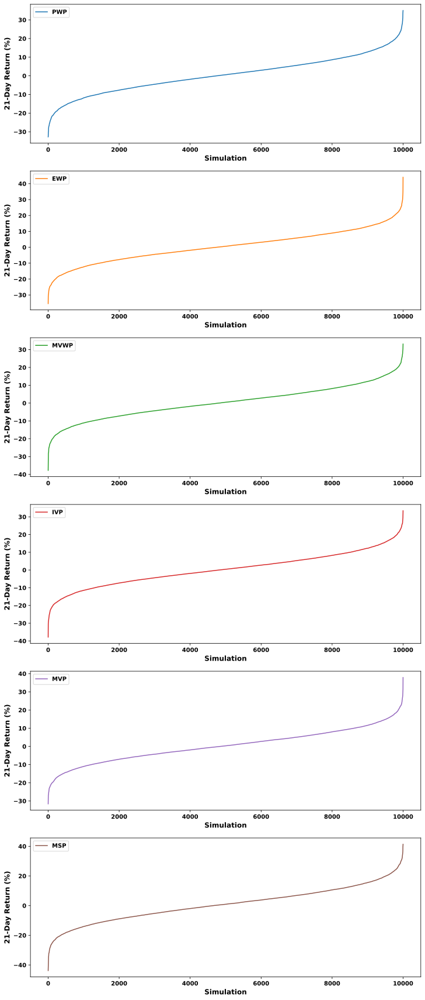

In [147]:
plot_MC_sims(returns[portfs], n_days = 21)

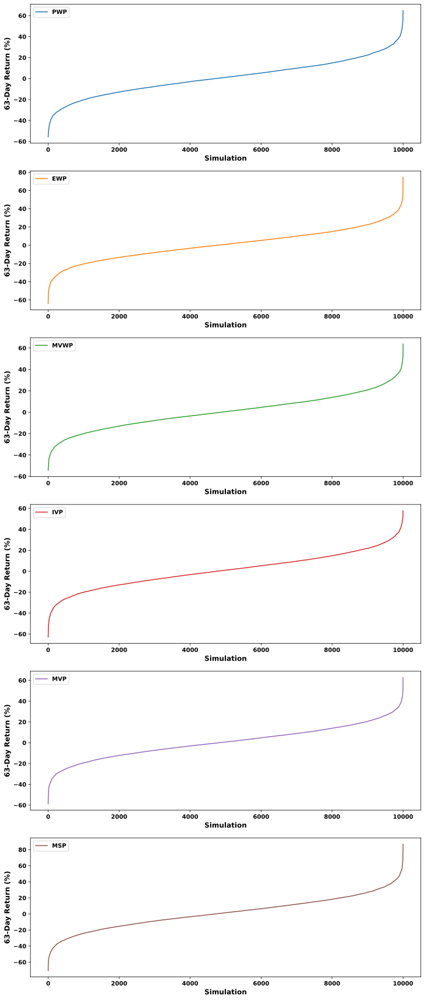

In [148]:
plot_MC_sims(returns[portfs], n_days = 63)

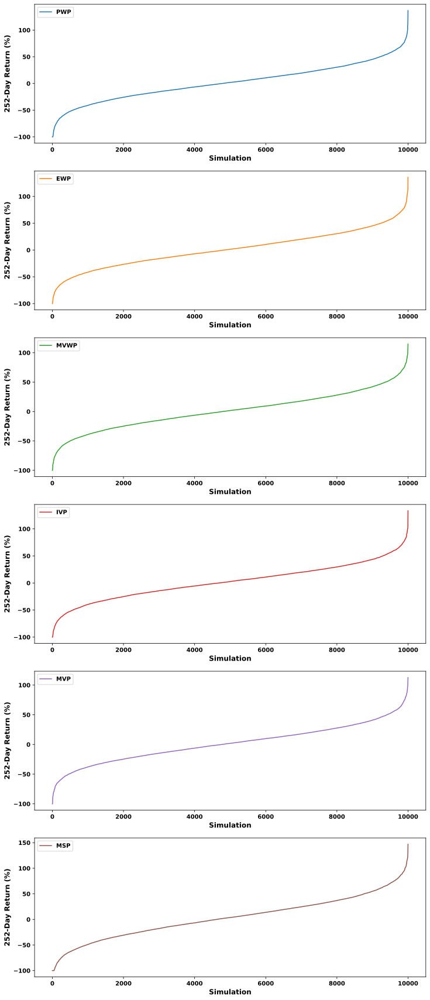

In [149]:
plot_MC_sims(returns[portfs], 252)

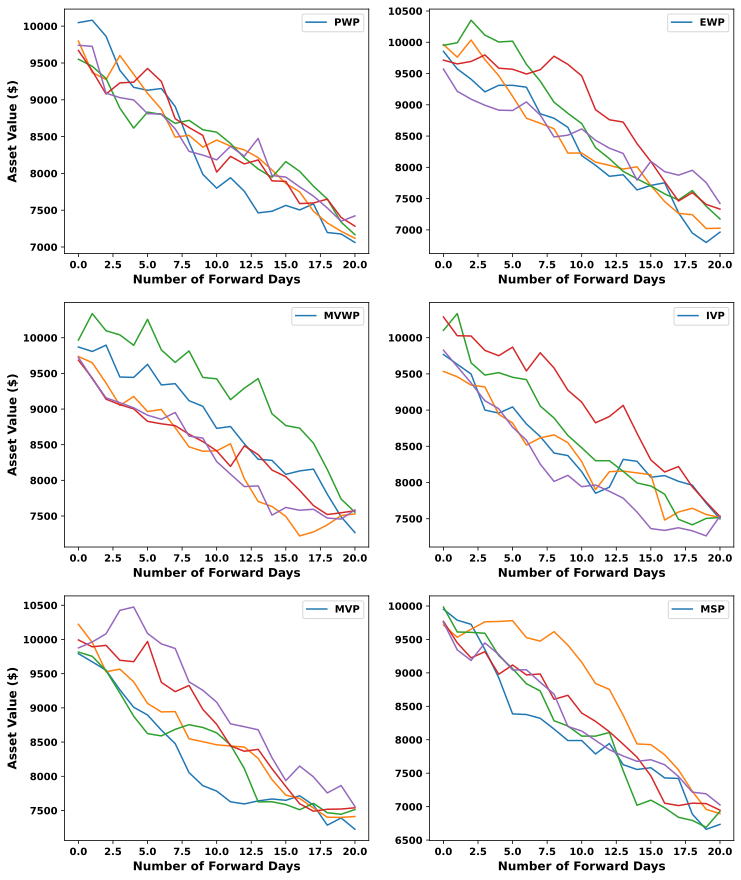

In [150]:
plot_MC_worst_scenarios(returns[portfs], n_days = 21)

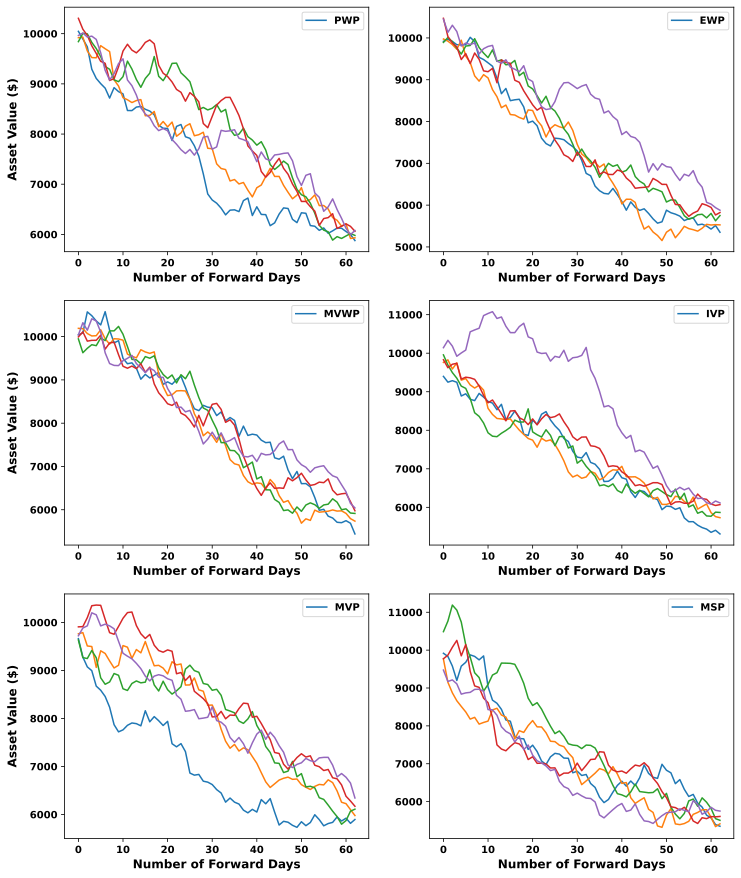

In [151]:
plot_MC_worst_scenarios(returns[portfs], n_days = 63)

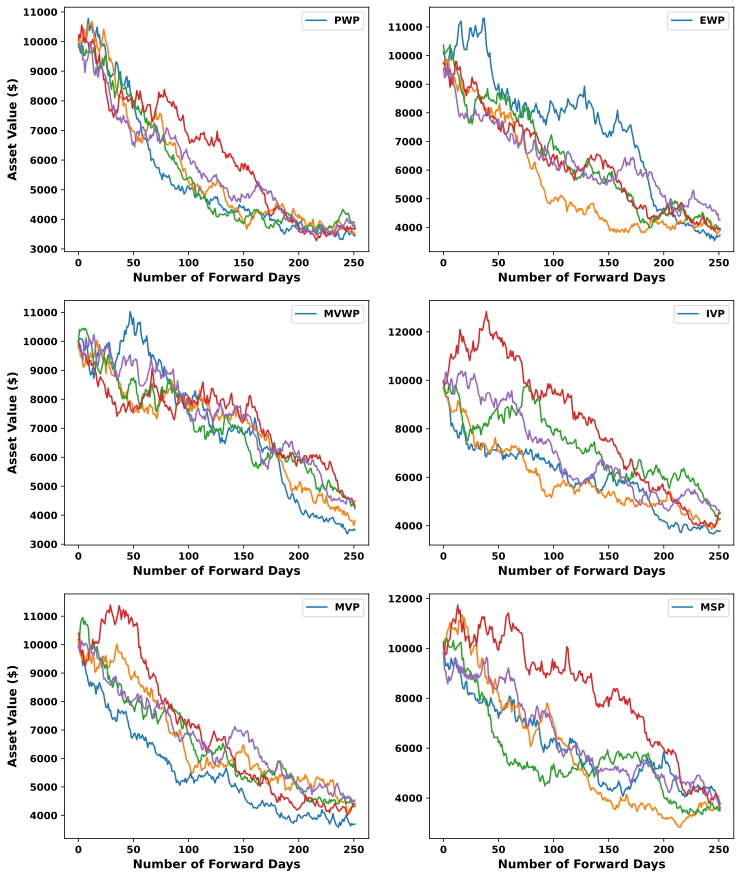

In [152]:
plot_MC_worst_scenarios(returns[portfs], n_days = 252)

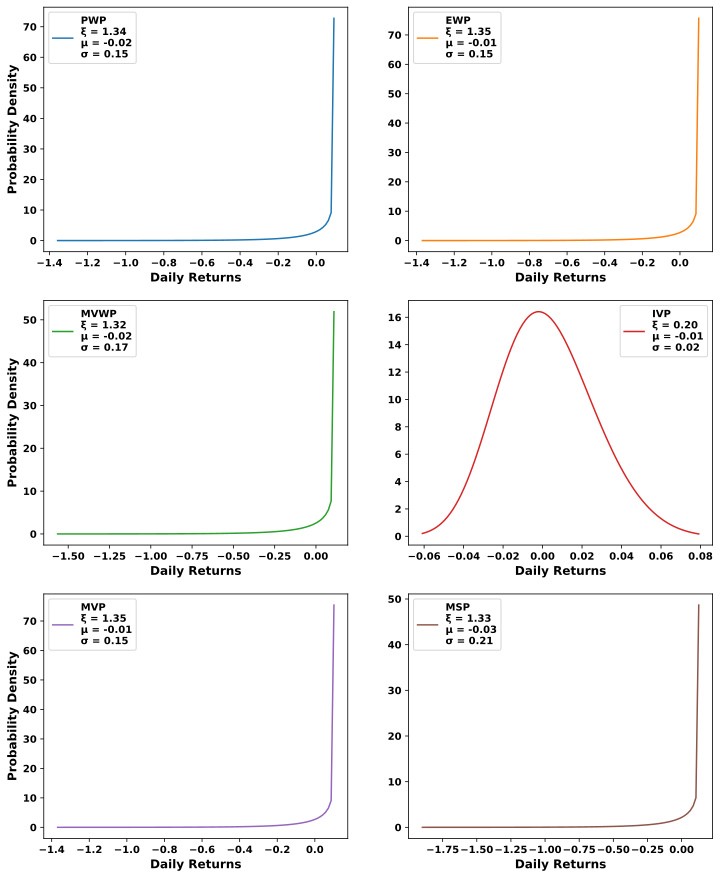

In [153]:
plot_extreme_value_theory(returns[portfs])

$$
\text{Annualized Active Return}_{portfolio} = \text{Annualized } \bar{\text{Return}}_{portfolio} - \text{Annualized } \bar{\text{Return}}_{benchmark}
$$

$$
\text{Annualized Tracking Error}_{portfolio} = \sqrt{\frac{\sum_{t=1}^{T} (\text{Return}_{portfolio,t} - \text{Return}_{benchmark,t})^2}{T}} \times \sqrt{252}
$$

$$
\text{Annualized Information Ratio}_{portfolio} = \frac{\text{Annualized Active Return}_{portfolio}}{\text{Annualized Tracking Error}_{portfolio}}
$$

$$
\text{Annualized M}^2 \text{ Ratio}_{portfolio} = \text{Annualized Sharpe}_{portfolio} \times \text{Annualized } \sigma_{benchmark} + \text{Risk-Free Rate} 
$$

$$
\text{Upside Capture}_{portfolio} = \frac{\left( \prod_{t=1}^{T} 1 + \max(0, \text{ Return}_{portfolio,t}) \right) - 1}{\left( \prod_{t=1}^{T} 1 + \max(0, \text{ Return}_{benchmark,t}) \right) - 1} 
$$ 

$$
\text{Downside Capture}_{portfolio} = \frac{\left( \prod_{t=1}^{T} 1 + \min(0, \text{ Return}_{portfolio,t}) \right) - 1}{\left( \prod_{t=1}^{T} 1 + \min(0, \text{ Return}_{benchmark,t}) \right) - 1} 
$$ 

$$
\text{R}^2_{portfolio} = 1 - \frac{\sum_{t=1}^{T} (\text{Return}_{benchmark, t} - \hat{\text{Return}}_{benchmark, t})^2}{\sum_{t=1}^{T} (\text{Return}_{benchmark, t} - \bar{\text{Return}}_{benchmark, t})^2}
$$

In [154]:
def perf_against_benchmark(returns_portfs_df, benchmark = "^NDXT") :
    """
    Arguments :
    - returns_portfs_df : DataFrame of portfolios' daily returns 
    - benchmark : str for the benchmark ticker (^NDXT by default)
    
    Returns :
    - perf_df : DataFrame displaying ratios of performance relative to a benchmark 
    
    Function :
    - Computes the annualized active return, annualized tracking error, annualized information ratio, annualized m-squared ratio, upside cature, downside capture, and r-squared 
    """
    compare = yf.download(tickers = benchmark, start = start_date, end = end_date)
    close_compare = compare["Close"].copy( ) 
    benchmark_returns = close_compare.pct_change(periods = 1).iloc[1:] 
    
    active_return_list = [  ]
    tracking_error_list = [  ]
    information_list = [  ]
    m2_list = [  ]
    upside_capture_list = [  ]
    downside_capture_list = [  ]
    r2_list = [  ]
    for portf in returns_portfs_df.columns :
        
        ann_return_portf = returns_portfs_df[portf].mean( ) * 252
        ann_return_benchmark = benchmark_returns.mean( ) * 252
        active_return = ann_return_portf - ann_return_benchmark
        
        returns_above_benchmark = returns_portfs_df[portf].sub(benchmark_returns)
        tracking_error = returns_above_benchmark.std( ) * np.sqrt(252)
        
        information = active_return / tracking_error 
        
        ann_sharpe_portf = (ann_return_portf - rf_rate) / (returns_portfs_df[portf].std( ) * np.sqrt(252)) 
        ann_std_benchmark = benchmark_returns.std( ) * np.sqrt(252)
        m2 = ann_sharpe_portf * ann_std_benchmark + rf_rate 
        
        cum_positive_portf = (1 + returns_portfs_df[portf].loc[returns_portfs_df[portf] > 0]).prod( ) - 1
        cum_positive_benchmark = (1 + benchmark_returns.loc[benchmark_returns > 0]).prod( ) - 1
        upside_capture = cum_positive_portf / cum_positive_benchmark
        
        cum_negative_portf = (1 + returns_portfs_df[portf].loc[returns_portfs_df[portf] < 0]).prod( ) - 1
        cum_negative_benchmark = (1 + benchmark_returns.loc[benchmark_returns < 0]).prod( ) - 1
        downside_capture = cum_negative_portf / cum_negative_benchmark
        
        lin_reg = linear_model.LinearRegression( )
        lin_reg.fit(returns_portfs_df[portf].to_frame( ) , benchmark_returns)
        Y_pred = lin_reg.predict(returns_portfs_df[portf].to_frame( ))
        r2 = metrics.r2_score(benchmark_returns, Y_pred)
        
        active_return_list.append(active_return)
        tracking_error_list.append(tracking_error)
        information_list.append(information)
        m2_list.append(m2)
        upside_capture_list.append(upside_capture)
        downside_capture_list.append(downside_capture)
        r2_list.append(r2)
    
    perf_df = pd.DataFrame({"Annual Active Return" : active_return_list, "Annual Tracking Error" : tracking_error_list, 
                            "Annual Information Ratio" : information_list, "Annual M2 Ratio" : m2_list,
                            "Upside Capture" : upside_capture_list, "Downside Capture" : downside_capture_list,  
                            "R-Squared" : r2_list}, 
                           index = returns_portfs_df.columns)
    print(f"Benchmark = {benchmark}")
    return perf_df 

In [155]:
relative_perf_porfs = perf_against_benchmark(returns[portfs])

[*********************100%%**********************]  1 of 1 completed

Benchmark = ^NDXT


In [156]:
relative_perf_porfs#.style\
                   #.highlight_max(color = "lightgreen")\
                   #.highlight_min(color = "lightcoral")

,Annual Active Return,Annual Tracking Error,Annual Information Ratio,Annual M2 Ratio,Upside Capture,Downside Capture,R-Squared
PWP,0.1017,0.1291,0.7873,0.3024,1.1426,0.9998,0.8582
EWP,0.1365,0.1121,1.2173,0.3331,1.3665,0.9999,0.8935
MVWP,0.0777,0.1372,0.5660,0.2923,0.7011,0.9995,0.8356
IVP,0.0991,0.1152,0.8597,0.3093,0.7839,0.9995,0.8840
MVP,0.0670,0.1226,0.5466,0.2871,0.5565,0.9993,0.8685
MSP,0.3151,0.1693,1.8610,0.4361,8.1740,1.0003,0.8277


In [157]:
def plot_cum_active_return(returns_portfs_df, benchmark = "^NDXT") :
    """
    Arguments :
    - returns_portfs_df : DataFrame of portfolios' daily returns 
    - benchmark : str for the benchmark ticker (^NDXT by default)
    
    Returns :
    - None 
    
    Function :
    - Subtracts the specified benchmark's cumulative returns from each portfolio's cumulative returns 
    - Draws an area plot of the active returns relative to the benchmark for each portfolio 
    """
    compare = yf.download(tickers = benchmark, start = start_date, end = end_date)
    close_compare = compare["Close"].copy( ) 
    returns_benchmark = close_compare.pct_change(periods = 1).iloc[1:] 
    cum_returns_benchmark = (1 + returns_benchmark).cumprod( ) - 1 
    
    cum_returns_portfs = (1 + returns_portfs_df).cumprod( ) - 1 
    cum_active_return_portfs = cum_returns_portfs.sub(cum_returns_benchmark, axis = 0) 
    
    portfs = returns_portfs_df.columns 
    n_portfs = len(portfs)
    
    fig, ax = plt.subplots(figsize = (12, n_portfs * 7), nrows = n_portfs, ncols = 1)
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    
    for i, portf in enumerate(portfs) : 
        ax[i].fill_between(cum_active_return_portfs.index, cum_active_return_portfs[portf] * 100, 
                           color = colors[i], alpha = 0.7, label = portf)
        
        ax[i].set_ylabel("Cumulative Active Return (%)", fontsize = 12)
        ax[i].legend( )
    
    plt.show( )

[*********************100%%**********************]  1 of 1 completed


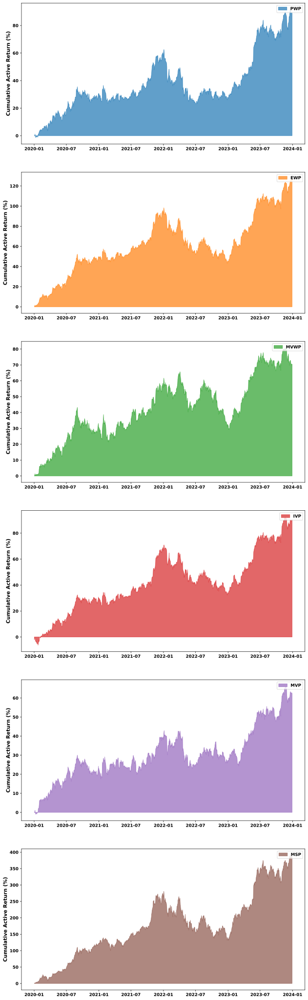

In [158]:
plot_cum_active_return(returns[portfs])

In [159]:
def plot_seasonal_active_return(returns_portfs_df, freq = None, benchmark = "^NDXT"):
    """
    Arguments :
    - returns_portfs_df : DataFrame of portfolios' daily returns 
    - freq (optional) : str for resampling frequency -> weekly or monthly 
    - benchmark : str for the benchmark ticker (^NDXT by default)

    Returns :
    - None 
        
    Function :
    - Resamples daily returns to the specified resampling frequency (if specified)
    - Subtracts the specified benchmark's returns from each portfolio's returns 
    - Plots a bar chart showing the average active return in each month of the year for each asset
    """
    compare = yf.download(tickers = benchmark, start = start_date, end = end_date)
    close_compare = compare["Close"].copy( ) 
    returns_benchmark = close_compare.pct_change(periods = 1).iloc[1:] 
    
    if freq :
        resampling = {"weekly" : "W-Fri", "monthly" : "BM"} 
        returns_portfs_df = returns_portfs_df.resample(resampling[freq]).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)   
        returns_benchmark = returns_benchmark.resample(resampling[freq]).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1) 
    
    active_return_portfs = returns_portfs_df.sub(returns_benchmark, axis = 0)
    
    active_return_portfs["Month"] = active_return_portfs.index.month
    monthly_avg_active_return = active_return_portfs.groupby("Month").mean( )
    active_return_portfs.drop(columns = ["Month"], inplace = True)
    
    month_mapper = {1 : "Jan", 2 : "Feb", 3 : "Mar", 4 : "Apr", 
                    5 : 'May', 6: "Jun", 7 : "Jul", 8 : "Aug", 
                    9 : "Sept", 10 : "Oct", 11 : "Nov", 12 : "Dec"}
    monthly_avg_active_return.index = monthly_avg_active_return.index.map(month_mapper)
    
    portfs = returns_portfs_df.columns
    n_portfs = len(portfs)
    
    fig, ax = plt.subplots(figsize = (12, n_portfs * 7), nrows = n_portfs, ncols = 1)
    colors = sns.color_palette("tab10") + ["limegreen", "fuchsia"]
    
    for i, portf in enumerate(portfs) :  
        ax[i].bar(monthly_avg_active_return.index, monthly_avg_active_return[portf] * 100, 
                  width = 0.3, color = colors[i], alpha = 0.7, label = portf)
        
        if freq :
            ax[i].set_ylabel(f"Average {freq.title( )} Active Return (%)", fontsize = 12)
        else :
            ax[i].set_ylabel("Average Daily Active Return (%)", fontsize = 12)
        ax[i].legend( )
    
    plt.style.use("default")
    plt.show( )

[*********************100%%**********************]  1 of 1 completed


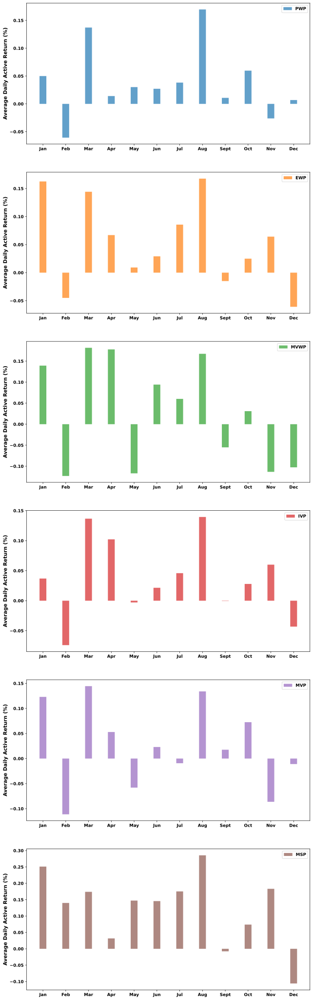

In [160]:
plot_seasonal_active_return(returns[portfs])

[*********************100%%**********************]  1 of 1 completed


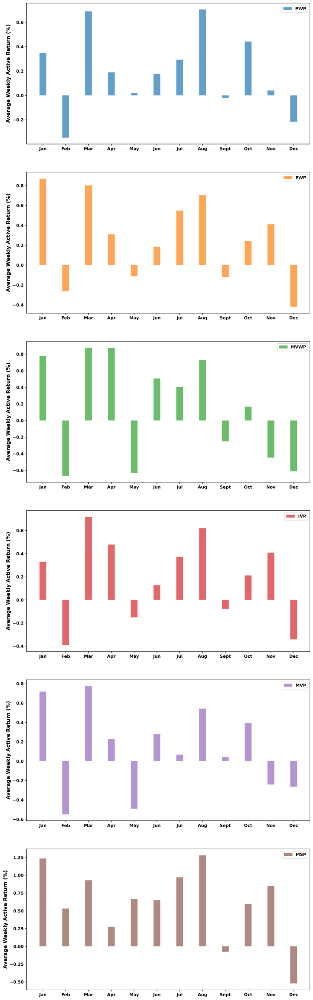

In [161]:
plot_seasonal_active_return(returns[portfs], freq = "weekly")

[*********************100%%**********************]  1 of 1 completed


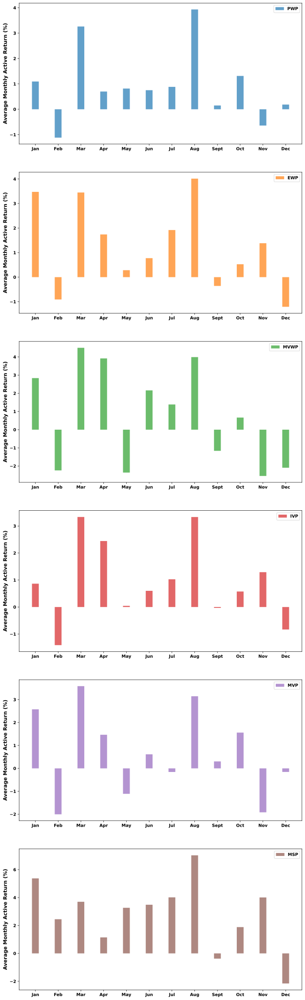

In [162]:
plot_seasonal_active_return(returns[portfs], freq = "monthly")

## 3. Putting It All Together
<a id="section-3"></a>

In [163]:
summary = pd.concat(objs = [summary_stocks, summary_portfs], axis = 0) 

best_worst = pd.concat(objs = [best_worst_stocks, best_worst_portfs], axis = 0) 

win_percent = pd.concat(objs = [win_percent_stocks, win_percent_portfs], axis = 0)

win_loss = pd.concat(objs = [win_loss_stocks, win_loss_portfs], axis = 0)

win_lose_streak = pd.concat(objs = [win_lose_streak_stocks, win_lose_streak_portfs], axis = 0)

dist_attributes = pd.concat(objs = [dist_attributes_stocks, dist_attributes_portfs], axis = 0)

downside = pd.concat(objs = [downside_stocks, downside_portfs], axis = 0) 

tail = pd.concat(objs = [tail_stocks, tail_portfs], axis = 0) 

VaR = pd.concat(objs = [VaR_stocks, VaR_portfs], axis = 0) 

In [164]:
summary#.style\
       #.highlight_max(color = "lightgreen")\
       #.highlight_min(color = "lightcoral")

Daily                   Weekly                   Monthly             \
      Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
AAPL  0.0012     0.0211 0.0559 0.0059     0.0473 0.1250  0.0248     0.0969   
AMD   0.0017     0.0338 0.0512 0.0086     0.0755 0.1144  0.0363     0.1548   
AMZN  0.0008     0.0237 0.0327 0.0039     0.0531 0.0731  0.0163     0.1088   
AVGO  0.0015     0.0242 0.0641 0.0077     0.0540 0.1434  0.0325     0.1107   
GOOGL 0.0010     0.0211 0.0452 0.0048     0.0472 0.1010  0.0200     0.0968   
INTC  0.0002     0.0260 0.0064 0.0008     0.0581 0.0143  0.0035     0.1191   
META  0.0010     0.0295 0.0334 0.0049     0.0659 0.0747  0.0207     0.1350   
MSFT  0.0011     0.0206 0.0523 0.0054     0.0460 0.1170  0.0226     0.0942   
NFLX  0.0009     0.0307 0.0292 0.0045     0.0686 0.0653  0.0188     0.1405   
NVDA  0.0027     0.0341 0.0790 0.0135     0.0764 0.1766  0.0566     0.1565   
QCOM  0.0008     0.0266 0.0317 0.0042     0.0595 0.0710  0.0177     0.1219   
TSLA  0.0031     0.0429 0.0722 0.0155     0.0959 0.1614  0.0650     0.1965   
PWP   0.0012     0.0211 0.0564 0.0060     0.0472 0.1261  0.0250     0.0967   
EWP   0.0013     0.0214 0.0621 0.0066     0.0479 0.1388  0.0279     0.0981   
MVWP  0.0011     0.0200 0.0549 0.0055     0.0446 0.1227  0.0230     0.0915   
IVP   0.0012     0.0204 0.0579 0.0059     0.0456 0.1295  0.0248     0.0934   
MVP   0.0011     0.0195 0.0540 0.0053     0.0436 0.1208  0.0221     0.0893   
MSP   0.0020     0.0253 0.0804 0.0102     0.0567 0.1798  0.0428     0.1161   

             Quarterly                   Annual                    
      Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
AAPL  0.2562    0.0745     0.1679 0.4437 0.2979     0.3357 0.8874  
AMD   0.2345    0.1089     0.2682 0.4062 0.4358     0.5363 0.8125  
AMZN  0.1498    0.0489     0.1885 0.2594 0.1956     0.3769 0.5188  
AVGO  0.2938    0.0976     0.1917 0.5089 0.3903     0.3835 1.0178  
GOOGL 0.2070    0.0601     0.1677 0.3586 0.2405     0.3353 0.7172  
INTC  0.0292    0.0104     0.2063 0.0506 0.0418     0.4125 0.1012  
META  0.1530    0.0620     0.2338 0.2651 0.2479     0.4677 0.5302  
MSFT  0.2398    0.0677     0.1631 0.4153 0.2710     0.3263 0.8306  
NFLX  0.1338    0.0564     0.2433 0.2317 0.2255     0.4867 0.4634  
NVDA  0.3620    0.1699     0.2710 0.6270 0.6798     0.5421 1.2540  
QCOM  0.1454    0.0532     0.2111 0.2519 0.2127     0.4222 0.5037  
TSLA  0.3307    0.1950     0.3404 0.5728 0.7799     0.6808 1.1456  
PWP   0.2585    0.0750     0.1675 0.4478 0.3000     0.3350 0.8955  
EWP   0.2844    0.0837     0.1700 0.4926 0.3349     0.3399 0.9852  
MVWP  0.2514    0.0690     0.1585 0.4355 0.2760     0.3169 0.8710  
IVP   0.2653    0.0744     0.1618 0.4596 0.2975     0.3236 0.9192  
MVP   0.2476    0.0664     0.1547 0.4288 0.2654     0.3095 0.8577  
MSP   0.3685    0.1284     0.2011 0.6382 0.5134     0.4023 1.2764

In [165]:
best_worst#.style\
          #.highlight_max(color = "lightgreen")\
          #.highlight_min(color = "lightcoral")

Daily                   Weekly                  Monthly  \
      Best Return Worst Return Best Return Worst Return Best Return   
AAPL       0.1198      -0.1286      0.1473      -0.1753      0.2144   
AMD        0.1650      -0.1464      0.2609      -0.1540      0.4718   
AMZN       0.1354      -0.1405      0.1626      -0.1390      0.2706   
AVGO       0.1583      -0.1991      0.2001      -0.1793      0.2896   
GOOGL      0.0924      -0.1163      0.1431      -0.1203      0.1590   
INTC       0.1952      -0.1804      0.1605      -0.1580      0.3105   
META       0.2328      -0.2639      0.2449      -0.2370      0.2677   
MSFT       0.1422      -0.1474      0.1241      -0.1352      0.1763   
NFLX       0.1685      -0.3512      0.2590      -0.3682      0.2861   
NVDA       0.2437      -0.1845      0.2457      -0.1607      0.3634   
QCOM       0.1522      -0.1495      0.2254      -0.1965      0.3572   
TSLA       0.1989      -0.2106      0.3334      -0.2586      0.7415   
PWP        0.0925      -0.1427      0.1095      -0.1209      0.1959   
EWP        0.0999      -0.1431      0.1178      -0.1250      0.1880   
MVWP       0.1090      -0.1268      0.0998      -0.1139      0.1820   
IVP        0.1048      -0.1399      0.1086      -0.1173      0.1883   
MVP        0.1017      -0.1356      0.1047      -0.1097      0.1741   
MSP        0.1255      -0.1660      0.1729      -0.1534      0.2797   

                     Quarterly                   Annual               
      Worst Return Best Return Worst Return Best Return Worst Return  
AAPL       -0.1223      0.4346      -0.2170      0.8075      -0.2683  
AMD        -0.2534      0.5584      -0.3006      1.2759      -0.5499  
AMZN       -0.2375      0.4150      -0.3484      0.8088      -0.4962  
AVGO       -0.1626      0.3722      -0.2497      0.9964      -0.1597  
GOOGL      -0.1795      0.2204      -0.2165      0.6530      -0.3909  
INTC       -0.2022      0.4135      -0.3111      0.9012      -0.4868  
META       -0.3263      0.7612      -0.3389      1.9413      -0.6422  
MSFT       -0.1093      0.2904      -0.1670      0.5680      -0.2869  
NFLX       -0.4918      0.3464      -0.5332      0.6711      -0.5105  
NVDA       -0.3203      0.9007      -0.4444      2.3887      -0.5031  
QCOM       -0.1458      0.4178      -0.2333      0.7266      -0.3988  
TSLA       -0.3673      1.0607      -0.5356      7.4344      -0.6503  
PWP        -0.2031      0.3201      -0.3072      0.9809      -0.4266  
EWP        -0.1904      0.3657      -0.2911      0.9966      -0.4340  
MVWP       -0.1581      0.3598      -0.2638      0.7838      -0.4029  
IVP        -0.1798      0.3511      -0.2760      0.9030      -0.4230  
MVP        -0.1910      0.3266      -0.2809      0.7947      -0.3790  
MSP        -0.2138      0.5155      -0.3326      1.6058      -0.4404

In [166]:
win_percent

,% of Winning Days,% of Winning Weeks,% of Winning Months,% of Winning Quarters,% of Winning Years
AAPL,52.4851,56.9378,58.3333,62.5000,75.0000
AMD,49.9006,52.1531,50.0000,62.5000,75.0000
AMZN,51.8887,53.1100,56.2500,62.5000,75.0000
AVGO,52.9821,58.8517,70.8333,68.7500,75.0000
GOOGL,53.4791,54.0670,58.3333,68.7500,75.0000
INTC,49.8012,53.5885,54.1667,43.7500,50.0000
META,51.7893,52.6316,62.5000,56.2500,75.0000
MSFT,52.3857,55.0239,58.3333,75.0000,75.0000
NFLX,50.8946,52.6316,54.1667,68.7500,75.0000
NVDA,54.2744,55.0239,62.5000,75.0000,75.0000


In [167]:
win_loss#.style\
        #.highlight_max(color = "lightgreen")\
        #.highlight_min(color = "lightcoral")

Daily                                            Weekly  \
      Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio   
AAPL           1.1713        1.0537              7.3926          1.4258   
AMD            1.1500        1.1500              6.3362          1.3395   
AMZN           1.0948        1.0109              4.2959          1.2178   
AVGO           1.2036        1.0682              8.9641          1.5325   
GOOGL          1.1347        0.9849              6.2459          1.3070   
INTC           1.0188        1.0148              0.3330          1.0257   
META           1.1061        1.0276              4.8728          1.2227   
MSFT           1.1599        1.0499              7.0329          1.4011   
NFLX           1.0928        1.0543              4.3204          1.2060   
NVDA           1.2397        1.0399             10.3034          1.6295   
QCOM           1.0927        1.0627              4.3006          1.2091   
TSLA           1.2237        1.0495              9.7357          1.5051   
PWP            1.1671        0.9484              7.8991          1.4063   
EWP            1.1854        0.9710              8.5971          1.4511   
MVWP           1.1629        0.9758              7.6171          1.4012   
IVP            1.1748        0.9602              5.8411          1.4288   
MVP            1.1613        0.9667              7.5789          1.4006   
MSP            1.2458        1.0002             10.9436          1.6007   

                                                Monthly                \
      Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio   
AAPL         1.0784             17.0052          1.8863        1.3473   
AMD          1.2289             13.2192          1.8037        1.8037   
AMZN         1.0752              9.4985          1.4731        1.1457   
AVGO         1.0715             20.4482          2.3795        0.9798   
GOOGL        1.1104             12.7007          1.7234        1.2310   
INTC         0.8883              1.3433          1.0352        0.8759   
META         1.1005              9.5879          1.5200        0.9120   
MSFT         1.1452             15.7507          2.1260        1.5186   
NFLX         1.0854              8.9911          1.5014        1.2704   
NVDA         1.3320             21.2572          2.5682        1.5409   
QCOM         1.0472              9.2673          1.4511        1.3350   
TSLA         1.1835             18.7873          2.2659        1.7623   
PWP          1.0845             16.3110          2.0408        1.3371   
EWP          1.1634             17.2541          2.1376        1.2826   
MVWP         1.2135             15.3439          1.9357        1.2682   
IVP          1.1736             14.0432          2.0596        1.1671   
MVP          1.1672             15.6010          1.9686        1.1812   
MSP          1.3340             20.4705          2.5364        1.8117   

                                Quarterly                                    \
      Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)   
AAPL              27.4083          2.9477        1.7686             41.2968   
AMD               22.2799          2.7608        1.6565             39.8614   
AMZN              18.0642          2.0388        1.2233             31.8447   
AVGO              41.0655          3.4319        1.5599             48.7172   
GOOGL             24.4846          2.5131        1.1423             41.3938   
INTC               1.8420          1.0774        1.3852              3.1418   
META              21.3803          1.9509        1.5174             27.4173   
MSFT              30.8956          3.4311        1.1437             53.1413   
NFLX              18.0883          1.8646        0.8475             31.8788   
NVDA              38.1637          5.0020        1.6673             60.0059   
QCOM              16.1914          1.7755        2.2827             19.1086   
TSLA              31.4252  

In [168]:
win_lose_streak

Longest Winning Streak                              \
                        Days Weeks Months Quarters Years   
AAPL                      11     8      7        3     2   
AMD                        8     7      3        3     2   
AMZN                       8    10      6        4     2   
AVGO                       8     7      6        7     2   
GOOGL                      7     8      8        7     2   
INTC                       9     7      5        5     1   
META                       8     6      9        5     2   
MSFT                       9     9      6        8     2   
NFLX                       8     6      4        4     2   
NVDA                      10     9      6        5     2   
QCOM                       9     6      5        3     2   
TSLA                      13    11      6        4     2   
PWP                        9     8      5        7     2   
EWP                       11     8      5        7     2   
MVWP                      10     7      7        7     2   
IVP                       11     8      5        7     2   
MVP                        9     8      6        7     2   
MSP                       10     7      5        4     2   

      Longest Losing Streak                              
                       Days Weeks Months Quarters Years  
AAPL                      8     8      3        2     1  
AMD                       8     5      4        3     1  
AMZN                      7     8      5        2     1  
AVGO                      7     5      3        3     1  
GOOGL                     6     5      3        4     1  
INTC                      7     4      4        6     1  
META                      7     7      4        6     1  
MSFT                      7     5      3        3     1  
NFLX                      8     7      6        3     1  
NVDA                      7     5      3        3     1  
QCOM                      9     6      4        4     1  
TSLA                      7     5      5        2     1  
PWP                       7     5      3        4     1  
EWP                       8     5      3        4     1  
MVWP                      6     7      3        4     1  
IVP                       7     5      2        4     1  
MVP                       6     8      3        4     1  
MSP                       7     5      3        4     1

In [169]:
dist_attributes

,Shapiro-Wilk P-Value,Jarque-Bera P-Value,Augmented Dickey-Fuller P-Value,Kwiatkowski-Phillips-Schmidt-Shin P-Value,Best-Fit Distribution,Best-Fit P-Value
AAPL,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9478
AMD,0.0000,0.0000,0.0000,0.1000,gennorm,0.4572
AMZN,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9959
AVGO,0.0000,0.0000,0.0000,0.1000,t,0.9620
GOOGL,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9044
INTC,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9751
META,0.0000,0.0000,0.0000,0.1000,t,0.5524
MSFT,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.8796
NFLX,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9971
NVDA,0.0000,0.0000,0.0000,0.1000,t,0.9725


In [170]:
downside#.style\
        #.highlight_max(color = "lightgreen")\
        #.highlight_min(color = "lightcoral")

,Annual Downside Standard Deviation,Average Drawdown,Average Drawdown Duration (Days),Maximum Drawdown,Longest Drawdown Duration (Days),Sterling Ratio,Ulcer Index,Calmar Ratio,Sortino Ratio,Kappa Ratio
AAPL,0.2359,-0.0957,12.0649,-0.3143,360,0.8622,12.1738,0.9479,1.1358,0.0517
AMD,0.3432,-0.2496,19.5306,-0.6545,524,0.6279,30.9158,0.6658,1.1822,0.1492
AMZN,0.2560,-0.2023,23.5366,-0.5615,624,0.2987,25.8112,0.3483,0.6468,0.0403
AVGO,0.2800,-0.0914,9.5895,-0.4830,349,0.8503,12.9584,0.8081,1.2867,0.0348
GOOGL,0.2386,-0.1343,10.0549,-0.4432,530,0.4928,18.2466,0.5426,0.8820,0.0592
INTC,0.3074,-0.3291,250.5000,-0.6363,990,0.0185,37.2002,0.0656,0.0382,0.0013
META,0.3662,-0.2518,22.9524,-0.7674,582,0.2868,33.5673,0.3231,0.5952,0.0122
MSFT,0.2302,-0.1044,10.0549,-0.3756,392,0.6744,14.3968,0.7215,1.0469,0.0357
NFLX,0.3862,-0.2926,22.9524,-0.7595,531,0.2590,37.9341,0.2970,0.5063,0.0083
NVDA,0.3382,-0.1793,8.6731,-0.6636,373,0.9947,26.1170,1.0243,1.9212,0.1275


In [171]:
tail#.style\
    #.highlight_max(color = "lightgreen")\
    #.highlight_min(color = "lightcoral") 

,Skew,Kurtosis,Average Lower Tail Return (< 5%),Average Upper Tail Return (> 95%),Tail Ratio,Common Sense Ratio,Outlier Win Ratio (> 99%),Outlier Loss Ratio (< 1%)
AAPL,0.0769,4.8718,-0.0469,0.0488,1.0415,1.2199,3.4926,3.8015
AMD,0.2163,2.1605,-0.0715,0.0805,1.1259,1.2948,3.6419,3.5715
AMZN,0.0959,3.7537,-0.0527,0.0550,1.0431,1.1420,3.7276,3.4725
AVGO,-0.3107,9.7730,-0.0518,0.0567,1.0950,1.3180,3.6795,3.4615
GOOGL,-0.0966,3.2226,-0.0477,0.0497,1.0405,1.1806,4.0386,3.5569
INTC,-0.1492,8.7736,-0.0601,0.0596,0.9923,1.0110,3.8716,3.9011
META,-0.5770,16.8893,-0.0644,0.0669,1.0380,1.1482,3.7227,3.5063
MSFT,0.0246,6.4885,-0.0452,0.0478,1.0567,1.2257,4.1982,3.4894
NFLX,-1.3312,21.7792,-0.0668,0.0722,1.0811,1.1813,3.9789,3.6807
NVDA,0.4226,4.3344,-0.0696,0.0811,1.1643,1.4434,3.5582,3.1312


In [172]:
VaR#.style\
   #.highlight_max(color = "lightgreen")\
   #.highlight_min(color = "lightcoral") 

Daily                                                \
      Historic VaR (95%) Parametric VaR (95%) Cornish-Fisher VaR (95%)   
AAPL             -0.0324              -0.0336                  -0.0311   
AMD              -0.0519              -0.0538                  -0.0503   
AMZN             -0.0355              -0.0383                  -0.0358   
AVGO             -0.0337              -0.0382                  -0.0355   
GOOGL            -0.0324              -0.0338                  -0.0330   
INTC             -0.0365              -0.0426                  -0.0391   
META             -0.0410              -0.0475                  -0.0421   
MSFT             -0.0295              -0.0327                  -0.0299   
NFLX             -0.0390              -0.0495                  -0.0466   
NVDA             -0.0512              -0.0535                  -0.0463   
QCOM             -0.0394              -0.0429                  -0.0389   
TSLA             -0.0640              -0.0674                  -0.0641   
PWP              -0.0350              -0.0335                  -0.0342   
EWP              -0.0345              -0.0339                  -0.0344   
MVWP             -0.0323              -0.0317                  -0.0315   
IVP              -0.0328              -0.0324                  -0.0325   
MVP              -0.0301              -0.0310                  -0.0312   
MSP              -0.0394              -0.0396                  -0.0402   

                                        Weekly                       \
      Conditional VaR (95%) Historic VaR (95%) Parametric VaR (95%)   
AAPL                -0.0469            -0.0724              -0.0751   
AMD                 -0.0715            -0.1160              -0.1204   
AMZN                -0.0527            -0.0793              -0.0856   
AVGO                -0.0518            -0.0754              -0.0854   
GOOGL               -0.0477            -0.0725              -0.0756   
INTC                -0.0601            -0.0815              -0.0952   
META                -0.0644            -0.0918              -0.1062   
MSFT                -0.0452            -0.0659              -0.0732   
NFLX                -0.0668            -0.0873              -0.1108   
NVDA                -0.0696            -0.1144              -0.1196   
QCOM                -0.0590            -0.0881              -0.0959   
TSLA                -0.0932            -0.1432              -0.1508   
PWP                 -0.0484            -0.0783              -0.0750   
EWP                 -0.0488            -0.0772              -0.0758   
MVWP                -0.0453            -0.0723              -0.0710   
IVP                 -0.0465            -0.0733              -0.0723   
MVP                 -0.0448            -0.0674              -0.0693   
MSP                 -0.0568            -0.0880              -0.0886   

                                                                Monthly  \
      Cornish-Fisher VaR (95%) Conditional VaR (95%) Historic VaR (95%)   
AAPL                   -0.0694               -0.1048            -0.1485   
AMD                    -0.1124               -0.1598            -0.2377   
AMZN                   -0.0801               -0.1178            -0.1625   
AVGO                   -0.0794               -0.1158            -0.1546   
GOOGL                  -0.0738               -0.1068            -0.1486   
INTC                   -0.0874               -0.1343            -0.1671   
META                   -0.0941               -0.1441            -0.1881   
MSFT                   -0.0668               -0.1011            -0.1351   
NFLX                   -0.1043               -0.1493            -0.1789   
NVDA                   -0.1035               -0.1557            -0.2345   
QCOM                   -0.0871               -0.1320            -0.1807   
TSLA                   -0.1433               -0.2085            -0.2935   
PWP                    -0.0766               -0.1082            -0.

### 3.1 Plotting the Efficient Frontier and the Capital Asset Line 
<a id="subsection-31"></a>

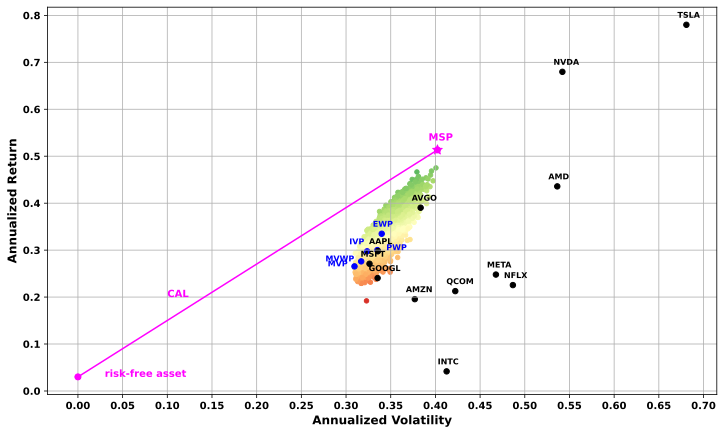

In [173]:
plt.figure(figsize = (12, 7))  
    
# plot the randomly–weighted portfolios 
plt.scatter(x = rand_portfs_summary[("Annual", "Volatility")], y = rand_portfs_summary[("Annual", "Return")], 
            c = rand_portfs_summary[("Annual", "Sharpe")], cmap = "RdYlGn", vmin = 0.5, vmax = 1.4, s = 20)

# plot the minimum variance portfolio 
plt.scatter(x = summary_portfs.loc["MVP" , ("Annual", "Volatility")], y = summary_portfs.loc["MVP" , ("Annual", "Return")], s = 30, c = "blue") 

plt.annotate("MVP", size = 8, c = "blue", 
             xy = (summary_portfs.loc["MVP" , ("Annual", "Volatility")] - 0.03, summary_portfs.loc["MVP" , ("Annual", "Return")]))

# plot the maximum sharpe portfolio 
plt.scatter(x = summary_portfs.loc["MSP" , ("Annual", "Volatility")], y = summary_portfs.loc["MSP" , ("Annual", "Return")],  
            c = "fuchsia", s = 100, marker = "*")

plt.annotate("MSP", size = 10, c = "fuchsia", 
             xy = (summary_portfs.loc["MSP" , ("Annual", "Volatility")] - 0.01, summary_portfs.loc["MSP" , ("Annual", "Return")] + 0.02))

# plot the price–weighted portfolio
plt.scatter(x = summary_portfs.loc["PWP" , ("Annual", "Volatility")], y = summary_portfs.loc["PWP" , ("Annual", "Return")], s = 30, c = "blue")

plt.annotate("PWP", size = 8, c = "blue", 
             xy = (summary_portfs.loc["PWP" , ("Annual", "Volatility")] + 0.01, summary_portfs.loc["PWP" , ("Annual", "Return")]))

# plot the equally–weighted portfolio
plt.scatter(x = summary_portfs.loc["EWP" , ("Annual", "Volatility")], y = summary_portfs.loc["EWP" , ("Annual", "Return")], s = 30, c = "blue")

plt.annotate("EWP", size = 8, c = "blue", 
             xy = (summary_portfs.loc["EWP" , ("Annual", "Volatility")] - 0.01, summary_portfs.loc["EWP" , ("Annual", "Return")] + 0.015))

# plot the market–value–weighted portfolio 
plt.scatter(x = summary_portfs.loc["MVWP" , ("Annual", "Volatility")], y = summary_portfs.loc["MVWP" , ("Annual", "Return")], c = "blue" , s = 30)

plt.annotate("MVWP", size = 8, c = "blue", 
             xy = (summary_portfs.loc["MVWP", ("Annual", "Volatility")] - 0.04, summary_portfs.loc["MVWP" , ("Annual", "Return")]))  

# plot the inverse volatility portfolio 
plt.scatter(x = summary_portfs.loc["IVP" , ("Annual", "Volatility")], y = summary_portfs.loc["IVP" , ("Annual", "Return")], c = "blue" , s = 30)

plt.annotate("IVP", size = 8, c = "blue", 
             xy = (summary_portfs.loc["IVP", ("Annual", "Volatility")] - 0.02, summary_portfs.loc["IVP" , ("Annual", "Return")] + 0.015))  

# plot the individual stocks in the portfolio 
plt.scatter(x = summary_stocks[("Annual", "Volatility")], y = summary_stocks[("Annual", "Return")], s = 30, c = "black")

for ticker in tickers : 
    plt.annotate(ticker, xy = (summary_stocks.loc[ticker , ("Annual", "Volatility")] - 0.01, summary_stocks.loc[ticker , ("Annual", "Return")] + 0.015), size = 8)  

# plot the risk free asset and the capital market line 
plt.scatter(x = pd.Series(data = 0).values, y = rf_rate, s = 30, c = "fuchsia")
plt.annotate("risk-free asset", size = 10, c = "fuchsia", xy = (rf_rate, rf_rate))

plt.plot([0, summary_portfs.loc["MSP" , ("Annual", "Volatility")]], [rf_rate, summary_portfs.loc["MSP" , ("Annual", "Return")]], c = "fuchsia", marker = "o", linestyle = "-")
plt.annotate("CAL", size = 10, c = "fuchsia", xy = (0.1, 0.2))

plt.xticks(ticks = np.array(range(0, 71, 5)) / 100)
plt.xlabel(xlabel = "Annualized Volatility", fontsize = 12)
plt.ylabel(ylabel = "Annualized Return", fontsize = 12) 
plt.grid( )
plt.show( )   

### 3.2 Impact and Magnitude of Diversification 
<a id="subsection-32"></a>

$$
\text{Diversification Ratio}_{t} = \frac{\sigma_{portfolio,t}}{\sum_{i=1}^{N} \sigma_{i,t} \times \text{Weight}_{i,t}} - 1
$$

In [174]:
def plot_portf_diversification(returns_tickers, weights_portf, returns_portf) :
    """
    Arguments :
    - returns_tickers : DataFrame of daily returns for assets in the portfolio 
    - weights_portf : DataFrame of monthly weights for assets in the portfolio
    - returns_portf : DataFrame of daily returns for the portfolio 
    
    Returns :
    - None 
        
    Function :
    - Draws a line plot of the monthly weighted sum of assets' volatilities 
    - Draws a line plot of the monthly volatility of the portfolio
    - Draws a line plot of the % difference between portfolio's volatility and assets' volatilities 
    - Draws a line plot of the sum of squared monthly weights 
    """
    monthly_std_tickers = returns_tickers.resample("BM").std( )
    monthly_weights = weights_portf.resample("BM").last( )
    weighted_sum_std = monthly_std_tickers.mul(monthly_weights).sum(axis = 1)
    
    portf = returns_portf.name 
    monthly_std_portf = returns_portf.resample("BM").std( )
    
    diversif_ratio = - (monthly_std_portf.sub(weighted_sum_std)).div(weighted_sum_std)
    
    fig , ax = plt.subplots(figsize = (11.5 , 8), sharex = False, sharey = False, nrows = 1, ncols = 1)
    
    ax.plot(weighted_sum_std.mul(100), label = "Weighted Sum of Assets's Volatilities", c = "red")
    ax.plot(monthly_std_portf.mul(100), label = f"{portf} Volatility", c = "orange")
    ax.set_ylabel("Monthly Volatility (%)", fontsize = 11)
    ax.legend( )
    
    ax2 = ax.twinx( )
    ax2.plot(diversif_ratio.mul(100), linestyle = "dotted", marker = "o", color = "tab:blue", label = "Diversification Ratio")
    ax2.set_ylabel("Monthly Diversification (%)", fontsize = 11)
    
    plt.show( )

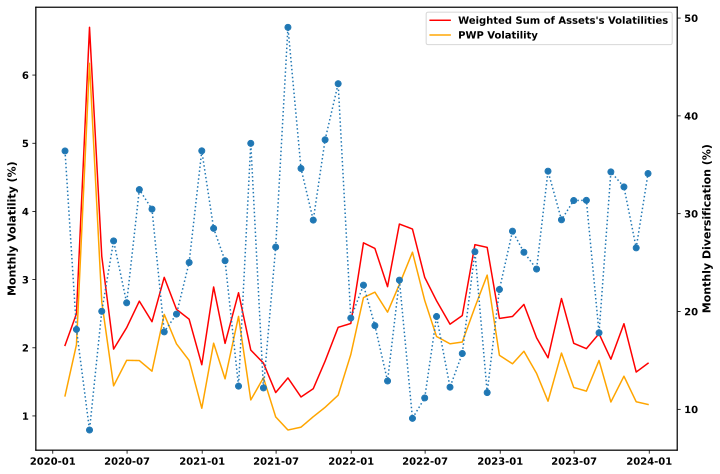

In [175]:
plot_portf_diversification(returns[tickers], weights_PWP, returns["PWP"])

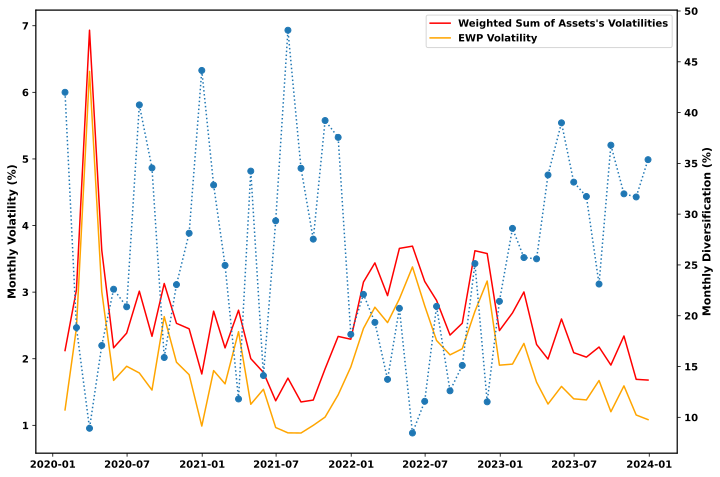

In [176]:
plot_portf_diversification(returns[tickers], weights_EWP, returns["EWP"])

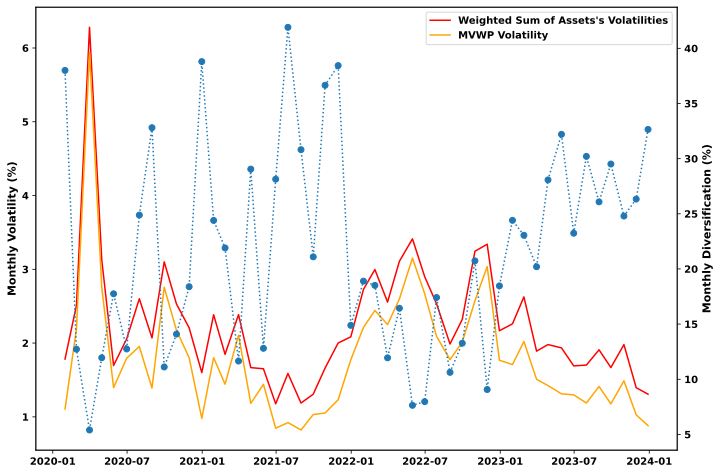

In [177]:
plot_portf_diversification(returns[tickers], weights_MVWP, returns["MVWP"])

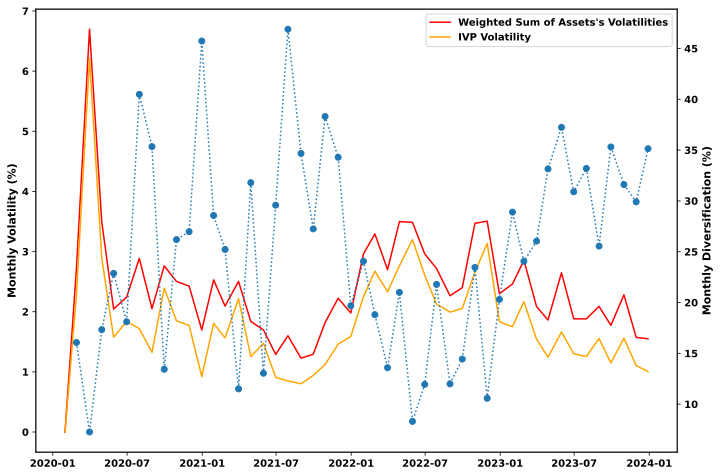

In [178]:
plot_portf_diversification(returns[tickers], weights_IVP, returns["IVP"])

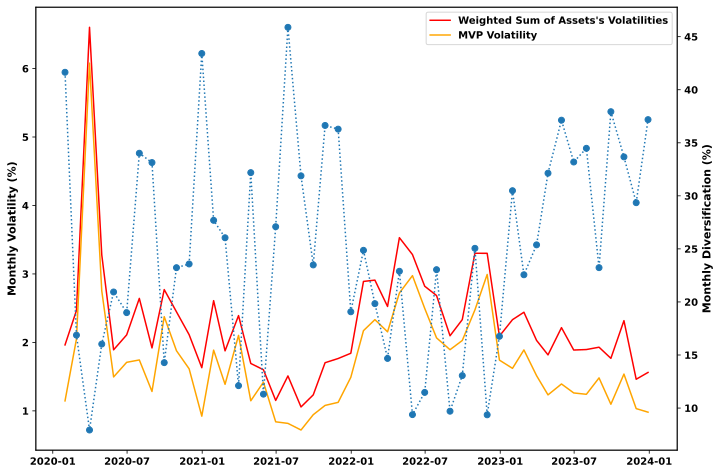

In [179]:
plot_portf_diversification(returns[tickers], weights_MVP, returns["MVP"])

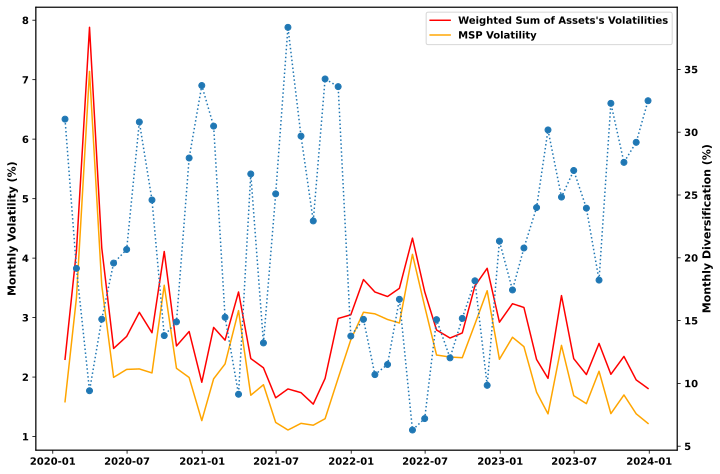

In [180]:
plot_portf_diversification(returns[tickers], weights_MSP, returns["MSP"])